In [2]:
import matplotlib.pyplot as plt
import matplotlib as mpl
import pandas as pd
import numpy as np
import seaborn as sns
import os

import cv2

from glob import glob
from matplotlib.patches import  Polygon
from matplotlib.collections import PatchCollection
from scipy.stats import linregress, f_oneway
from scipy.spatial.distance import cdist
from scipy.linalg import polar


import sys
sys.path.insert(0, "..")

from utils import geometry

In [3]:
inst_dir='C:\\Users\\v35431nc\\Documents\\Lab_Stuff\\Movies_to_track\\Output\\Instant_data/'
inc_dir='C:\\Users\\v35431nc\\Documents\\Lab_Stuff\\Movies_to_track\\Output\\Incremental_data/'
uns_dir='C:\\Users\\v35431nc\\Documents\\Lab_Stuff\\Movies_to_track\\Output\\Unstretched_data/'
cont_dir='C:\\Users\\v35431nc\\Documents\\Lab_Stuff\\Movies_to_track\\Output\\Continuous_data/'
save_dir='C:\\Users\\v35431nc\\Documents\\Lab_Stuff\\Movies_to_track\\Output\\comparison_plots/'

save_folder='C:\\Users\\v35431nc\\Documents\\Lab_Stuff\\Movies_to_track\\Output/'

In [4]:

#make sure the data frame is still sorted by cell_id_old.
def get_order(df, shells):
    cell_order_1=[]
    cell_order_2=[]
    cell_order_all=[]

    mean_c_dist_1=[]
    mean_c_dist_2=[]
    for i in range(len(shells)):

        shell_matrix=np.loadtxt(shells[i])

        shape_cos_sq=np.cos(np.subtract.outer(df[df.tm_frame==i].major_shape_axis_alignment_rads.values,df[df.tm_frame==i].major_shape_axis_alignment_rads.values))**2
        
        ccs=df[df.tm_frame==i][['cc_x', 'cc_y']].values
        r=cdist(ccs, ccs)


        order_1=[np.mean(shape_cos_sq[x,np.where((shell_matrix[x]==1))]) for x in range(len(shell_matrix))]
        order_2=[np.mean(shape_cos_sq[x,np.where((shell_matrix[x]==1)|(shell_matrix[x]==2))]) for x in range(len(shell_matrix))]
        order_all=[np.mean(shape_cos_sq[x,:]) for x in range(len(shell_matrix))]

        c_dist_1=[np.mean(r[x,np.where((shell_matrix[x]==1))]) for x in range(len(shell_matrix))]
        c_dist_2=[np.mean(r[x,np.where((shell_matrix[x]==1)|(shell_matrix[x]==2))]) for x in range(len(shell_matrix))]

        cell_order_1.append(order_1)
        cell_order_2.append(order_2)
        cell_order_all.append(order_all)
        mean_c_dist_1.append(c_dist_1)
        mean_c_dist_2.append(c_dist_2)

    nn_order=pd.DataFrame(cell_order_1).rename_axis('tm_frame').reset_index().melt(id_vars='tm_frame')
    nn_order=nn_order.rename(columns={'variable':'cell_id_old', 'value':'nn_order'})
    df=df.merge(nn_order, on=['tm_frame', 'cell_id_old'])
    nn_order_2=pd.DataFrame(cell_order_2).rename_axis('tm_frame').reset_index().melt(id_vars='tm_frame')
    nn_order_2=nn_order_2.rename(columns={'variable':'cell_id_old', 'value':'nn_order_2'})
    df=df.merge(nn_order_2, on=['tm_frame', 'cell_id_old'])
    order_all=pd.DataFrame(cell_order_all).rename_axis('tm_frame').reset_index().melt(id_vars='tm_frame')
    order_all=order_all.rename(columns={'variable':'cell_id_old', 'value':'order_all'})
    df=df.merge(order_all, on=['tm_frame', 'cell_id_old'])

    dist_1=pd.DataFrame(mean_c_dist_1).rename_axis('tm_frame').reset_index().melt(id_vars='tm_frame')
    dist_1=dist_1.rename(columns={'variable':'cell_id_old', 'value':'mean_cc_distance'})
    df=df.merge(dist_1, on=['tm_frame', 'cell_id_old'])
    dist_2=pd.DataFrame(mean_c_dist_2).rename_axis('tm_frame').reset_index().melt(id_vars='tm_frame')
    dist_2=dist_2.rename(columns={'variable':'cell_id_old', 'value':'mean_cc_distance_2'})
    df=df.merge(dist_2, on=['tm_frame', 'cell_id_old'])

    return df



In [5]:
dat_20151007_1_GSV=pd.read_csv(inst_dir+'20151007_1_GSV_GFPtub-CheHis_uf_8p6_MP_pooled_mech.csv')
dat_20231121_1_IN=pd.read_csv(inst_dir+'20231121_1_IN_GFPCAAX-CheHis_uf_8p6_SP_pooled_mech_circ.csv')
dat_20231128_1_IP=pd.read_csv(inst_dir+'20231128_1_IP_GFPCAAX-CheHis_uf_8p6_SP_pooled_mech_circ.csv')
dat_20240510_1_IN=pd.read_csv(inst_dir+'20240510_1_IN_GFPCAAX-CheHis_uf_8p6_SP_pooled_mech_circ.csv')
dat_20240503_1_IP=pd.read_csv(inst_dir+'20240503_1_IP_GFPCAAX-CheHis_uf_8p6_SP_pooled_mech_circ.csv')




inc_20231005_1_IP=pd.read_csv(inc_dir+'20231005_1_IP_GFPCAAX-CheHis_us_8p6_SP_pooled_mech_circ.csv')
inc_20240117_1_IP=pd.read_csv(inc_dir+'20240117_1_IP_GFPCAAX-CheHis_us_8p6_SP_pooled_mech_circ.csv')
inc_20240320_2_IN=pd.read_csv(inc_dir+'20240320_2_IN_GFPCAAX-CheHis_us_8p6_SP_pooled_mech_circ.csv')



uns_20151125_1_GSV=pd.read_csv(uns_dir+'20151125_1_GSV_GFPtub-CheHis_uu_0p5_MP_pooled_mech.csv')
uns_20240117_2_IP=pd.read_csv(uns_dir+'20240117_2_IP_GFPCAAX-CheHis_uu_0p5_SP_pooled_mech_circ.csv')
uns_20231012_2_IP=pd.read_csv(uns_dir+'20231012_2_IP_GFPCAAX-CheHis_uu_0p5_SP_pooled_mech_circ.csv')
uns_20231019_1_IP=pd.read_csv(uns_dir+'20231019_1_IP_GFPCAAX-CheHis_uu_0p5_SP_pooled_mech_circ.csv')

con_20240412_2_IP=pd.read_csv(cont_dir+'20240412_2_IP_GFPCAAX-CheHis_uc_8p6_SP_pooled_mech_circ.csv')
con_20240503_2_IP=pd.read_csv(cont_dir+'20240503_2_IP_GFPCAAX-CheHis_uc_8p6_SP_pooled_mech_circ.csv')





shells=sorted(glob(uns_dir+'20231019_1_IP_GFPCAAX-CheHis_uu_0p5*/*/*/Matrices/*shells*.txt'))
uns_20231019_1_IP=get_order(uns_20231019_1_IP, shells)
shells=sorted(glob(uns_dir+'20231012_2_IP_GFPCAAX-CheHis_uu_0p5*/*/*/Matrices/*shells*.txt'))
uns_20231012_2_IP=get_order(uns_20231012_2_IP, shells)
shells=sorted(glob(uns_dir+'20240117_2_IP_GFPCAAX-CheHis_uu_0p5*/*/*/Matrices/*shells*.txt'))
uns_20240117_2_IP=get_order(uns_20240117_2_IP, shells)
# shells=sorted(glob(uns_dir+'20151125_1_GSV_GFPCAAX-CheHis_uu_0p5*/*/*/Matrices/*shells*.txt'))
# uns_20151125_1_GSV=get_order(uns_20151125_1_GSV, shells)


shells=sorted(glob(inc_dir+'20231005_1_IP_GFPCAAX-CheHis_us_*/*/*/Matrices/*shells*.txt'))
inc_20231005_1_IP=get_order(inc_20231005_1_IP, shells)
shells=sorted(glob(inc_dir+'20240117_1_IP_GFPCAAX-CheHis_us_*/*/*/Matrices/*shells*.txt'))
inc_20240117_1_IP=get_order(inc_20240117_1_IP, shells)
shells=sorted(glob(inc_dir+'20240320_2_IN_GFPCAAX-CheHis_us_*/*/*/Matrices/*shells*.txt'))
inc_20240320_2_IN=get_order(inc_20240320_2_IN, shells)

# shells=sorted(glob(inst_dir+'20151007_1_GSV_GFPCAAX-CheHis_uf*/*/*/Matrices/*shells*.txt'))
# dat_20151007_1_GSV=get_order(dat_20151007_1_GSV, shells)
shells=sorted(glob(inst_dir+'20231121_1_IN_GFPCAAX-CheHis_uf_*/*/*/Matrices/*shells*.txt'))
dat_20231121_1_IN=get_order(dat_20231121_1_IN, shells)
shells=sorted(glob(inst_dir+'20231128_1_IP_GFPCAAX-CheHis_uf_*/*/*/Matrices/*shells*.txt'))
dat_20231128_1_IP=get_order(dat_20231128_1_IP, shells)
shells=sorted(glob(inst_dir+'20240510_1_IN_GFPCAAX-CheHis_uf_*/*/*/Matrices/*shells*.txt'))
dat_20240510_1_IN=get_order(dat_20240510_1_IN, shells)
shells=sorted(glob(inst_dir+'20240503_1_IP_GFPCAAX-CheHis_uf_*/*/*/Matrices/*shells*.txt'))
dat_20240503_1_IP=get_order(dat_20240503_1_IP, shells)

shells=sorted(glob(cont_dir+'20240412_2_IP_GFPCAAX-CheHis_uc_*/*/*/Matrices/*shells*.txt'))
con_20240412_2_IP=get_order(con_20240412_2_IP, shells)
shells=sorted(glob(cont_dir+'20240503_2_IP_GFPCAAX-CheHis_uc_*/*/*/Matrices/*shells*.txt'))
con_20240503_2_IP=get_order(con_20240503_2_IP, shells)



In [39]:
def get_conditions(df):
    conditions = [
    (df.cell_id_new.isin(np.unique(df.parent_id)[:-1])),
    (~df.cell_id_new.isin(np.unique(df.parent_id)[:-1]))&(df.divisions==0),
    (df.divisions>0)
    ]

    return conditions

def new_columns(df,name, stretch_type):

    values = ['will divide', 'never divides', 'daughter cell']

    df.sort_values(['time', 'cell_id_new']).reset_index(drop=True)
    df['experiment']=name
    df['stretch_type']=stretch_type
    df['state'] = np.select(get_conditions(df), values)
    df['area_norm']=df.cell_area_microns/(df.groupby('cell_id_new').cell_area_microns.transform('first'))
    df['perimeter_norm']=df.cell_perimeter_microns/(df.groupby('cell_id_new').cell_perimeter_microns.transform('first'))

    df['first_frame']=df.groupby('cell_id_new').tm_frame.transform('first')
    df['last_frame']=df.groupby('cell_id_new').tm_frame.transform('last')


    return df


uns_20151125_1_GSV=new_columns(uns_20151125_1_GSV, 'uns_20151125_1_GSV', 'u')
uns_20240117_2_IP=new_columns(uns_20240117_2_IP, 'uns_20240117_2_IP', 'u')
uns_20231012_2_IP=new_columns(uns_20231012_2_IP, 'uns_20231012_2_IP', 'u')
uns_20231019_1_IP=new_columns(uns_20231019_1_IP, 'uns_20231019_1_IP', 'u')

all_uns=pd.concat([uns_20231012_2_IP, uns_20231019_1_IP, uns_20240117_2_IP])


inc_20231005_1_IP=new_columns(inc_20231005_1_IP, 'inc_20231005_1_IP', 's')
inc_20240117_1_IP=new_columns(inc_20240117_1_IP, 'inc_20240117_1_IP', 's')
inc_20240320_2_IN=new_columns(inc_20240320_2_IN, 'inc_20240320_2_IN', 's')

all_inc=pd.concat([inc_20231005_1_IP,inc_20240117_1_IP,inc_20240320_2_IN])

dat_20151007_1_GSV=new_columns(dat_20151007_1_GSV, 'ins_20151007_1_GSV', 'f')
dat_20231121_1_IN=new_columns(dat_20231121_1_IN, 'ins_20231121_1_IN', 'f')
dat_20231128_1_IP=new_columns(dat_20231128_1_IP, 'ins_20231128_1_IP','f')
dat_20240510_1_IN=new_columns(dat_20240510_1_IN, 'ins_20240510_1_IN','f')
dat_20240503_1_IP=new_columns(dat_20240503_1_IP, 'ins_20240503_1_IP','f')



#all_ins=pd.concat([dat_20231121_1_IN,dat_20231128_1_IP,dat_20240510_1_IN,dat_20240503_1_IP])
all_ins=pd.concat([dat_20231128_1_IP,dat_20240510_1_IN,dat_20240503_1_IP])


con_20240412_2_IP=new_columns(con_20240412_2_IP, 'con_20240412_2_IP', 'c')
con_20240503_2_IP=new_columns(con_20240503_2_IP, 'con_20240503_2_IP', 'c')

all_con=pd.concat([con_20240412_2_IP,con_20240503_2_IP])



all_cells=pd.concat([all_ins, all_inc, all_uns, all_con])
all_cells=all_cells.reset_index()

In [40]:
all_cells['area_norm_mean']=all_cells.cell_area_microns/all_cells.groupby(['experiment', 'time']).cell_area_microns.transform('mean')
all_cells['area_norm_last']=all_cells.cell_area_microns/all_cells.groupby(['experiment', 'cell_id_new']).cell_area_microns.transform('last')

all_cells['circ_norm']=all_cells.circularity/all_cells.groupby(['experiment', 'cell_id_new']).circularity.transform('first')
all_cells['circ_norm_last']=all_cells.circularity/all_cells.groupby(['experiment', 'cell_id_new']).circularity.transform('last')


all_cells['aligned_time']=all_cells.time
all_cells.loc[all_cells.state=='daughter cell', 'aligned_time']=all_cells[all_cells.state=='daughter cell'].time-all_cells[all_cells.state=='daughter cell'].groupby(['experiment','cell_id_new'])['time'].transform('first')

all_cells['aligned_time_back']=all_cells.time
all_cells.loc[all_cells.state=='will divide', 'aligned_time_back']=all_cells[all_cells.state=='will divide'].time+(170-all_cells[all_cells.state=='will divide'].groupby(['experiment','cell_id_new'])['time'].transform('last'))


In [486]:
# all_cells['area_norm_fs']=all_cells.area_norm
# all_cells.loc[all_cells.stretch_type=='f', 'area_norm_fs']=all_cells[all_cells.stretch_type=='f']/all_cells[(all_cells.stretch_type=='f')].groupby(['experiment', 'cell_id_new']).cell_area_microns
# all_cells.loc[all_cells.stretch_type=='c', 'area_norm_fs']=all_cells[all_cells.stretch_type=='c'].cell_area_microns/all_cells[(all_cells.stretch_type=='c')&(all_cells.time==80)].cell_area_microns
# all_cells.loc[all_cells.stretch_type=='s', 'area_norm_fs']=all_cells[all_cells.stretch_type=='s'].cell_area_microns/all_cells[(all_cells.stretch_type=='s')&(all_cells.time==80)].cell_area_microns

# all_cells[area_norm_fs]


ValueError: Unable to coerce to Series, length must be 48: given 1726

In [460]:
all_cells.to_csv(save_folder+"/all_tracked_cell_data_pooled.csv",index=False)

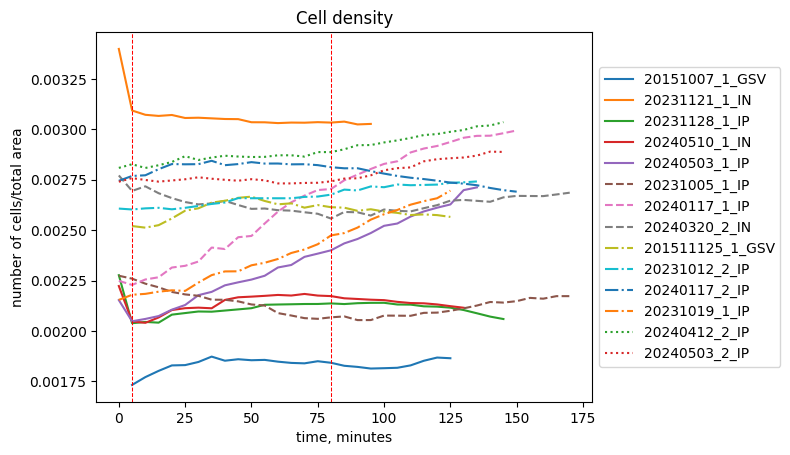

In [142]:
tshift=np.linspace(5,125, 25)
plt.plot(tshift,dat_20151007_1_GSV.groupby('time').count().cell_id_new/(dat_20151007_1_GSV.groupby('time').cell_area_microns.sum()), label='20151007_1_GSV')

plt.plot(dat_20231121_1_IN.groupby('time').count().cell_id_new/(dat_20231121_1_IN.groupby('time').cell_area_microns.sum()), label='20231121_1_IN')
plt.plot(dat_20231128_1_IP.groupby('time').count().cell_id_new/(dat_20231128_1_IP.groupby('time').cell_area_microns.sum()), label='20231128_1_IP')
plt.plot(dat_20240510_1_IN.groupby('time').count().cell_id_new/(dat_20240510_1_IN.groupby('time').cell_area_microns.sum()), label='20240510_1_IN')
plt.plot(dat_20240503_1_IP.groupby('time').count().cell_id_new/(dat_20240503_1_IP.groupby('time').cell_area_microns.sum()), label='20240503_1_IP')


plt.plot(inc_20231005_1_IP.groupby('time').count().cell_id_new/(inc_20231005_1_IP.groupby('time').cell_area_microns.sum()), label='20231005_1_IP', linestyle='--')
plt.plot(inc_20240117_1_IP.groupby('time').count().cell_id_new/(inc_20240117_1_IP.groupby('time').cell_area_microns.sum()), label='20240117_1_IP', linestyle='--')
plt.plot(inc_20240320_2_IN.groupby('time').count().cell_id_new/(inc_20240320_2_IN.groupby('time').cell_area_microns.sum()), label='20240320_2_IN', linestyle='--')

plt.plot(tshift,uns_20151125_1_GSV.groupby('time').count().cell_id_new/(uns_20151125_1_GSV.groupby('time').cell_area_microns.sum()), label='201511125_1_GSV', linestyle='-.')
plt.plot(uns_20231012_2_IP.groupby('time').count().cell_id_new/(uns_20231012_2_IP.groupby('time').cell_area_microns.sum()), label='20231012_2_IP', linestyle='-.')
plt.plot(uns_20240117_2_IP.groupby('time').count().cell_id_new/(uns_20240117_2_IP.groupby('time').cell_area_microns.sum()), label='20240117_2_IP', linestyle='-.')
plt.plot(uns_20231019_1_IP.groupby('time').count().cell_id_new/(uns_20231019_1_IP.groupby('time').cell_area_microns.sum()), label='20231019_1_IP', linestyle='-.')

plt.plot(con_20240412_2_IP.groupby('time').count().cell_id_new/(con_20240412_2_IP.groupby('time').cell_area_microns.sum()), label='20240412_2_IP', linestyle=':')
plt.plot(con_20240503_2_IP.groupby('time').count().cell_id_new/(con_20240503_2_IP.groupby('time').cell_area_microns.sum()), label='20240503_2_IP', linestyle=':')



plt.axvline(5, c='r', linestyle='--', linewidth=0.75)
plt.axvline(80, c='r', linestyle='--', linewidth=0.75)


plt.xlabel('time, minutes')
plt.ylabel('number of cells/total area')
plt.title("Cell density")
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))


plt.savefig(save_dir+'/compare_cell_density_time.png', dpi=300, bbox_inches='tight')

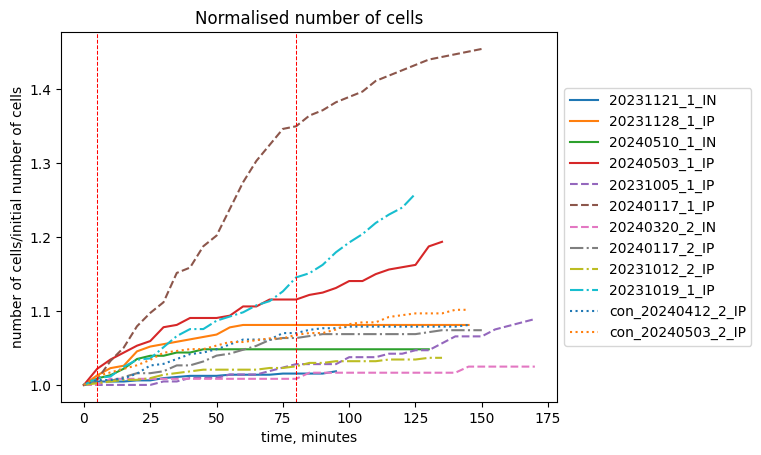

In [143]:
tshift=np.linspace(5,125, 25)
plt.plot(dat_20231121_1_IN.groupby('time').count().cell_id_new/(dat_20231121_1_IN[dat_20231121_1_IN.time==0].count().cell_id_new), label='20231121_1_IN')
plt.plot(dat_20231128_1_IP.groupby('time').count().cell_id_new/(dat_20231128_1_IP[dat_20231128_1_IP.time==0].count().cell_id_new), label='20231128_1_IP')
plt.plot(dat_20240510_1_IN.groupby('time').count().cell_id_new/(dat_20240510_1_IN[dat_20240510_1_IN.time==0].count().cell_id_new), label='20240510_1_IN')
plt.plot(dat_20240503_1_IP.groupby('time').count().cell_id_new/(dat_20240503_1_IP[dat_20240503_1_IP.time==0].count().cell_id_new), label='20240503_1_IP')


plt.plot(inc_20231005_1_IP.groupby('time').count().cell_id_new/(inc_20231005_1_IP[inc_20231005_1_IP.time==0].count().cell_id_new), label='20231005_1_IP', linestyle='--')
plt.plot(inc_20240117_1_IP.groupby('time').count().cell_id_new/(inc_20240117_1_IP[inc_20240117_1_IP.time==0].count().cell_id_new), label='20240117_1_IP', linestyle='--')
plt.plot(inc_20240320_2_IN.groupby('time').count().cell_id_new/(inc_20240320_2_IN[inc_20240320_2_IN.time==0].count().cell_id_new), label='20240320_2_IN', linestyle='--')

plt.plot(uns_20240117_2_IP.groupby('time').count().cell_id_new/(uns_20240117_2_IP[uns_20240117_2_IP.time==0].count().cell_id_new), label='20240117_2_IP', linestyle='-.')
plt.plot(uns_20231012_2_IP.groupby('time').count().cell_id_new/(uns_20231012_2_IP[uns_20231012_2_IP.time==0].count().cell_id_new), label='20231012_2_IP', linestyle='-.')
plt.plot(uns_20231019_1_IP.groupby('time').count().cell_id_new/(uns_20231019_1_IP[uns_20231019_1_IP.time==0].count().cell_id_new), label='20231019_1_IP', linestyle='-.')

plt.plot(con_20240412_2_IP.groupby('time').count().cell_id_new/(con_20240412_2_IP[con_20240412_2_IP.time==0].count().cell_id_new), label='con_20240412_2_IP', linestyle=':')
plt.plot(con_20240503_2_IP.groupby('time').count().cell_id_new/(con_20240503_2_IP[con_20240503_2_IP.time==0].count().cell_id_new), label='con_20240503_2_IP', linestyle=':')




plt.axvline(5, c='r', linestyle='--', linewidth=0.75)
plt.axvline(80, c='r', linestyle='--', linewidth=0.75)


plt.xlabel('time, minutes')
plt.ylabel('number of cells/initial number of cells')
plt.title("Normalised number of cells")
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))

plt.savefig(save_dir+'/compare_norm_number_cells_time.png', dpi=300, bbox_inches='tight')

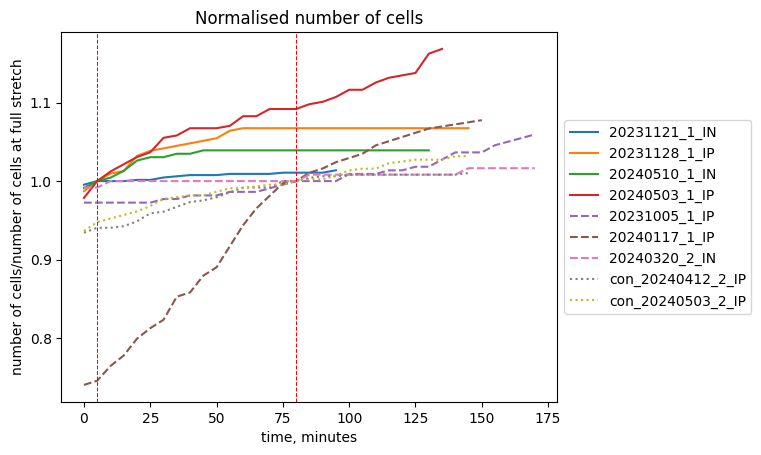

In [484]:
tshift=np.linspace(5,125, 25)
plt.plot(dat_20231121_1_IN.groupby('time').count().cell_id_new/(dat_20231121_1_IN[dat_20231121_1_IN.time==5].count().cell_id_new), label='20231121_1_IN')
plt.plot(dat_20231128_1_IP.groupby('time').count().cell_id_new/(dat_20231128_1_IP[dat_20231128_1_IP.time==5].count().cell_id_new), label='20231128_1_IP')
plt.plot(dat_20240510_1_IN.groupby('time').count().cell_id_new/(dat_20240510_1_IN[dat_20240510_1_IN.time==5].count().cell_id_new), label='20240510_1_IN')
plt.plot(dat_20240503_1_IP.groupby('time').count().cell_id_new/(dat_20240503_1_IP[dat_20240503_1_IP.time==5].count().cell_id_new), label='20240503_1_IP')


plt.plot(inc_20231005_1_IP.groupby('time').count().cell_id_new/(inc_20231005_1_IP[inc_20231005_1_IP.time==80].count().cell_id_new), label='20231005_1_IP', linestyle='--')
plt.plot(inc_20240117_1_IP.groupby('time').count().cell_id_new/(inc_20240117_1_IP[inc_20240117_1_IP.time==80].count().cell_id_new), label='20240117_1_IP', linestyle='--')
plt.plot(inc_20240320_2_IN.groupby('time').count().cell_id_new/(inc_20240320_2_IN[inc_20240320_2_IN.time==80].count().cell_id_new), label='20240320_2_IN', linestyle='--')

#plt.plot(uns_20240117_2_IP.groupby('time').count().cell_id_new/(uns_20240117_2_IP[uns_20240117_2_IP.time==0].count().cell_id_new), label='20240117_2_IP', linestyle='-.')
#plt.plot(uns_20231012_2_IP.groupby('time').count().cell_id_new/(uns_20231012_2_IP[uns_20231012_2_IP.time==0].count().cell_id_new), label='20231012_2_IP', linestyle='-.')
#plt.plot(uns_20231019_1_IP.groupby('time').count().cell_id_new/(uns_20231019_1_IP[uns_20231019_1_IP.time==0].count().cell_id_new), label='20231019_1_IP', linestyle='-.')

plt.plot(con_20240412_2_IP.groupby('time').count().cell_id_new/(con_20240412_2_IP[con_20240412_2_IP.time==80].count().cell_id_new), label='con_20240412_2_IP', linestyle=':')
plt.plot(con_20240503_2_IP.groupby('time').count().cell_id_new/(con_20240503_2_IP[con_20240503_2_IP.time==80].count().cell_id_new), label='con_20240503_2_IP', linestyle=':')




plt.axvline(5, c='r', linestyle='--', linewidth=0.75)
plt.axvline(80, c='r', linestyle='--', linewidth=0.75)


plt.xlabel('time, minutes')
plt.ylabel('number of cells/number of cells at full stretch')
plt.title("Normalised number of cells")
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))

#plt.savefig(save_dir+'/compare_norm_number_cells_time.png', dpi=300, bbox_inches='tight')

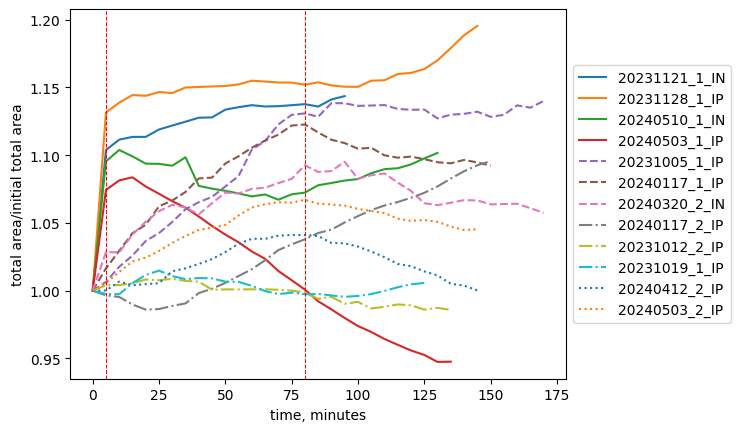

In [144]:
t2=np.linspace(0, 95, 20)
t3=np.linspace(0, 145, 30)
t4=np.linspace(0, 170, 35)
t5=np.linspace(0, 150, 31)
t6=np.linspace(0, 135, 28)
t7=np.linspace(0, 125, 26)
t8=np.linspace(0, 130, 27)




plt.plot(t2,dat_20231121_1_IN.groupby('time').cell_area_microns.sum()/(dat_20231121_1_IN[dat_20231121_1_IN.time==0].sum().cell_area_microns),label='20231121_1_IN')
plt.plot(t3,dat_20231128_1_IP.groupby('time').cell_area_microns.sum()/(dat_20231128_1_IP[dat_20231128_1_IP.time==0].sum().cell_area_microns),label='20231128_1_IP')
plt.plot(t8,dat_20240510_1_IN.groupby('time').cell_area_microns.sum()/(dat_20240510_1_IN[dat_20240510_1_IN.time==0].sum().cell_area_microns),label='20240510_1_IN')
plt.plot(t6,dat_20240503_1_IP.groupby('time').cell_area_microns.sum()/(dat_20240503_1_IP[dat_20240503_1_IP.time==0].sum().cell_area_microns),label='20240503_1_IP')


plt.plot(t4,inc_20231005_1_IP.groupby('time').cell_area_microns.sum()/(inc_20231005_1_IP[inc_20231005_1_IP.time==0].sum().cell_area_microns),label='20231005_1_IP', linestyle='--')
plt.plot(t5,inc_20240117_1_IP.groupby('time').cell_area_microns.sum()/(inc_20240117_1_IP[inc_20240117_1_IP.time==0].sum().cell_area_microns),label='20240117_1_IP', linestyle='--')
plt.plot(t4,inc_20240320_2_IN.groupby('time').cell_area_microns.sum()/(inc_20240320_2_IN[inc_20240320_2_IN.time==0].sum().cell_area_microns),label='20240320_2_IN', linestyle='--')



plt.plot(t5,uns_20240117_2_IP.groupby('time').cell_area_microns.sum()/(uns_20240117_2_IP[uns_20240117_2_IP.time==0].sum().cell_area_microns),label='20240117_2_IP', linestyle='-.')
plt.plot(t6,uns_20231012_2_IP.groupby('time').cell_area_microns.sum()/(uns_20231012_2_IP[uns_20231012_2_IP.time==0].sum().cell_area_microns),label='20231012_2_IP', linestyle='-.')
plt.plot(t7,uns_20231019_1_IP.groupby('time').cell_area_microns.sum()/(uns_20231019_1_IP[uns_20231019_1_IP.time==0].sum().cell_area_microns),label='20231019_1_IP', linestyle='-.')

plt.plot(t3,con_20240412_2_IP.groupby('time').cell_area_microns.sum()/(con_20240412_2_IP[con_20240412_2_IP.time==0].sum().cell_area_microns),label='20240412_2_IP', linestyle=':')
plt.plot(t3,con_20240503_2_IP.groupby('time').cell_area_microns.sum()/(con_20240503_2_IP[con_20240503_2_IP.time==0].sum().cell_area_microns),label='20240503_2_IP', linestyle=':')


#plt.plot(tshift,dat_20151007_1_GSV.groupby('time').cell_area_microns.sum()/(dat_20151007_1_GSV[dat_20151007_1_GSV.time==0].sum().cell_area_microns),label='20151007_1_GSV, instant')

#plt.plot(tshift,uns_20151125_1_GSV.groupby('time').cell_area_microns.sum()/(uns_20151125_1_GSV[uns_20151125_1_GSV.time==0].sum().cell_area_microns),label='20151125_1_GSV, unstretched')


plt.axvline(5, linestyle='--', color='red', linewidth=0.75)
plt.axvline(80, linestyle='--', color='red', linewidth=0.75)

plt.xlabel("time, minutes")
plt.ylabel("total area/initial total area")
#plt.title("Fold change in total area of cells from full stretch")
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.savefig(save_dir+'/total_area_norm_initial_stretch.png', dpi=300, bbox_inches='tight')

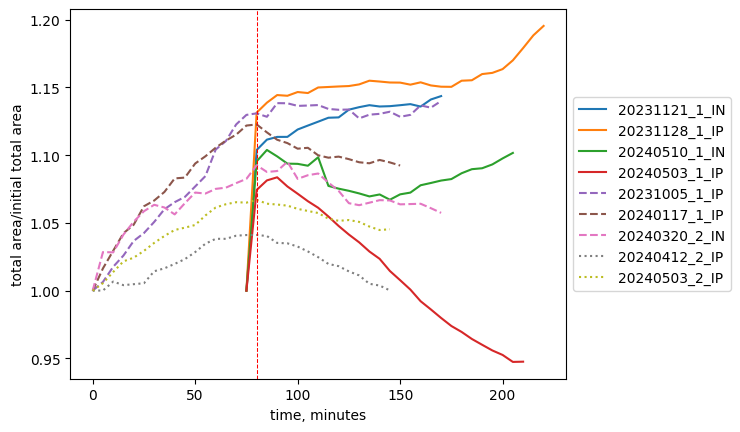

In [146]:
t2=np.linspace(0+75, 95+75, 20)
t3=np.linspace(0+75, 145+75, 30)
t4=np.linspace(0, 170, 35)
t5=np.linspace(0, 150, 31)
t6=np.linspace(0+75, 135+75, 28)
t7=np.linspace(0, 125, 26)
t8=np.linspace(0+75, 130+75, 27)
t9=np.linspace(0, 145, 30)




plt.plot(t2,dat_20231121_1_IN.groupby('time').cell_area_microns.sum()/(dat_20231121_1_IN[dat_20231121_1_IN.time==0].sum().cell_area_microns),label='20231121_1_IN')
plt.plot(t3,dat_20231128_1_IP.groupby('time').cell_area_microns.sum()/(dat_20231128_1_IP[dat_20231128_1_IP.time==0].sum().cell_area_microns),label='20231128_1_IP')
plt.plot(t8,dat_20240510_1_IN.groupby('time').cell_area_microns.sum()/(dat_20240510_1_IN[dat_20240510_1_IN.time==0].sum().cell_area_microns),label='20240510_1_IN')
plt.plot(t6,dat_20240503_1_IP.groupby('time').cell_area_microns.sum()/(dat_20240503_1_IP[dat_20240503_1_IP.time==0].sum().cell_area_microns),label='20240503_1_IP')


plt.plot(t4,inc_20231005_1_IP.groupby('time').cell_area_microns.sum()/(inc_20231005_1_IP[inc_20231005_1_IP.time==0].sum().cell_area_microns),label='20231005_1_IP', linestyle='--')
plt.plot(t5,inc_20240117_1_IP.groupby('time').cell_area_microns.sum()/(inc_20240117_1_IP[inc_20240117_1_IP.time==0].sum().cell_area_microns),label='20240117_1_IP', linestyle='--')
plt.plot(t4,inc_20240320_2_IN.groupby('time').cell_area_microns.sum()/(inc_20240320_2_IN[inc_20240320_2_IN.time==0].sum().cell_area_microns),label='20240320_2_IN', linestyle='--')



# plt.plot(t5,uns_20240117_2_IP.groupby('time').cell_area_microns.sum()/(uns_20240117_2_IP[uns_20240117_2_IP.time==0].sum().cell_area_microns),label='20240117_2_IP', linestyle='-.')
# plt.plot(t6,uns_20231012_2_IP.groupby('time').cell_area_microns.sum()/(uns_20231012_2_IP[uns_20231012_2_IP.time==0].sum().cell_area_microns),label='20231012_2_IP', linestyle='-.')
# plt.plot(t7,uns_20231019_1_IP.groupby('time').cell_area_microns.sum()/(uns_20231019_1_IP[uns_20231019_1_IP.time==0].sum().cell_area_microns),label='20231019_1_IP', linestyle='-.')

plt.plot(t9,con_20240412_2_IP.groupby('time').cell_area_microns.sum()/(con_20240412_2_IP[con_20240412_2_IP.time==0].sum().cell_area_microns),label='20240412_2_IP', linestyle=':')
plt.plot(t9,con_20240503_2_IP.groupby('time').cell_area_microns.sum()/(con_20240503_2_IP[con_20240503_2_IP.time==0].sum().cell_area_microns),label='20240503_2_IP', linestyle=':')



#plt.axvline(5, linestyle='--', color='red', linewidth=0.75)
plt.axvline(80, linestyle='--', color='red', linewidth=0.75)

plt.xlabel("time, minutes")
plt.ylabel("total area/initial total area")
#plt.title("Fold change in total area of cells from full stretch")
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.savefig(save_dir+'/total_area_norm_initial_stretch_shifted.png', dpi=300, bbox_inches='tight')

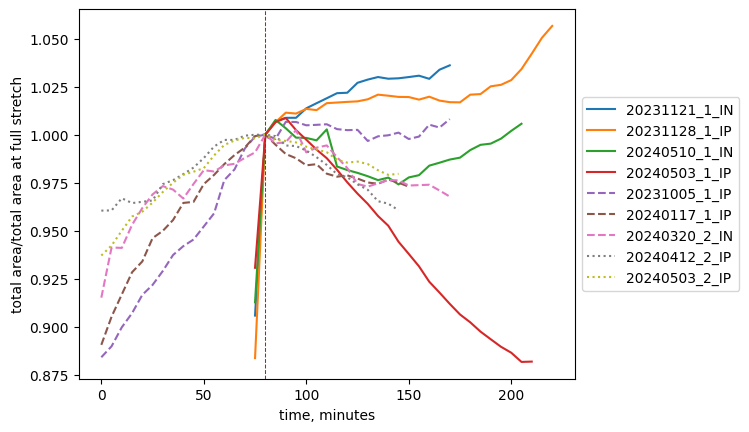

In [480]:
t2=np.linspace(0+75, 95+75, 20)
t3=np.linspace(0+75, 145+75, 30)
t4=np.linspace(0, 170, 35)
t5=np.linspace(0, 150, 31)
t6=np.linspace(0+75, 135+75, 28)
t7=np.linspace(0, 125, 26)
t8=np.linspace(0+75, 130+75, 27)
t9=np.linspace(0, 145, 30)




plt.plot(t2,dat_20231121_1_IN.groupby('time').cell_area_microns.sum()/(dat_20231121_1_IN[dat_20231121_1_IN.time==5].sum().cell_area_microns),label='20231121_1_IN')
plt.plot(t3,dat_20231128_1_IP.groupby('time').cell_area_microns.sum()/(dat_20231128_1_IP[dat_20231128_1_IP.time==5].sum().cell_area_microns),label='20231128_1_IP')
plt.plot(t8,dat_20240510_1_IN.groupby('time').cell_area_microns.sum()/(dat_20240510_1_IN[dat_20240510_1_IN.time==5].sum().cell_area_microns),label='20240510_1_IN')
plt.plot(t6,dat_20240503_1_IP.groupby('time').cell_area_microns.sum()/(dat_20240503_1_IP[dat_20240503_1_IP.time==5].sum().cell_area_microns),label='20240503_1_IP')


plt.plot(t4,inc_20231005_1_IP.groupby('time').cell_area_microns.sum()/(inc_20231005_1_IP[inc_20231005_1_IP.time==80].sum().cell_area_microns),label='20231005_1_IP', linestyle='--')
plt.plot(t5,inc_20240117_1_IP.groupby('time').cell_area_microns.sum()/(inc_20240117_1_IP[inc_20240117_1_IP.time==80].sum().cell_area_microns),label='20240117_1_IP', linestyle='--')
plt.plot(t4,inc_20240320_2_IN.groupby('time').cell_area_microns.sum()/(inc_20240320_2_IN[inc_20240320_2_IN.time==80].sum().cell_area_microns),label='20240320_2_IN', linestyle='--')



# plt.plot(t5,uns_20240117_2_IP.groupby('time').cell_area_microns.sum()/(uns_20240117_2_IP[uns_20240117_2_IP.time==0].sum().cell_area_microns),label='20240117_2_IP', linestyle='-.')
# plt.plot(t6,uns_20231012_2_IP.groupby('time').cell_area_microns.sum()/(uns_20231012_2_IP[uns_20231012_2_IP.time==0].sum().cell_area_microns),label='20231012_2_IP', linestyle='-.')
# plt.plot(t7,uns_20231019_1_IP.groupby('time').cell_area_microns.sum()/(uns_20231019_1_IP[uns_20231019_1_IP.time==0].sum().cell_area_microns),label='20231019_1_IP', linestyle='-.')

plt.plot(t9,con_20240412_2_IP.groupby('time').cell_area_microns.sum()/(con_20240412_2_IP[con_20240412_2_IP.time==80].sum().cell_area_microns),label='20240412_2_IP', linestyle=':')
plt.plot(t9,con_20240503_2_IP.groupby('time').cell_area_microns.sum()/(con_20240503_2_IP[con_20240503_2_IP.time==80].sum().cell_area_microns),label='20240503_2_IP', linestyle=':')



#plt.axvline(5, linestyle='--', color='red', linewidth=0.75)
plt.axvline(80, linestyle='--', color='red', linewidth=0.75)

plt.xlabel("time, minutes")
plt.ylabel("total area/total area at full stretch")
#plt.title("Fold change in total area of cells from full stretch")
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.savefig(save_dir+'/total_area_norm_full_stretch_shifted.png', dpi=300, bbox_inches='tight')

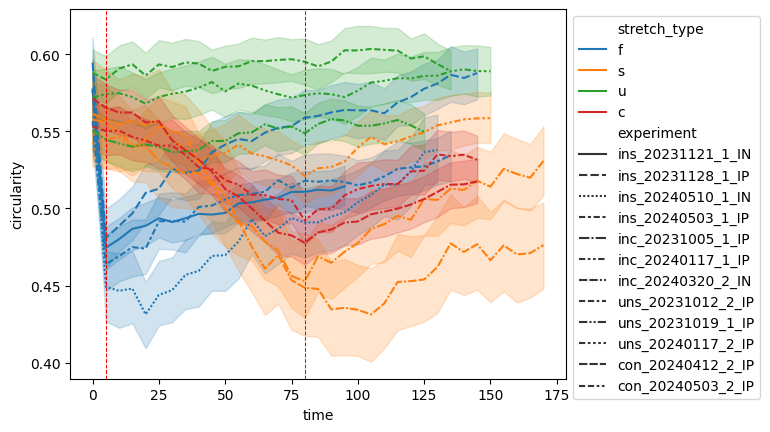

In [147]:
g=sns.lineplot(all_cells, x='time', y='circularity',hue='stretch_type', style='experiment')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)

plt.axvline(5, c='r', linestyle='--', linewidth=0.75)
plt.axvline(80, c='r', linestyle='--', linewidth=0.75)

plt.savefig(save_dir+'/compare_mean_circularity_time.png', dpi=300, bbox_inches='tight')

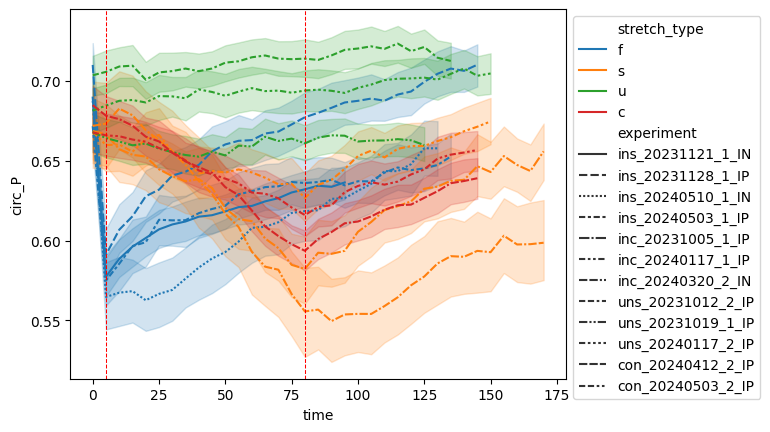

In [148]:
g=sns.lineplot(all_cells, x='time', y='circ_P',hue='stretch_type', style='experiment')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)

plt.axvline(5, c='r', linestyle='--', linewidth=0.75)
plt.axvline(80, c='r', linestyle='--', linewidth=0.75)
plt.savefig(save_dir+'/compare_mean_circ_P_time.png', dpi=300, bbox_inches='tight')

plt.show()


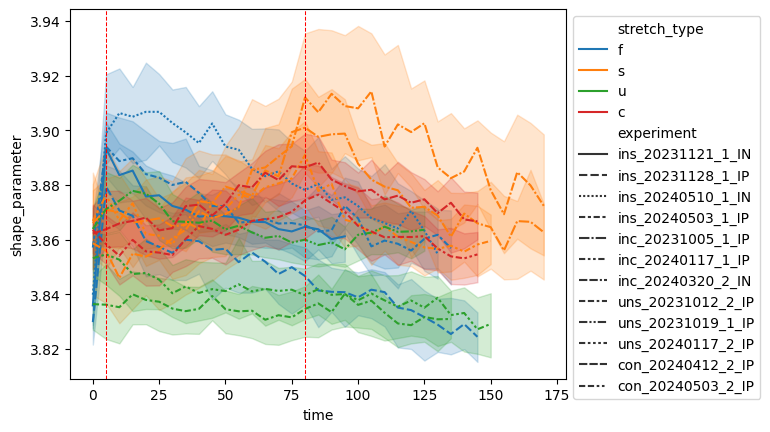

In [149]:
g=sns.lineplot(all_cells, x='time', y='shape_parameter',hue='stretch_type', style='experiment', estimator='median')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)

plt.axvline(5, c='r', linestyle='--', linewidth=0.75)
plt.axvline(80, c='r', linestyle='--', linewidth=0.75)

plt.savefig(save_dir+'/compare_median_shape_paramter_time.png', dpi=300, bbox_inches='tight')

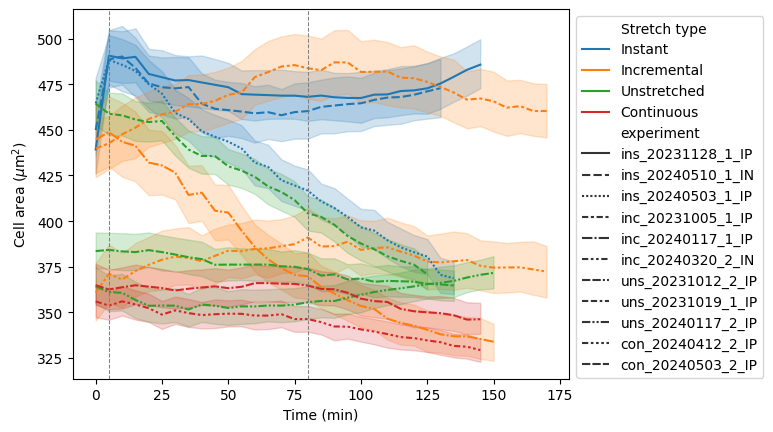

In [97]:
fig, ax=plt.subplots()
g=sns.lineplot(all_cells,ax=ax, x='time', y='cell_area_microns',hue='stretch_type', style='experiment')

plt.axvline(5, c='grey', linestyle='--', linewidth=0.75)
plt.axvline(80, c='grey', linestyle='--', linewidth=0.75)


h,l=g.get_legend_handles_labels()
new_labels=["Stretch type","Instant", "Incremental", "Unstretched", "Continuous"]
# for t, l in zip(g.legend.texts, new_labels):
#     t.set_text(l)
g.legend(h, np.hstack((new_labels, l[5:])))
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)

ax.set_xlabel("Time (min)")
ax.set_ylabel(r"Cell area ($\mu\mathrm{m}^2$)")

plt.savefig(save_dir+'/compare_mean_area_time_new.png', dpi=300, bbox_inches='tight')


Index(['index', 'cell_id_old', 'cell_perimeter_microns', 'cell_area_microns',
       'shape_parameter', 'circularity', 'cell_edge_count',
       'major_shape_axis_alignment_rads', 'cc_x', 'cc_y', 'cell_id_new',
       'spot_id', 'time', 'tm_frame', 'cell_perimeter_nd', 'cell_area_nd',
       'cell_P_eff_nd', 'cell_shear', 'cell_zeta',
       'major_stress_axis_alignment_rads', 'parent_id', 'divisions',
       'angle_horizontal', 'circ_J', 'circ_P', 'circ_A', 'shape_axis_J',
       'shape_axis_P', 'shape_axis_A', 'nn_order', 'nn_order_2', 'order_all',
       'mean_cc_distance', 'mean_cc_distance_2', 'experiment', 'stretch_type',
       'state', 'area_norm', 'perimeter_norm', 'first_frame', 'last_frame',
       'area_norm_mean', 'area_norm_last', 'circ_norm', 'circ_norm_last',
       'aligned_time', 'aligned_time_back'],
      dtype='object')

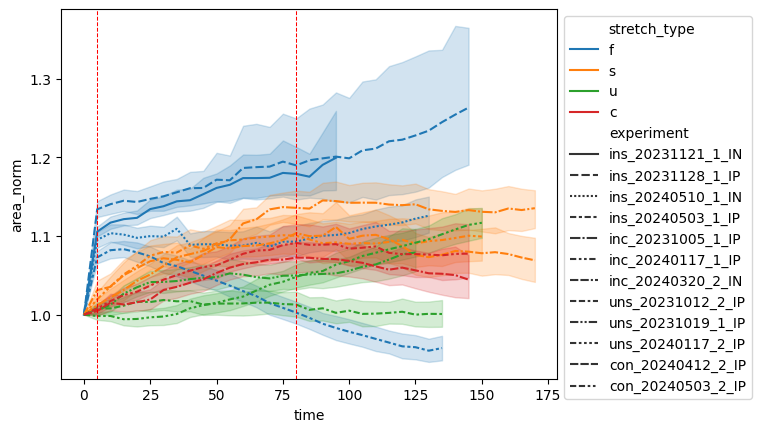

In [151]:
g=sns.lineplot(all_cells, x='time', y='area_norm',hue='stretch_type', style='experiment')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)

plt.axvline(5, c='r', linestyle='--', linewidth=0.75)
plt.axvline(80, c='r', linestyle='--', linewidth=0.75)

plt.savefig(save_dir+'/compare_mean_area_norm_time.png', dpi=300, bbox_inches='tight')

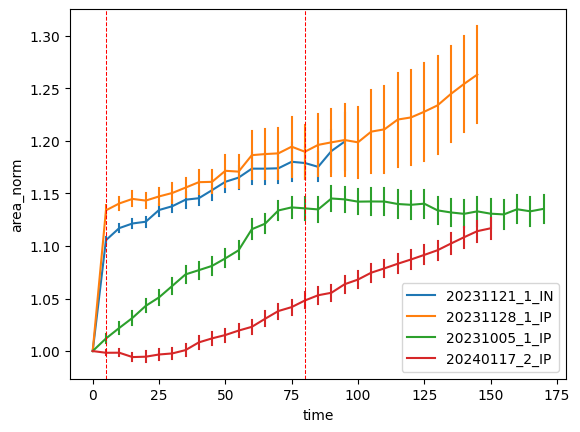

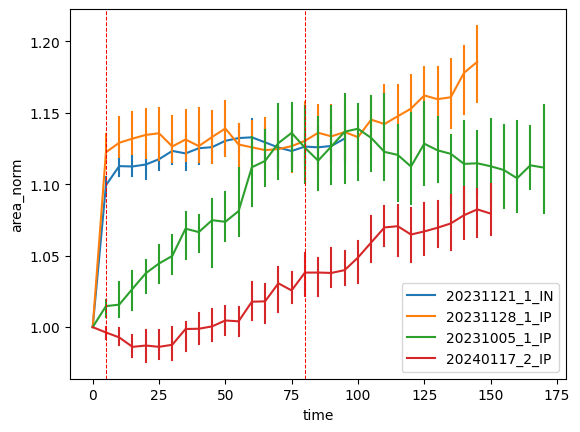

In [71]:
dat_20231121_1_IN['area_norm']=dat_20231121_1_IN.cell_area_microns/(dat_20231121_1_IN.groupby('cell_id_new').cell_area_microns.transform('first'))
dat_20231128_1_IP['area_norm']=dat_20231128_1_IP.cell_area_microns/(dat_20231128_1_IP.groupby('cell_id_new').cell_area_microns.transform('first'))
inc_20231005_1_IP['area_norm']=inc_20231005_1_IP.cell_area_microns/(inc_20231005_1_IP.groupby('cell_id_new').cell_area_microns.transform('first'))
uns_20240117_2_IP['area_norm']=uns_20240117_2_IP.cell_area_microns/(uns_20240117_2_IP.groupby('cell_id_new').cell_area_microns.transform('first'))





sns.lineplot(data=dat_20231121_1_IN, y='area_norm', x='time',err_style='bars', errorbar='se', label='20231121_1_IN')
sns.lineplot(data=dat_20231128_1_IP, y='area_norm', x='time',err_style='bars', errorbar='se', label='20231128_1_IP')
sns.lineplot(data=inc_20231005_1_IP, y='area_norm', x='time',err_style='bars', errorbar='se', label='20231005_1_IP')
sns.lineplot(data=uns_20240117_2_IP, y='area_norm', x='time',err_style='bars', errorbar='se', label='20240117_2_IP')


#sns.lineplot(data=dat_20151007_1_GSV, y='cell_area_microns', x='time',err_style='bars', errorbar='se', label='20151007_1_GSV')

#sns.lineplot(data=uns_20151125_1_GSV, y='cell_area_microns', x='time',err_style='bars', errorbar='se', label='20151125_1_GSV')

plt.axvline(5, c='r', linestyle='--', linewidth=0.75)
plt.axvline(80, c='r', linestyle='--', linewidth=0.75)

#plt.savefig(inst_dir+'/comaprte_ean_circularity_time.png', dpi=300, bbox_inches='tight')
plt.show()


sns.lineplot(data=dat_20231121_1_IN, y='area_norm', x='time',err_style='bars', estimator='median', label='20231121_1_IN')
sns.lineplot(data=dat_20231128_1_IP, y='area_norm', x='time',err_style='bars', estimator='median', label='20231128_1_IP')
sns.lineplot(data=inc_20231005_1_IP, y='area_norm', x='time',err_style='bars', estimator='median', label='20231005_1_IP')
sns.lineplot(data=uns_20240117_2_IP, y='area_norm', x='time',err_style='bars', estimator='median', label='20240117_2_IP')


#sns.lineplot(data=dat_20151007_1_GSV, y='cell_area_microns', x='time',err_style='bars', errorbar='se', label='20151007_1_GSV')

#sns.lineplot(data=uns_20151125_1_GSV, y='cell_area_microns', x='time',err_style='bars', errorbar='se', label='20151125_1_GSV')

plt.axvline(5, c='r', linestyle='--', linewidth=0.75)
plt.axvline(80, c='r', linestyle='--', linewidth=0.75)

#plt.savefig(inst_dir+'/comaprte_ean_circularity_time.png', dpi=300, bbox_inches='tight')
plt.show()

In [ ]:
(dat_20231128_1_IP[dat_20231128_1_IP.time==0].count().cell_id_new)

In [ ]:
plt.plot(dat_20151007_1_GSV.groupby('time').count().cell_id_new/(dat_20151007_1_GSV[dat_20151007_1_GSV.time==5].sum().cell_area_microns), label='20151007_1_GSV')
plt.plot(dat_20231121_1_IN.groupby('time').count().cell_id_new/(dat_20231121_1_IN[dat_20231121_1_IN.time==0].sum().cell_area_microns), label='20231121_1_IN')
plt.plot(dat_20231128_1_IP.groupby('time').count().cell_id_new/(dat_20231128_1_IP[dat_20231128_1_IP.time==0].sum().cell_area_microns), label='20231128_1_IP')

plt.axvline(5, c='r', linestyle='--')
plt.xlabel('time, minutes')
plt.ylabel('number of cells/number cells at full stretch')
#plt.title("Number of cell)
plt.legend()

plt.savefig(inst_dir+'/Number_cells_norm_time.png', dpi=300, bbox_inches='tight')

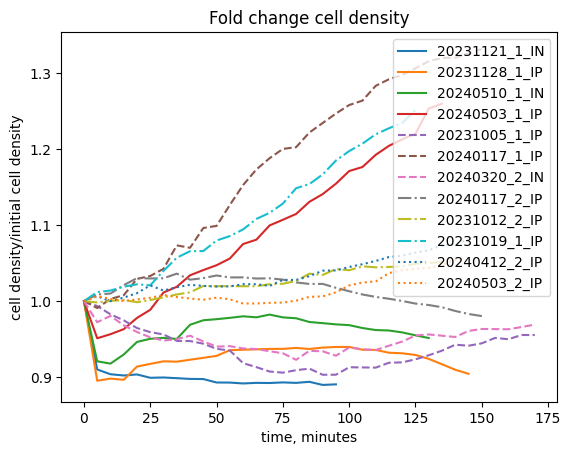

In [152]:


tshift=np.linspace(5,125, 25)
#plt.plot(tshift,dat_20151007_1_GSV.groupby('time').count().cell_id_new/(dat_20151007_1_GSV.groupby('time').cell_area_microns.sum()), label='20151007_1_GSV')
plt.plot((dat_20231121_1_IN.groupby('time').count().cell_id_new/(dat_20231121_1_IN.groupby('time').cell_area_microns.sum()))/(dat_20231121_1_IN[dat_20231121_1_IN.time==0].cell_id_new.count()/((dat_20231121_1_IN[dat_20231121_1_IN.time==0].cell_area_microns.sum()))), label='20231121_1_IN')
plt.plot((dat_20231128_1_IP.groupby('time').count().cell_id_new/(dat_20231128_1_IP.groupby('time').cell_area_microns.sum()))/(dat_20231128_1_IP[dat_20231128_1_IP.time==0].cell_id_new.count()/((dat_20231128_1_IP[dat_20231128_1_IP.time==0].cell_area_microns.sum()))), label='20231128_1_IP')
plt.plot((dat_20240510_1_IN.groupby('time').count().cell_id_new/(dat_20240510_1_IN.groupby('time').cell_area_microns.sum()))/(dat_20240510_1_IN[dat_20240510_1_IN.time==0].cell_id_new.count()/((dat_20240510_1_IN[dat_20240510_1_IN.time==0].cell_area_microns.sum()))), label='20240510_1_IN')
plt.plot((dat_20240503_1_IP.groupby('time').count().cell_id_new/(dat_20240503_1_IP.groupby('time').cell_area_microns.sum()))/(dat_20240503_1_IP[dat_20240503_1_IP.time==0].cell_id_new.count()/((dat_20240503_1_IP[dat_20240503_1_IP.time==0].cell_area_microns.sum()))), label='20240503_1_IP')


plt.plot((inc_20231005_1_IP.groupby('time').count().cell_id_new/(inc_20231005_1_IP.groupby('time').cell_area_microns.sum()))/(inc_20231005_1_IP[inc_20231005_1_IP.time==0].cell_id_new.count()/((inc_20231005_1_IP[inc_20231005_1_IP.time==0].cell_area_microns.sum()))), label='20231005_1_IP', linestyle='--')
plt.plot((inc_20240117_1_IP.groupby('time').count().cell_id_new/(inc_20240117_1_IP.groupby('time').cell_area_microns.sum()))/(inc_20240117_1_IP[inc_20240117_1_IP.time==0].cell_id_new.count()/((inc_20240117_1_IP[inc_20240117_1_IP.time==0].cell_area_microns.sum()))), label='20240117_1_IP', linestyle='--')
plt.plot((inc_20240320_2_IN.groupby('time').count().cell_id_new/(inc_20240320_2_IN.groupby('time').cell_area_microns.sum()))/(inc_20240320_2_IN[inc_20240320_2_IN.time==0].cell_id_new.count()/((inc_20240320_2_IN[inc_20240320_2_IN.time==0].cell_area_microns.sum()))), label='20240320_2_IN', linestyle='--')


plt.plot((uns_20240117_2_IP.groupby('time').count().cell_id_new/(uns_20240117_2_IP.groupby('time').cell_area_microns.sum()))/(uns_20240117_2_IP[uns_20240117_2_IP.time==0].cell_id_new.count()/((uns_20240117_2_IP[uns_20240117_2_IP.time==0].cell_area_microns.sum()))), label='20240117_2_IP', linestyle='-.')
plt.plot((uns_20231012_2_IP.groupby('time').count().cell_id_new/(uns_20231012_2_IP.groupby('time').cell_area_microns.sum()))/(uns_20231012_2_IP[uns_20231012_2_IP.time==0].cell_id_new.count()/((uns_20231012_2_IP[uns_20231012_2_IP.time==0].cell_area_microns.sum()))), label='20231012_2_IP', linestyle='-.')
plt.plot((uns_20231019_1_IP.groupby('time').count().cell_id_new/(uns_20231019_1_IP.groupby('time').cell_area_microns.sum()))/(uns_20231019_1_IP[uns_20231019_1_IP.time==0].cell_id_new.count()/((uns_20231019_1_IP[uns_20231019_1_IP.time==0].cell_area_microns.sum()))), label='20231019_1_IP', linestyle='-.')

plt.plot((con_20240412_2_IP.groupby('time').count().cell_id_new/(con_20240412_2_IP.groupby('time').cell_area_microns.sum()))/(con_20240412_2_IP[con_20240412_2_IP.time==0].cell_id_new.count()/((con_20240412_2_IP[con_20240412_2_IP.time==0].cell_area_microns.sum()))), label='20240412_2_IP', linestyle=':')
plt.plot((con_20240503_2_IP.groupby('time').count().cell_id_new/(con_20240503_2_IP.groupby('time').cell_area_microns.sum()))/(con_20240503_2_IP[con_20240503_2_IP.time==0].cell_id_new.count()/((con_20240503_2_IP[con_20240503_2_IP.time==0].cell_area_microns.sum()))), label='20240503_2_IP', linestyle=':')


#plt.axvline(5, c='r', linestyle='--', linewidth=0.75)
#plt.axvline(80, c='r', linestyle='--', linewidth=0.75)


plt.xlabel('time, minutes')
plt.ylabel('cell density/initial cell density')
plt.title("Fold change cell density")
plt.legend()
plt.savefig(save_dir+'/fold_change_cell_density_time.png', dpi=300, bbox_inches='tight')

In [ ]:
(dat_20231121_1_IN[dat_20231121_1_IN.time==0].cell_id_new.count()/((dat_20231121_1_IN[dat_20231121_1_IN.time==0].cell_area_microns.sum())))

In [ ]:
sns.lineplot(data=dat_20231121_1_IN, y='angle_horizontal', x='time',err_style='bars', errorbar='se', label='20231121_1_IN')
sns.lineplot(data=dat_20231128_1_IP, y='angle_horizontal', x='time',err_style='bars', errorbar='se', label='20231128_1_IP')

# sns.lineplot(data=inc_20231005_1_IP, y='angle_horizontal', x='time',err_style='bars', errorbar='se', label='20231005_1_IP', linestyle='--')
# sns.lineplot(data=inc_20240117_1_IP, y='angle_horizontal', x='time',err_style='bars', errorbar='se', label='20240117_1_IP', linestyle='--')
# sns.lineplot(data=inc_20240320_2_IN, y='angle_horizontal', x='time',err_style='bars', errorbar='se', label='20240320_2_IN', linestyle='--')


# sns.lineplot(data=uns_20240117_2_IP, y='angle_horizontal', x='time',err_style='bars', errorbar='se', label='20240117_2_IP', linestyle='-.')
# sns.lineplot(data=uns_20231012_2_IP, y='angle_horizontal', x='time',err_style='bars', errorbar='se', label='20231012_2_IP', linestyle='-.')
# sns.lineplot(data=uns_20231019_1_IP, y='angle_horizontal', x='time',err_style='bars', errorbar='se', label='20231019_1_IP', linestyle='-.')


#sns.lineplot(data=dat_20151007_1_GSV, y='cell_area_microns', x='time',err_style='bars', errorbar='se', label='20151007_1_GSV')

#sns.lineplot(data=uns_20151125_1_GSV, y='cell_area_microns', x='time',err_style='bars', errorbar='se', label='20151125_1_GSV')

plt.axvline(5, c='r', linestyle='--', linewidth=0.75)
#plt.axvline(80, c='r', linestyle='--', linewidth=0.75)
plt.title("Mean angle with horizontal, Instant")


plt.savefig(inst_dir+'/comapare_angle_time_instant.png', dpi=300, bbox_inches='tight')
plt.show()

In [153]:
daughter_cells=all_cells[all_cells.divisions>0]
orig_cells=all_cells[all_cells.divisions==0]
daughter_cells['aligned_time']=daughter_cells['time']-daughter_cells.groupby(['experiment','cell_id_new'])['time'].transform('first')


C:\Users\v35431nc\AppData\Local\Temp\ipykernel_28612\3609662685.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  daughter_cells['aligned_time']=daughter_cells['time']-daughter_cells.groupby(['experiment','cell_id_new'])['time'].transform('first')


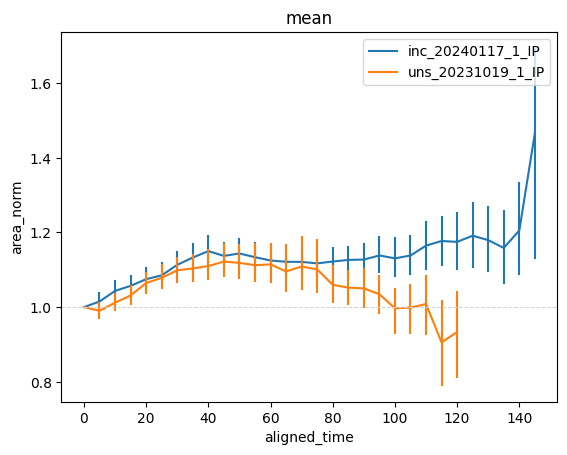

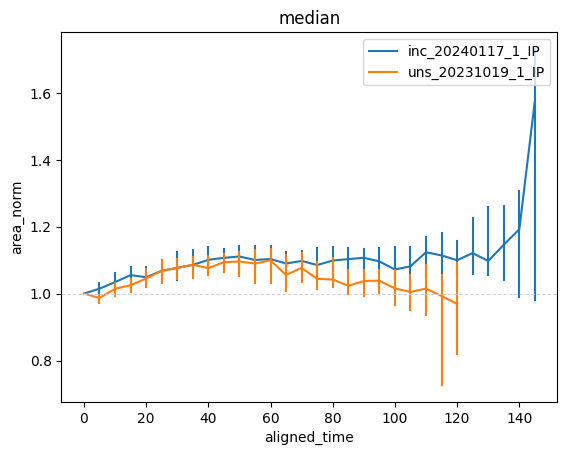

In [74]:

#sns.lineplot(data=uns_orig_cells, y='area_norm', x='time', hue='experiment',err_style='bars',label='original cells')
sns.lineplot(data=daughter_cells[(daughter_cells.experiment=='uns_20231019_1_IP')|(daughter_cells.experiment=='inc_20240117_1_IP')], y='area_norm', hue='experiment', x='aligned_time',err_style='bars')
plt.axhline(1, linestyle='--', color='lightgrey', linewidth=0.75)
plt.title('mean')
plt.legend()
plt.savefig(save_dir+'/many_div_exp_mean_area_norm_time_daughter_time_aligned.png', dpi=300, bbox_inches='tight')
plt.show()



#sns.lineplot(data=uns_orig_cells, y='area_norm', x='time',err_style='bars', hue='experiment',label='original cells', estimator='median')
sns.lineplot(data=daughter_cells[(daughter_cells.experiment=='uns_20231019_1_IP')|(daughter_cells.experiment=='inc_20240117_1_IP')], y='area_norm', x='aligned_time', hue='experiment',err_style='bars', estimator='median')
plt.axhline(1, linestyle='--', color='lightgrey', linewidth=0.75)
plt.title('median')
plt.legend()
plt.savefig(save_dir+'/many_div_exp_median_area_norm_time_daughter_time_aligned.png', dpi=300, bbox_inches='tight')
plt.show()

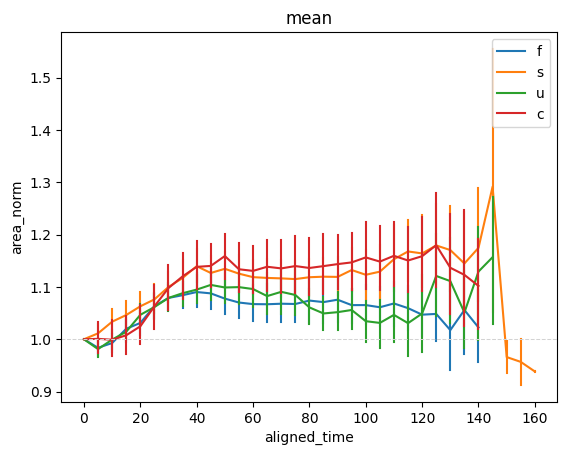

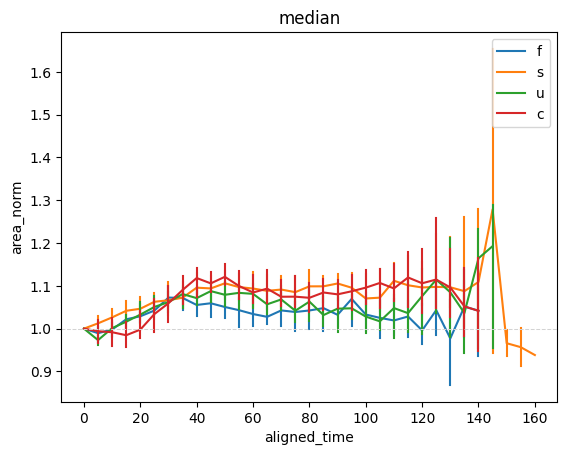

In [154]:
#sns.lineplot(data=uns_orig_cells, y='area_norm', x='time', hue='experiment',err_style='bars',label='original cells')
sns.lineplot(data=daughter_cells, y='area_norm', hue='stretch_type', x='aligned_time',err_style='bars')
plt.axhline(1, linestyle='--', color='lightgrey', linewidth=0.75)
plt.title('mean')
plt.legend()
plt.savefig(save_dir+'/all_st_mean_area_norm_time_daughter_time_aligned.png', dpi=300, bbox_inches='tight')
plt.show()



#sns.lineplot(data=uns_orig_cells, y='area_norm', x='time',err_style='bars', hue='experiment',label='original cells', estimator='median')
sns.lineplot(data=daughter_cells, y='area_norm', x='aligned_time', hue='stretch_type',err_style='bars', estimator='median')
plt.axhline(1, linestyle='--', color='lightgrey', linewidth=0.75)
plt.title('median')
plt.legend()
plt.savefig(save_dir+'/all_st_median_area_norm_time_daughter_time_aligned.png', dpi=300, bbox_inches='tight')
plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


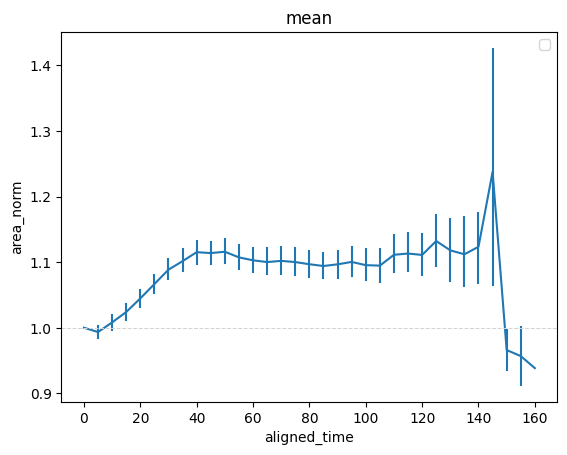

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


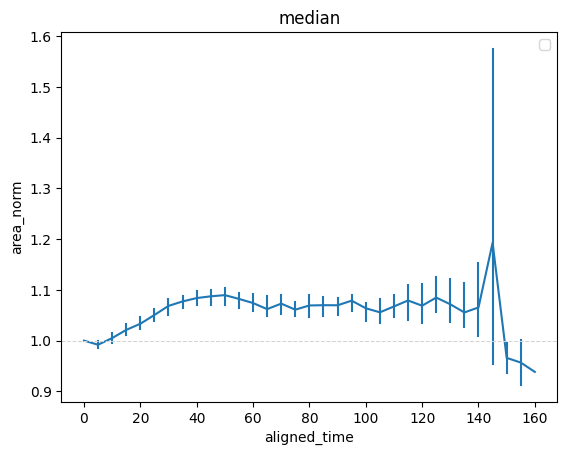

In [155]:

#sns.lineplot(data=uns_orig_cells, y='area_norm', x='time', hue='experiment',err_style='bars',label='original cells')
sns.lineplot(data=daughter_cells, y='area_norm', x='aligned_time',err_style='bars')
plt.axhline(1, linestyle='--', color='lightgrey', linewidth=0.75)
plt.title('mean')
plt.legend()
plt.savefig(save_dir+'/all_mean_area_norm_time_daughter_time_aligned.png', dpi=300, bbox_inches='tight')
plt.show()



#sns.lineplot(data=uns_orig_cells, y='area_norm', x='time',err_style='bars', hue='experiment',label='original cells', estimator='median')
sns.lineplot(data=daughter_cells, y='area_norm', x='aligned_time',err_style='bars', estimator='median')
plt.axhline(1, linestyle='--', color='lightgrey', linewidth=0.75)
plt.title('median')
plt.legend()
plt.savefig(save_dir+'/all_median_area_norm_time_daughter_time_aligned.png', dpi=300, bbox_inches='tight')
plt.show()

In [ ]:
g = sns.FacetGrid(daughter_cells, col="aligned_time", height=2.5, col_wrap=3)
g.map(sns.histplot, "cell_area_microns")

In [ ]:
g = sns.FacetGrid(daughter_cells, col="aligned_time", height=2.5, col_wrap=9, hue='stretch_type',palette=sns.husl_palette(3,l=.4))
g.map(sns.histplot, "cell_area_microns",element="step", alpha=0.4, legend=True)
g.add_legend()
#plt.suptitle("daughter cell area")
sns.move_legend(g, "upper left", bbox_to_anchor=(0.4, 1.05), frameon=True, ncol=3)
plt.savefig(save_dir+'/daughter_cell_distributions.png', dpi=300, bbox_inches='tight')




In [ ]:
all_cells[all_cells.time==0].groupby(['experiment']).count()

In [ ]:
daughter_cells.groupby(['experiment', 'cell_id_new']).last().groupby(['experiment']).count()

In [ ]:
uns_20231012_2_IP[uns_20231012_2_IP.time==135].count()

In [ ]:
all_cells.groupby('experiment')

In [ ]:
dat_mi=all_cells.set_index(['experiment','cell_id_new','time'])


In [ ]:
dat_mi

In [ ]:
trans_inc_a=[]
drift_inc_a=[]
for i in np.sort(np.unique(inc_20231005_1_IP.tm_frame))[:-1]:
    cells=list(set(inc_20231005_1_IP[inc_20231005_1_IP.tm_frame==i+1].cell_id_new).intersection(set(inc_20231005_1_IP[inc_20231005_1_IP.tm_frame==i].cell_id_new)))
    cell_fr=inc_20231005_1_IP[(inc_20231005_1_IP.cell_id_new.isin(cells))]
    cc_i=np.transpose(np.vstack((cell_fr[cell_fr.tm_frame==i].cc_x, cell_fr[cell_fr.tm_frame==i].cc_y)))
    cc_f=np.transpose(np.vstack((cell_fr[cell_fr.tm_frame==i+1].cc_x, cell_fr[cell_fr.tm_frame==i+1].cc_y)))
    trans=cv2.estimateAffine2D(cc_i, cc_f, method=cv2.RANSAC)[0]
    aft=np.array(trans[:,:2])
    drift=trans[:,2:].T[0]
    trans_inc_a.append(polar(aft)[1].diagonal())
    drift_inc_a.append(drift)
trans_inc_a=np.array(trans_inc_a)
drift_inc_a=np.array(drift_inc_a)

trans_inc_b=[]
drift_inc_b=[]
for i in np.unique(inc_20240117_1_IP.tm_frame)[:-1]:
    cells=list(set(inc_20240117_1_IP[inc_20240117_1_IP.tm_frame==i+1].cell_id_new).intersection(set(inc_20240117_1_IP[inc_20240117_1_IP.tm_frame==i].cell_id_new)))
    cell_fr=inc_20240117_1_IP[(inc_20240117_1_IP.cell_id_new.isin(cells))]
    cc_i=np.transpose(np.vstack((cell_fr[cell_fr.tm_frame==i].cc_x, cell_fr[cell_fr.tm_frame==i].cc_y)))
    cc_f=np.transpose(np.vstack((cell_fr[cell_fr.tm_frame==i+1].cc_x, cell_fr[cell_fr.tm_frame==i+1].cc_y)))
    aft=np.array(cv2.estimateAffine2D(cc_i, cc_f, method=cv2.RANSAC)[0][:,:2])
    trans_inc_b.append(polar(aft)[1].diagonal())
trans_inc_b=np.array(trans_inc_b)

trans_inc_c=[]
drift_inc_c=[]
for i in np.unique(inc_20240320_2_IN.tm_frame)[:-1]:
    cells=list(set(inc_20240320_2_IN[inc_20240320_2_IN.tm_frame==i+1].cell_id_new).intersection(set(inc_20240320_2_IN[inc_20240320_2_IN.tm_frame==i].cell_id_new)))
    cell_fr=inc_20240320_2_IN[(inc_20240320_2_IN.cell_id_new.isin(cells))]
    cc_i=np.transpose(np.vstack((cell_fr[cell_fr.tm_frame==i].cc_x, cell_fr[cell_fr.tm_frame==i].cc_y)))
    cc_f=np.transpose(np.vstack((cell_fr[cell_fr.tm_frame==i+1].cc_x, cell_fr[cell_fr.tm_frame==i+1].cc_y)))
    aft=np.array(cv2.estimateAffine2D(cc_i, cc_f, method=cv2.RANSAC)[0][:,:2])
    trans_inc_c.append(polar(aft)[1].diagonal())
trans_inc_c=np.array(trans_inc_c)



In [ ]:
plt.plot(trans_inc_a[:,0], '-', trans_inc_a[:,1])
plt.plot(trans_inc_b[:,0], '-', trans_inc_b[:,1])
plt.plot(trans_inc_c[:,0], '-', trans_inc_c[:,1])

plt.axhline(1,c='k', linestyle='--')

In [ ]:
drift_inc_a

In [ ]:
plt.plot(drift_inc_a)

In [ ]:
cv2.estimateAffine2D(cc_i, cc_f, method=cv2.RANSAC)[0]

In [ ]:
all_trans_inc=np.vstack((np.vstack((np.linspace(0, len(trans_inc_a)-1, len(trans_inc_a)).T, trans_inc_a.T)).T,np.vstack((np.linspace(0, len(trans_inc_b)-1, len(trans_inc_b)).T, trans_inc_b.T)).T,np.vstack((np.linspace(0, len(trans_inc_c)-1, len(trans_inc_c)).T, trans_inc_c.T)).T))

In [ ]:
trans_stretch=np.vstack((np.vstack((np.linspace(0, len(trans_inc_a[:16])-1, len(trans_inc_a[:16])).T, trans_inc_a[:16].T)).T,np.vstack((np.linspace(0, len(trans_inc_b[:16])-1, len(trans_inc_b[:16])).T, trans_inc_b[:16].T)).T,np.vstack((np.linspace(0, len(trans_inc_c[:16])-1, len(trans_inc_c[:16])).T, trans_inc_c[:16].T)).T))

In [ ]:
plt.scatter(all_trans_inc[:,0], all_trans_inc[:,1])
plt.axhline(1,c='k', linestyle='--')
plt.axvline(15.5)
plt.scatter(trans_stretch[:,0], trans_stretch[:,1])
fit = np.polyfit(trans_stretch[:,0],trans_stretch[:,1],3) # increase order to get better fit
fit_fn = np.poly1d(fit)
plt.plot(np.linspace(0, 15, 100),fit_fn(np.linspace(0, 15, 100)))
fit
plt.plot(trans_inc_a[:,0])
plt.plot(trans_inc_b[:,0])
plt.plot(trans_inc_c[:,0])


In [ ]:
plt.plot(trans_inc_a[:,0]-1)
plt.plot(trans_inc_b[:,0]-1)
plt.plot(trans_inc_c[:,0]-1)

In [ ]:
plt.plot(np.cumprod(trans_inc_a[:,0]))
plt.plot(np.cumprod(trans_inc_b[:,0]))
plt.plot(np.cumprod(trans_inc_c[:,0]))

In [ ]:
plt.plot(np.cumprod(trans_inc_a[:,1]))
plt.plot(np.cumprod(trans_inc_b[:,1]))
plt.plot(np.cumprod(trans_inc_c[:,1]))

In [ ]:
plt.scatter(all_trans_inc[:,0], all_trans_inc[:,2])

plt.axhline(1,c='k', linestyle='--')
plt.axvline(16)

In [ ]:
plt.plot(trans_inc_a[:,0], trans_inc_a[:,1])
plt.plot(trans_inc_b[:,0], trans_inc_b[:,1])
plt.plot(trans_inc_c[:,0], trans_inc_c[:,1])

In [ ]:
all_trans=pd.DataFrame(all_trans_inc, columns=["frame", "x_def", "y_def"])

In [ ]:
plt.plot(all_trans.groupby("frame").mean().x_def)
plt.plot(all_trans.groupby("frame").mean().y_def)

In [ ]:
plt.scatter(inc_20231005_1_IP[inc_20231005_1_IP.tm_frame==0].cc_x, inc_20231005_1_IP[inc_20231005_1_IP.tm_frame==0].cc_y, s=1)
plt.scatter(inc_20231005_1_IP[inc_20231005_1_IP.tm_frame==1].cc_x, inc_20231005_1_IP[inc_20231005_1_IP.tm_frame==1].cc_y, s=1)
plt.scatter(inc_20231005_1_IP[inc_20231005_1_IP.tm_frame==1].cc_x-drift_inc_a[0,0], inc_20231005_1_IP[inc_20231005_1_IP.tm_frame==1].cc_y-drift_inc_a[0,1], s=1)

In [ ]:
all_inc.groupby(['experiment', 'time']).sum()

In [ ]:
sns.lineplot(data=all_inc, x='time', y='cell_area_microns', hue='experiment', estimator='sum')

In [ ]:
inc_tot_area=((all_inc.groupby(['experiment', 'time']).cell_area_microns.sum())/(all_inc.groupby(['experiment', 'time']).cell_area_microns.sum()).groupby(['experiment']).first()).to_frame()

In [ ]:
sns.lineplot(data=inc_tot_area, x='time', y='cell_area_microns', hue='experiment')
plt.axvline(80, color='k')

In [ ]:
plt.plot(inc_20231005_1_IP.groupby('time').count().cell_id_new/(inc_20231005_1_IP[inc_20231005_1_IP.time==0].count().cell_id_new), label='20231005_1_IP', linestyle='--')
plt.plot(inc_20240117_1_IP.groupby('time').count().cell_id_new/(inc_20240117_1_IP[inc_20240117_1_IP.time==0].count().cell_id_new), label='20240117_1_IP', linestyle='--')
plt.plot(inc_20240320_2_IN.groupby('time').count().cell_id_new/(inc_20240320_2_IN[inc_20240320_2_IN.time==0].count().cell_id_new), label='20240320_2_IN', linestyle='--')

plt.axvline(80, color='k')

In [ ]:
t2=np.linspace(0, 95, 20)
t3=np.linspace(0, 145, 30)
t4=np.linspace(0, 170, 35)
t5=np.linspace(0, 150, 31)
t6=np.linspace(0, 135, 28)
t7=np.linspace(0, 125, 26)


plt.plot(t2,dat_20231121_1_IN.groupby('time').cell_area_microns.sum()/(dat_20231121_1_IN[dat_20231121_1_IN.time==0].sum().cell_area_microns),label='20231121_1_IN')
plt.plot(t3,dat_20231128_1_IP.groupby('time').cell_area_microns.sum()/(dat_20231128_1_IP[dat_20231128_1_IP.time==0].sum().cell_area_microns),label='20231128_1_IP')

plt.plot(t4,inc_20231005_1_IP.groupby('time').cell_area_microns.sum()/(inc_20231005_1_IP[inc_20231005_1_IP.time==0].sum().cell_area_microns),label='20231005_1_IP', linestyle='--')
plt.plot(t5,inc_20240117_1_IP.groupby('time').cell_area_microns.sum()/(inc_20240117_1_IP[inc_20240117_1_IP.time==0].sum().cell_area_microns),label='20240117_1_IP', linestyle='--')
plt.plot(t4,inc_20240320_2_IN.groupby('time').cell_area_microns.sum()/(inc_20240320_2_IN[inc_20240320_2_IN.time==0].sum().cell_area_microns),label='20240320_2_IN', linestyle='--')



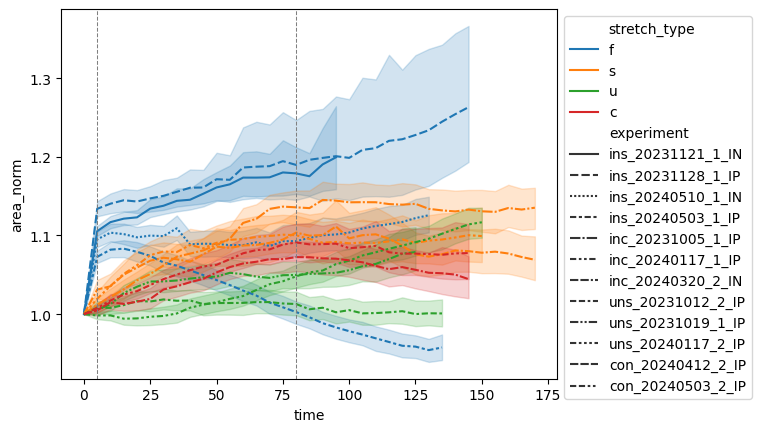

In [156]:
g=sns.lineplot(data=all_cells, x='time', y='area_norm', hue='stretch_type', style='experiment', estimator='mean')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)
plt.axvline(5, linestyle='--', linewidth=0.75, color='grey')
plt.axvline(80, linestyle='--', linewidth=0.75, color='grey')

plt.savefig(save_dir+'/area_norm_experiment.png', dpi=300, bbox_inches='tight')



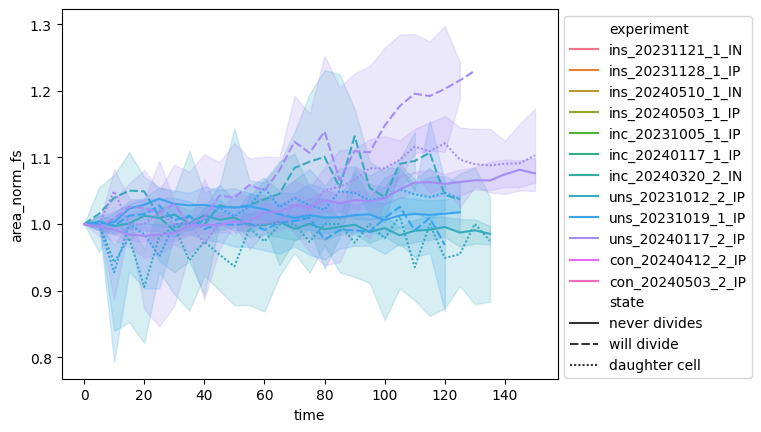

In [483]:
g=sns.lineplot(data=all_cells, x='time', y='area_norm_fs', hue='experiment', style='state', estimator='median')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)

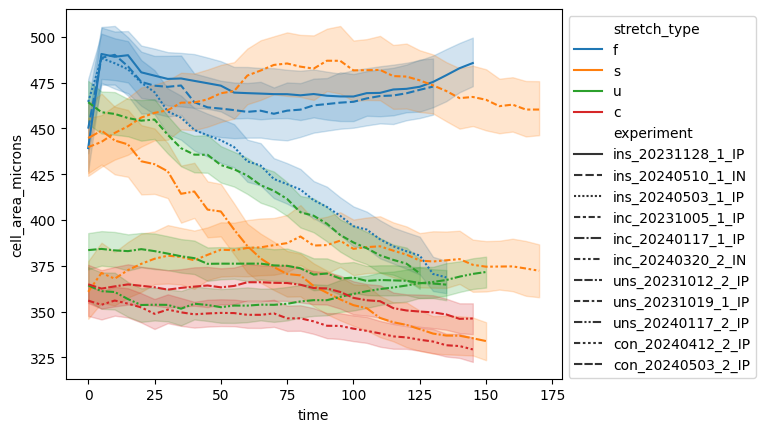

In [41]:
g=sns.lineplot(data=all_cells, x='time', y='cell_area_microns', hue='stretch_type', style='experiment', estimator='mean')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)


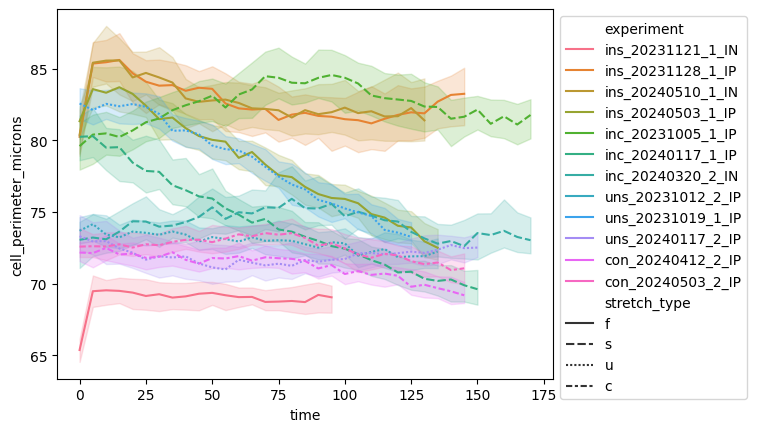

In [199]:
g=sns.lineplot(data=all_cells, x='time', y='cell_perimeter_microns', hue='experiment', style='stretch_type', estimator='median')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)

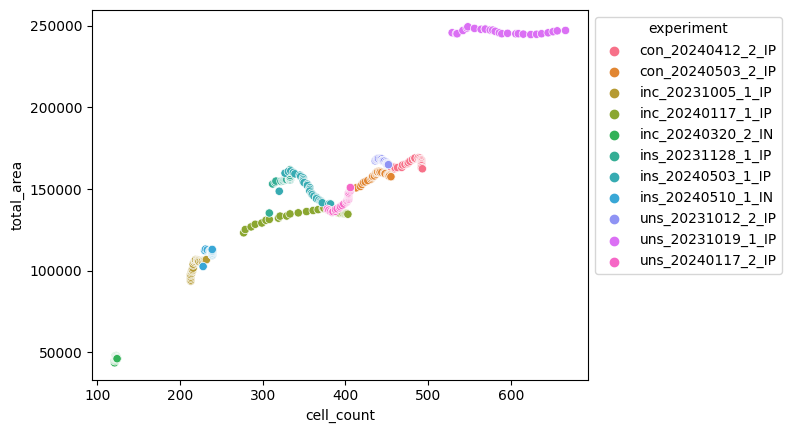

In [42]:

exp_data=all_cells.groupby(['experiment', 'time']).cell_area_microns.sum().to_frame(name='total_area')
exp_data
exp_data=exp_data.merge(all_cells.groupby(['experiment', 'time']).cell_id_new.count(), on=['experiment', 'time'])
exp_data=exp_data.rename(columns={'cell_id_new':'cell_count'})

exp_data['cell_density']=exp_data.cell_count/exp_data.total_area
exp_data['mean_area_per_cell']=exp_data.total_area/exp_data.cell_count

g=sns.scatterplot(exp_data, x='cell_count', y='total_area', hue='experiment')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)


#plt.scatter(all_cells.groupby(['experiment', 'time']).cell_id_new.count(),all_cells.groupby(['experiment', 'time']).cell_area_microns.sum(), s=5)

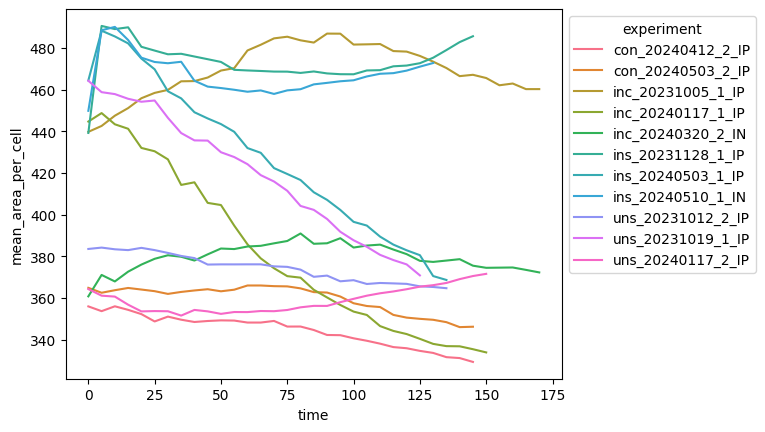

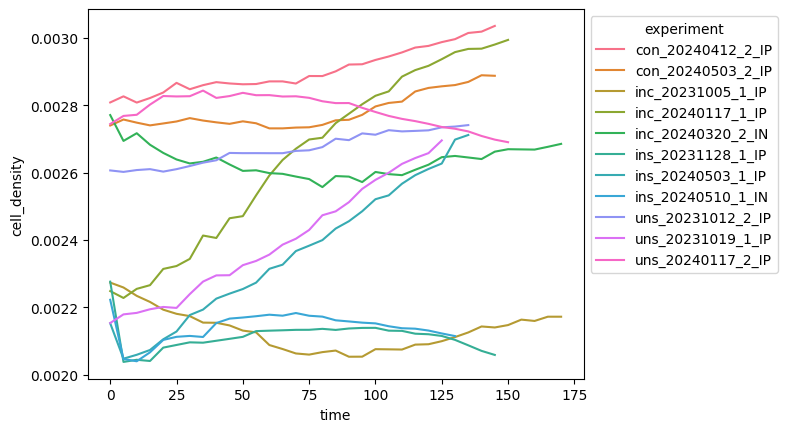

In [66]:
g=sns.lineplot(exp_data, x='time',y='mean_area_per_cell', hue='experiment' )
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)
plt.show()
g=sns.lineplot(exp_data, x='time',y='cell_density', hue='experiment' )
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)


AttributeError: module 'numpy' has no attribute 'count'

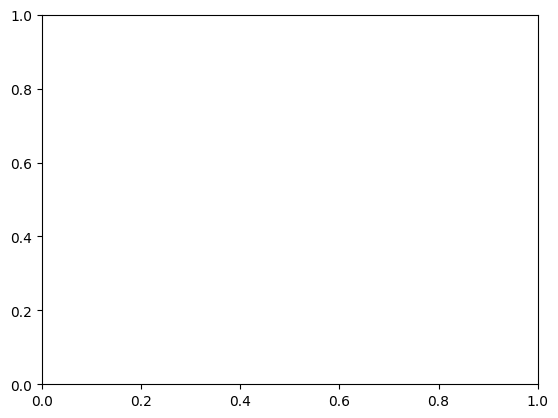

In [43]:
g=sns.lineplot(data=all_cells, x='time', y='divisions', hue='experiment', style='stretch_type', estimator='count')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)

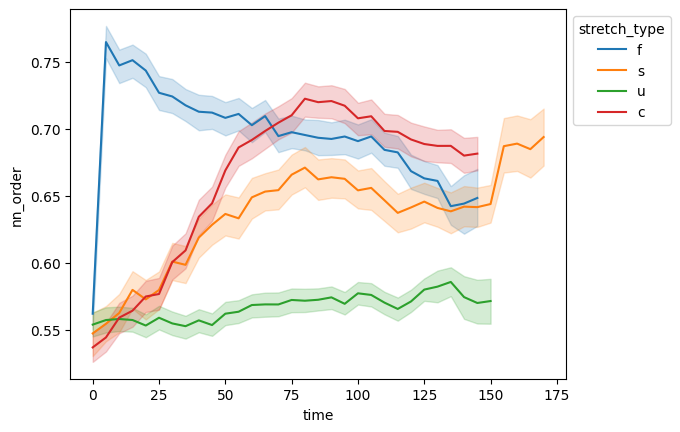

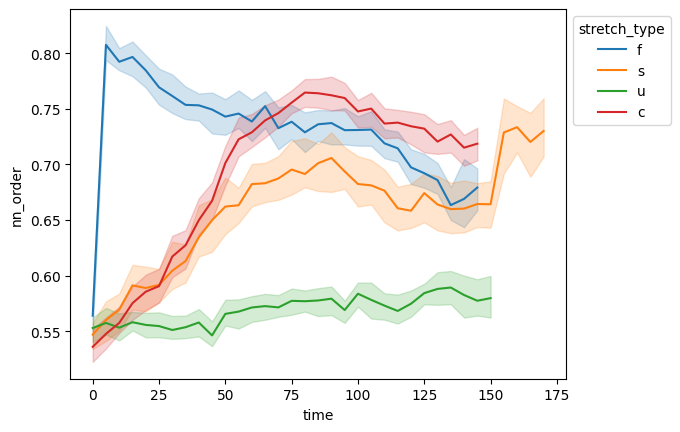

In [44]:
g=sns.lineplot(data=all_cells, x='time', y='nn_order', hue='stretch_type', estimator='mean')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)
plt.show()
g=sns.lineplot(data=all_cells, x='time', y='nn_order', hue='stretch_type', estimator='median')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)


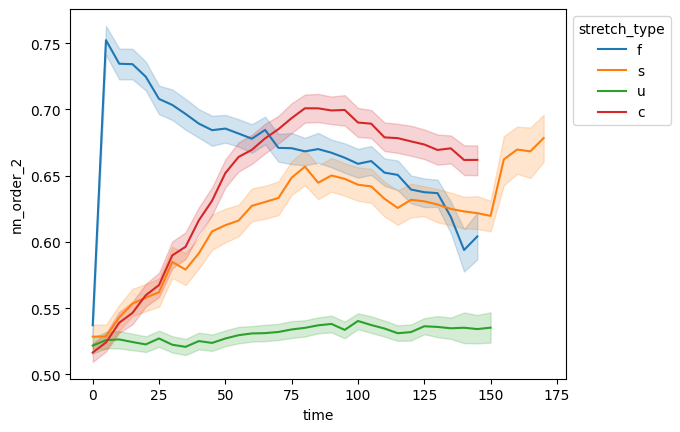

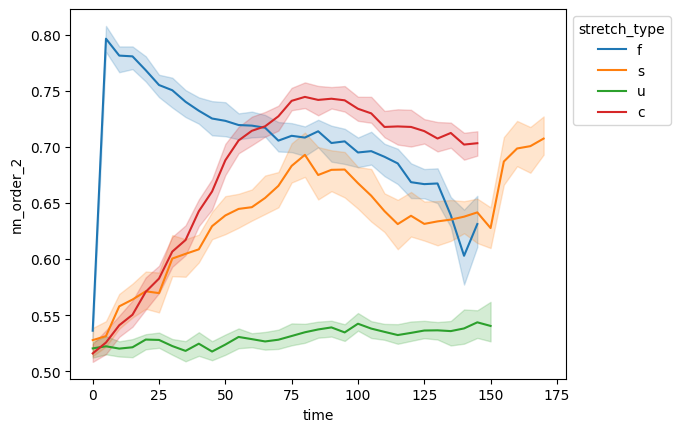

In [45]:
g=sns.lineplot(data=all_cells, x='time', y='nn_order_2', hue='stretch_type', estimator='mean')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)
plt.show()
g=sns.lineplot(data=all_cells, x='time', y='nn_order_2', hue='stretch_type', estimator='median')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)


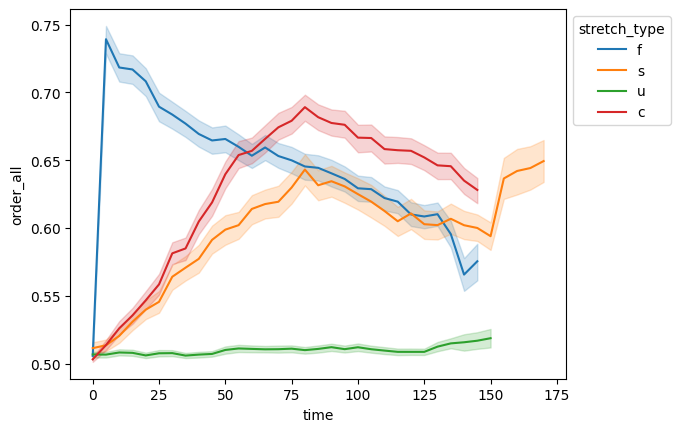

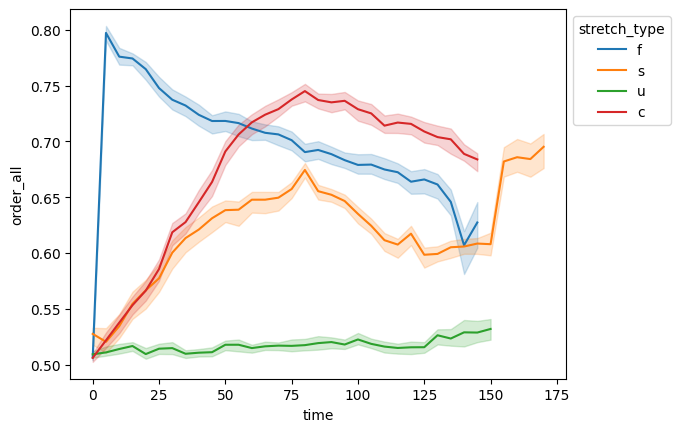

In [46]:
g=sns.lineplot(data=all_cells, x='time', y='order_all', hue='stretch_type', estimator='mean')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)
plt.show()
g=sns.lineplot(data=all_cells, x='time', y='order_all', hue='stretch_type', estimator='median')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)


<AxesSubplot: xlabel='time', ylabel='nn_order'>

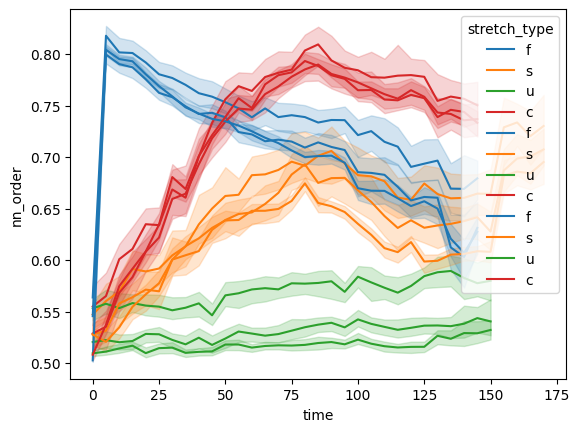

In [81]:
sns.lineplot(data=all_cells, x='time', y='nn_order', hue='stretch_type', estimator='median')
sns.lineplot(data=all_cells, x='time', y='nn_order_2', hue='stretch_type', estimator='median')
sns.lineplot(data=all_cells, x='time', y='order_all', hue='stretch_type', estimator='median')
#sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)

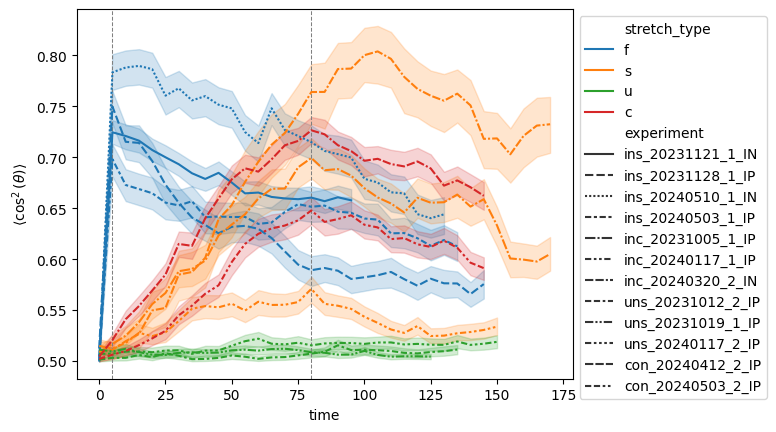

In [161]:

plt.axvline(5, linestyle='--', linewidth=0.75, color='grey')
plt.axvline(80, linestyle='--', linewidth=0.75, color='grey')
g=sns.lineplot(data=all_cells, x='time', y='order_all', hue='stretch_type',style='experiment', estimator='mean')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)
plt.ylabel(r"$\langle \cos^2(\theta)\rangle$")


plt.savefig(save_dir+'/total_order_experiment.png', dpi=300, bbox_inches='tight')


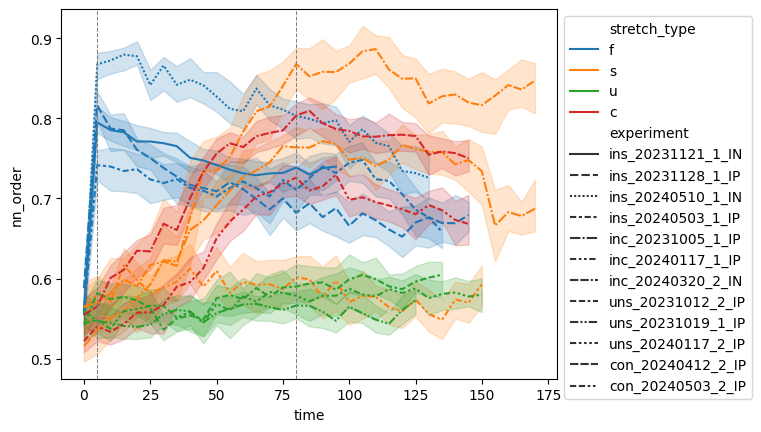

In [162]:
g=sns.lineplot(data=all_cells, x='time', y='nn_order', hue='stretch_type',style='experiment', estimator='median')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)
plt.axvline(5, linestyle='--', linewidth=0.75, color='grey')
plt.axvline(80, linestyle='--', linewidth=0.75, color='grey')
plt.savefig(save_dir+'/nn_order_experiment.png', dpi=300, bbox_inches='tight')


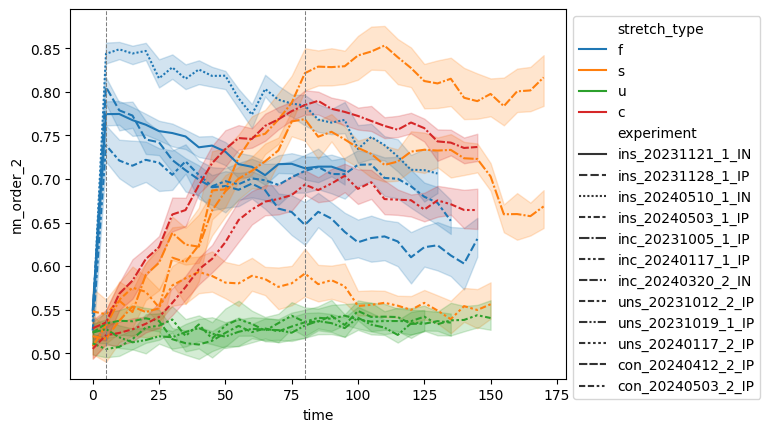

In [163]:
g=sns.lineplot(data=all_cells, x='time', y='nn_order_2', hue='stretch_type',style='experiment', estimator='median')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)
plt.axvline(5, linestyle='--', linewidth=0.75, color='grey')
plt.axvline(80, linestyle='--', linewidth=0.75, color='grey')
plt.savefig(save_dir+'/nn_order_2_order_experiment.png', dpi=300, bbox_inches='tight')


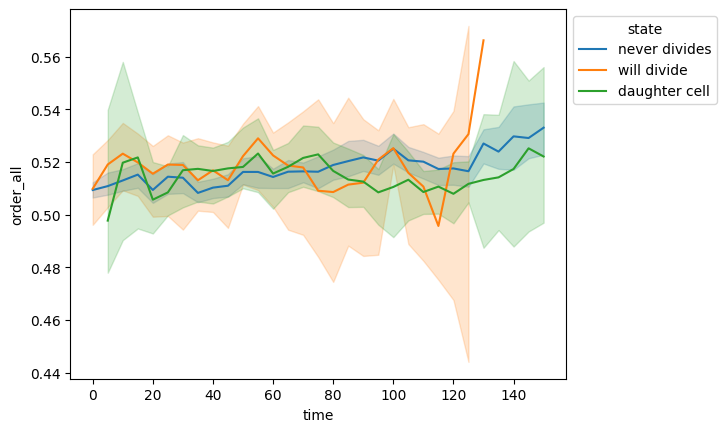

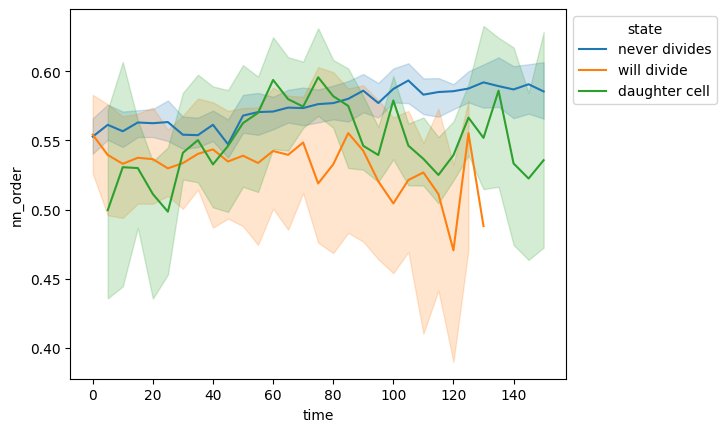

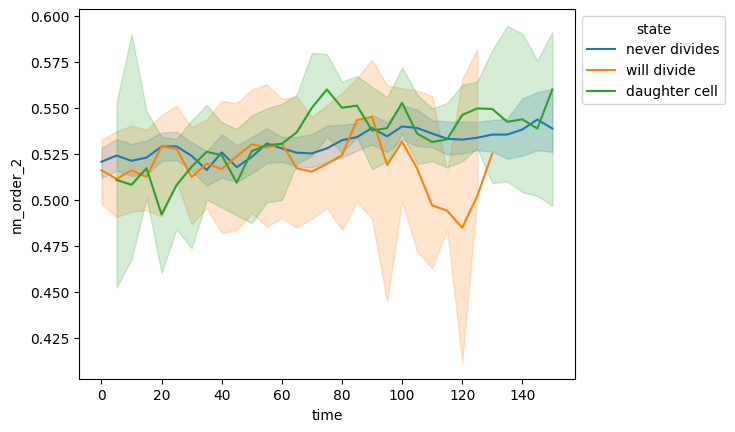

In [278]:
g=sns.lineplot(data=all_cells[all_cells.stretch_type=='u'], x='time', y='order_all', hue='state', estimator='median')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)
plt.show()
g=sns.lineplot(data=all_cells[all_cells.stretch_type=='u'], x='time', y='nn_order', hue='state', estimator='median')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)
plt.show()
g=sns.lineplot(data=all_cells[all_cells.stretch_type=='u'], x='time', y='nn_order_2', hue='state', estimator='median')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)
plt.show()

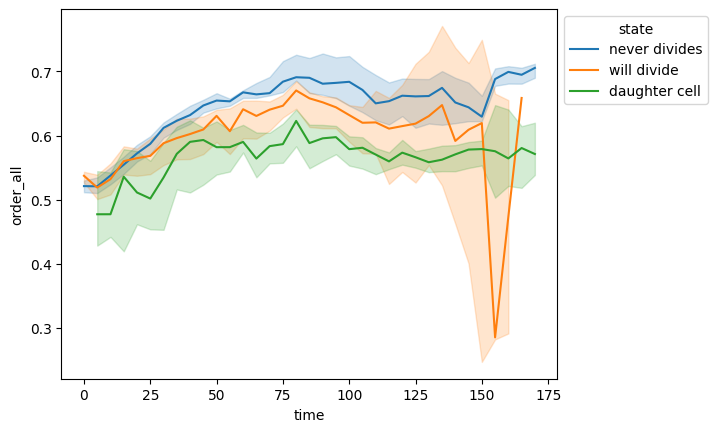

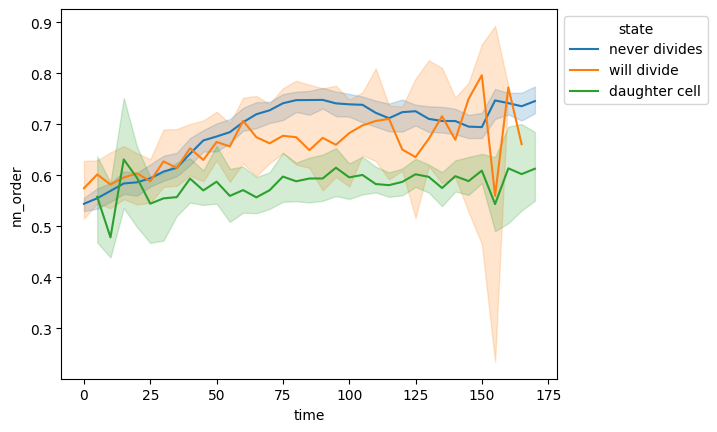

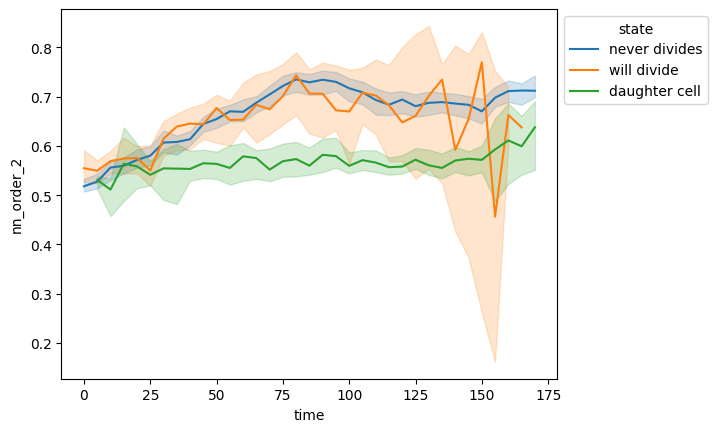

In [277]:
g=sns.lineplot(data=all_cells[all_cells.stretch_type=='s'], x='time', y='order_all', hue='state', estimator='median')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)
plt.show()

g=sns.lineplot(data=all_cells[all_cells.stretch_type=='s'], x='time', y='nn_order', hue='state', estimator='median')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)
plt.show()

g=sns.lineplot(data=all_cells[all_cells.stretch_type=='s'], x='time', y='nn_order_2', hue='state', estimator='median')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)
plt.show()

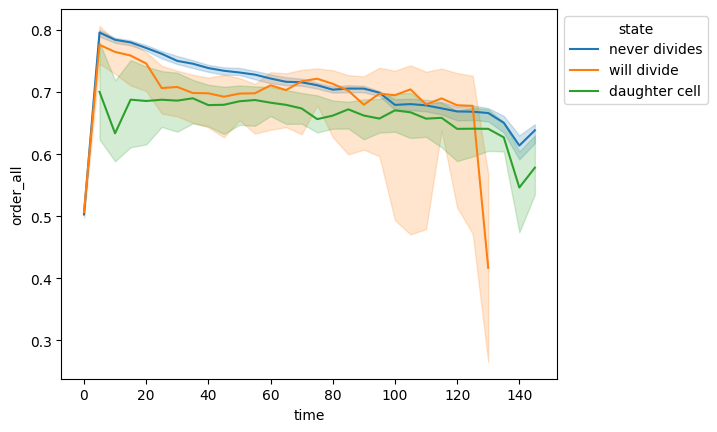

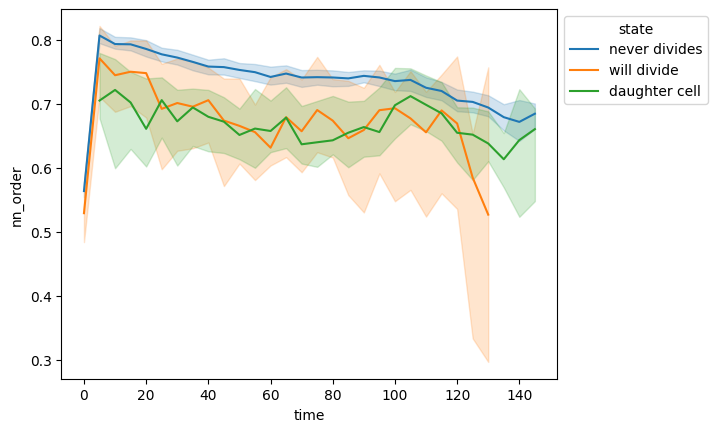

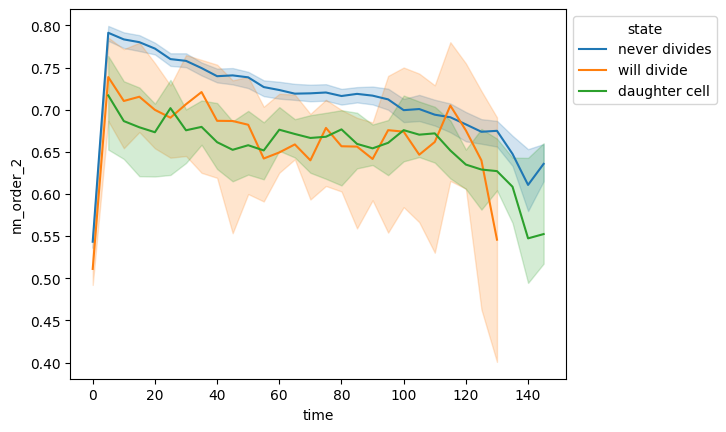

In [164]:
g=sns.lineplot(data=all_cells[all_cells.stretch_type=='f'], x='time', y='order_all', hue='state', estimator='median')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)
plt.show()
g=sns.lineplot(data=all_cells[all_cells.stretch_type=='f'], x='time', y='nn_order', hue='state', estimator='median')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)
plt.show()

g=sns.lineplot(data=all_cells[all_cells.stretch_type=='f'], x='time', y='nn_order_2', hue='state', estimator='median')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)
plt.show()

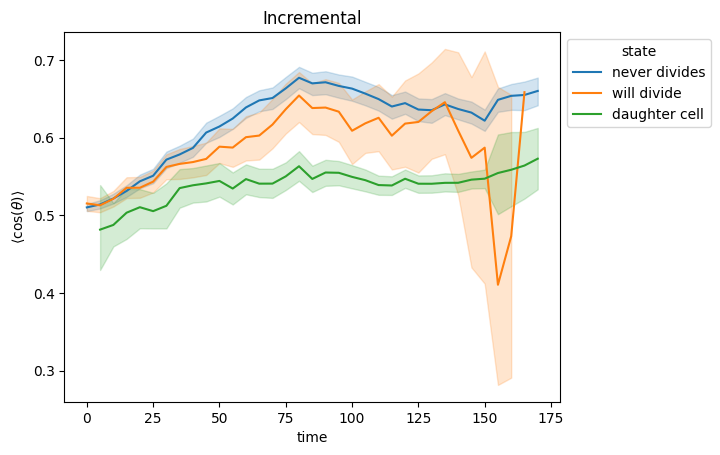

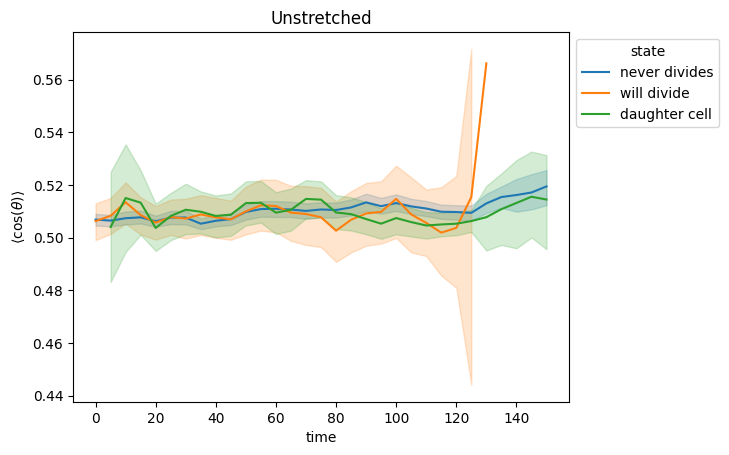

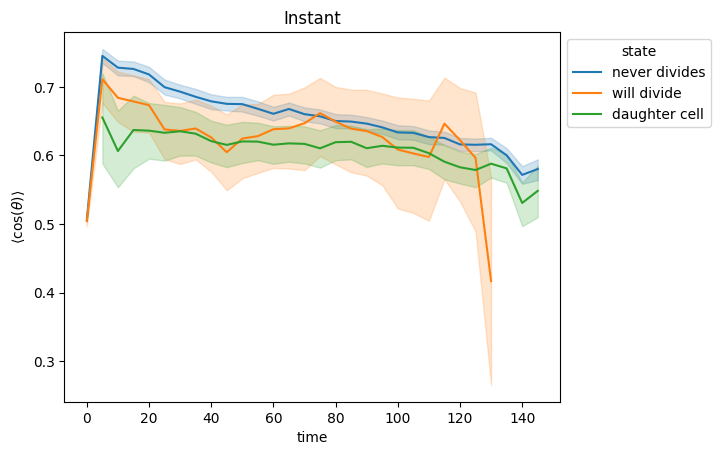

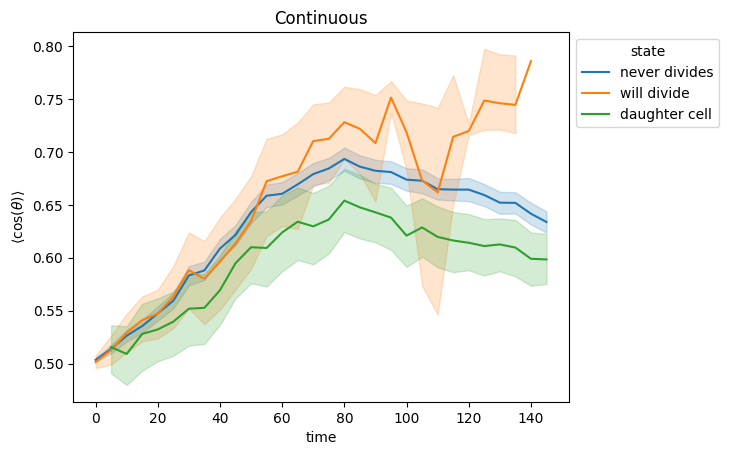

In [47]:
g=sns.lineplot(data=all_cells[all_cells.stretch_type=='s'], x='time', y='order_all', hue='state', estimator='mean')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)
plt.ylabel(r"$\langle \cos(\theta)\rangle$")
plt.title("Incremental")
plt.show()
g=sns.lineplot(data=all_cells[all_cells.stretch_type=='u'], x='time', y='order_all', hue='state', estimator='mean')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)
plt.ylabel(r"$\langle \cos(\theta)\rangle$")
plt.title("Unstretched")
plt.show()

g=sns.lineplot(data=all_cells[all_cells.stretch_type=='f'], x='time', y='order_all', hue='state', estimator='mean')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)
plt.ylabel(r"$\langle \cos(\theta)\rangle$")
plt.title("Instant")
plt.show()


g=sns.lineplot(data=all_cells[all_cells.stretch_type=='c'], x='time', y='order_all', hue='state', estimator='mean')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)
plt.ylabel(r"$\langle \cos(\theta)\rangle$")
plt.title("Continuous")
plt.show()

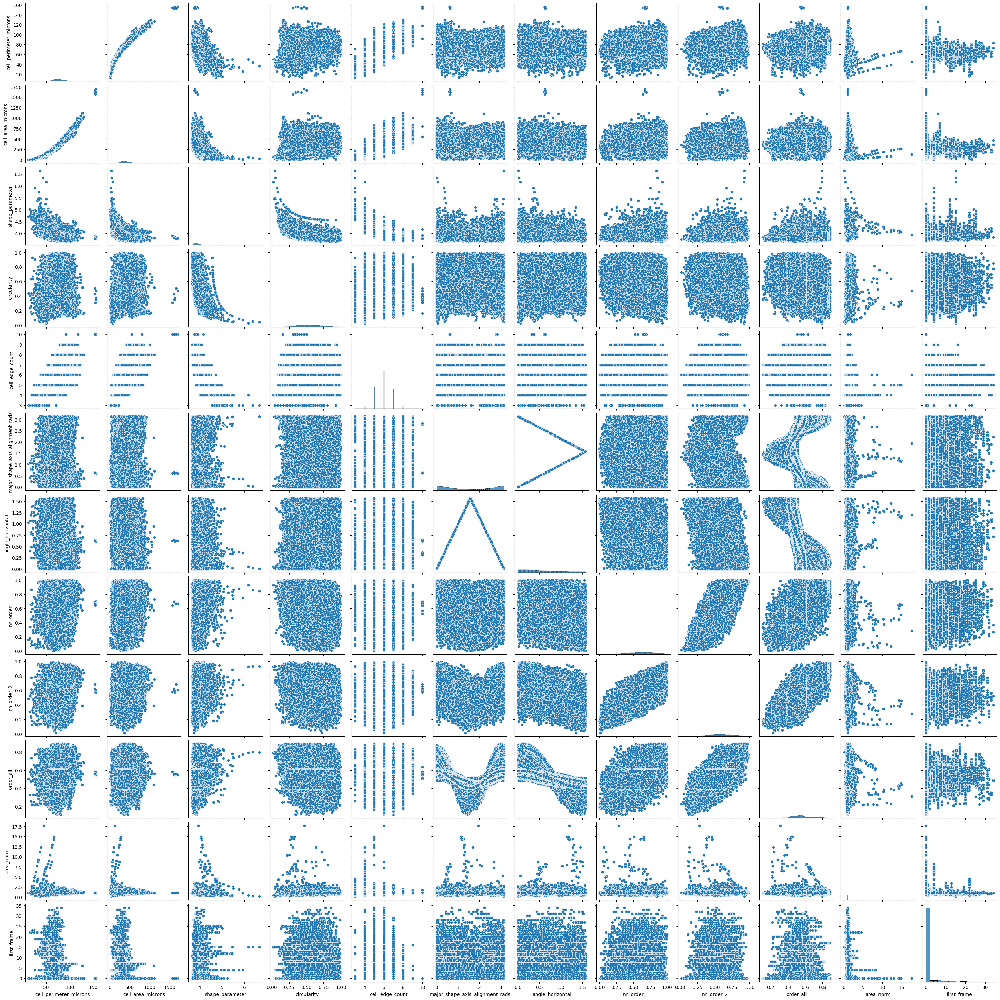

In [266]:
sns.pairplot(all_cells, vars=['cell_perimeter_microns', 'cell_area_microns',
       'shape_parameter', 'circularity', 'cell_edge_count',
       'major_shape_axis_alignment_rads',
       'angle_horizontal', 'nn_order', 'nn_order_2', 'order_all','area_norm', 'first_frame'])

In [280]:
sns.pairplot(all_cells,hue='stretch_type', vars=['cell_perimeter_microns', 'cell_area_microns',
       'shape_parameter', 'circularity', 'cell_edge_count',
       'major_shape_axis_alignment_rads',
       'angle_horizontal', 'nn_order', 'nn_order_2', 'order_all','area_norm', 'first_frame'])

In [81]:
all_cells.columns

Index(['cell_id_old', 'cell_perimeter_microns', 'cell_area_microns',
       'shape_parameter', 'circularity', 'cell_edge_count',
       'major_shape_axis_alignment_rads', 'cc_x', 'cc_y', 'cell_id_new',
       'spot_id', 'time', 'tm_frame', 'cell_perimeter_nd', 'cell_area_nd',
       'cell_P_eff_nd', 'cell_shear', 'cell_zeta',
       'major_stress_axis_alignment_rads', 'parent_id', 'divisions',
       'angle_horizontal', 'nn_order', 'nn_order_2', 'order_all', 'experiment',
       'stretch_type', 'state', 'area_norm', 'first_frame'],
      dtype='object')

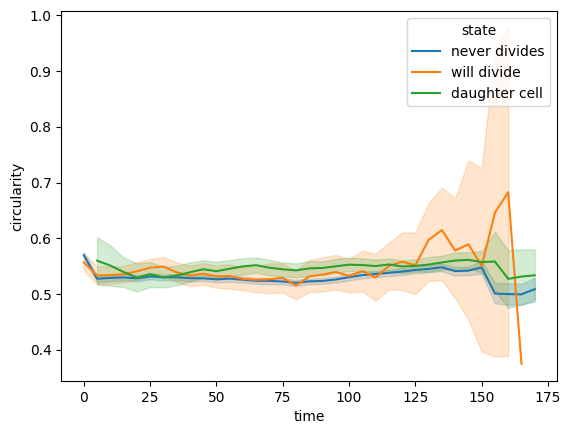

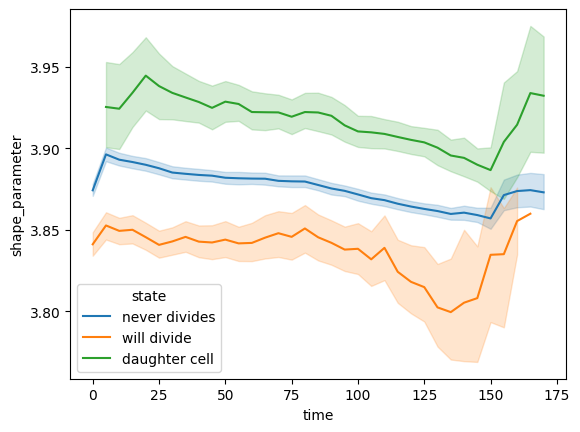

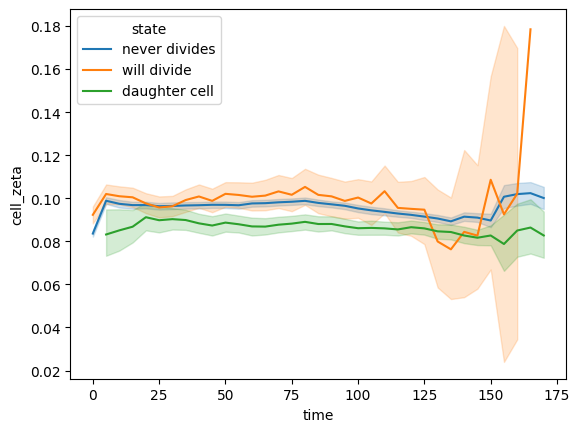

<AxesSubplot: xlabel='time', ylabel='cell_shear'>

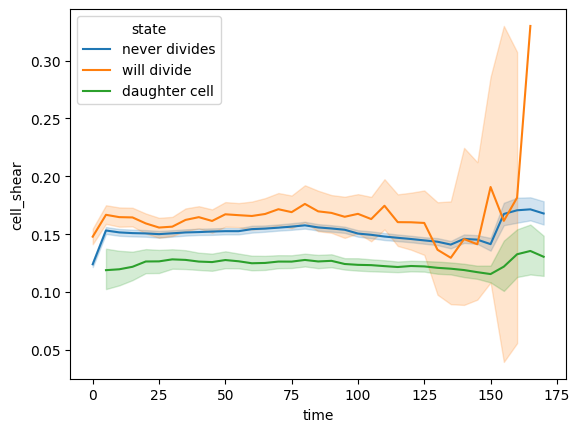

In [166]:
sns.lineplot(data=all_cells, x='time', y='circularity', hue='state')

plt.show()
sns.lineplot(data=all_cells, x='time', y='shape_parameter', hue='state')

plt.show()
sns.lineplot(data=all_cells, x='time', y='cell_zeta', hue='state')
plt.show()

sns.lineplot(data=all_cells, x='time', y='cell_shear', hue='state')




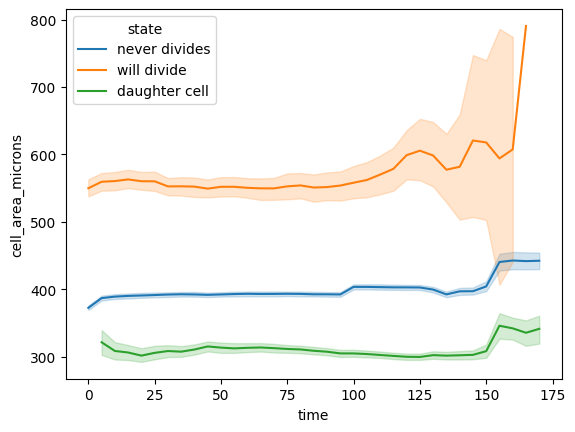

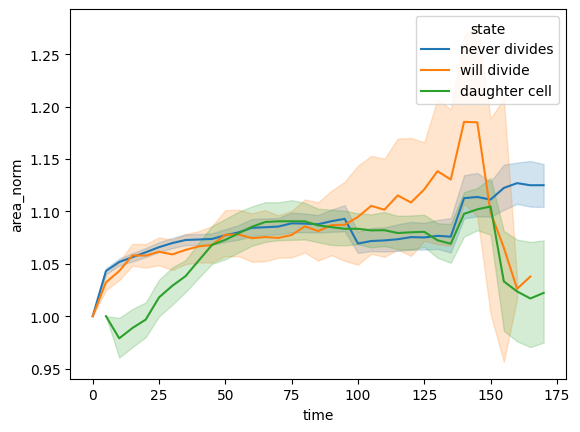

<AxesSubplot: xlabel='time', ylabel='area_norm_mean'>

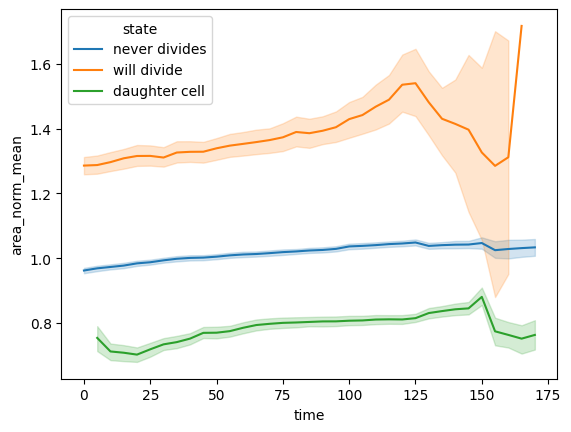

In [167]:
sns.lineplot(data=all_cells, x='time', y='cell_area_microns', hue='state')

plt.show()
sns.lineplot(data=all_cells, x='time', y='area_norm', hue='state')

plt.show()
sns.lineplot(data=all_cells, x='time', y='area_norm_mean', hue='state')



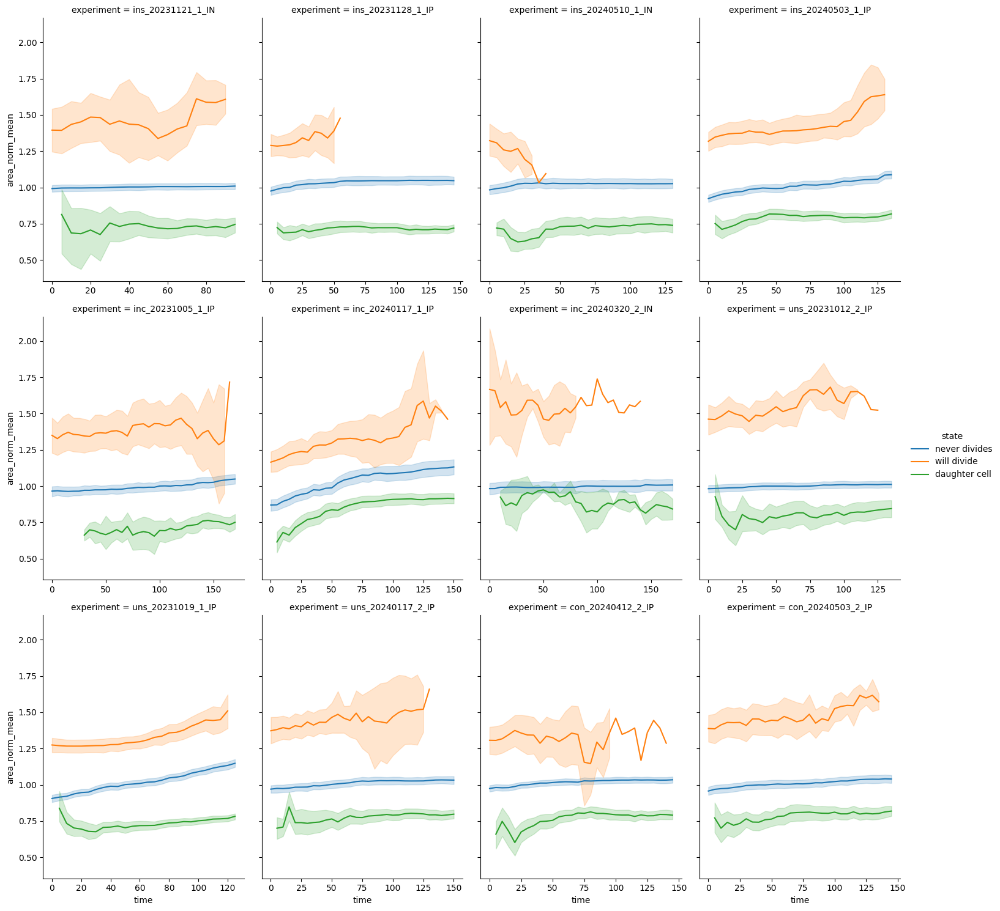

In [168]:
sns.relplot(
    data=all_cells,
    x="time", y="area_norm_mean",
    hue="state",col="experiment",
    kind="line",
    height=5, aspect=.75,col_wrap=4, facet_kws=dict(sharex=False),
)

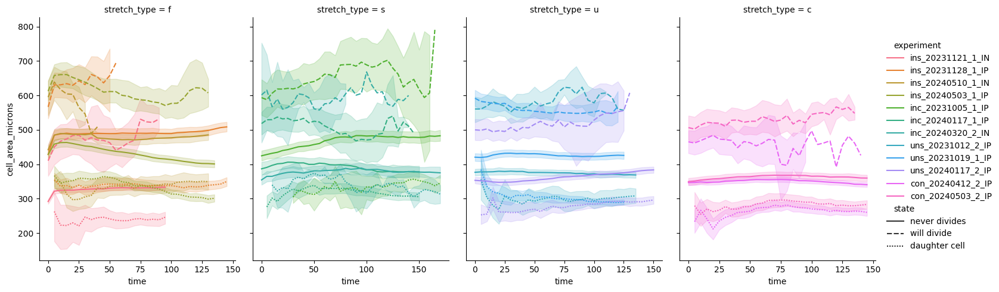

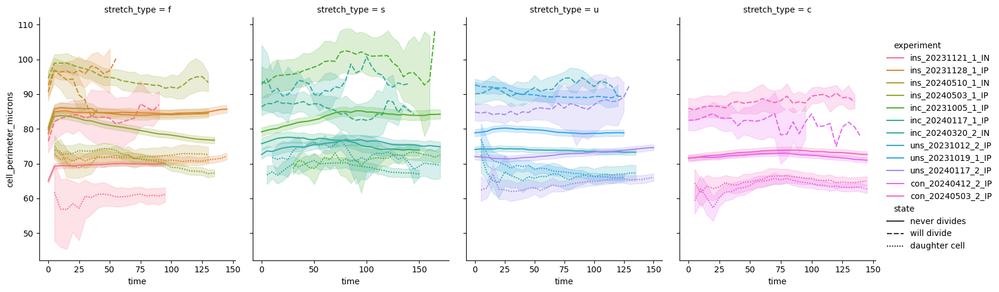

In [456]:
sns.relplot(
    data=all_cells,
    x="time", y="cell_area_microns",
    hue="experiment", style='state',col="stretch_type",
    kind="line",
    height=5, aspect=.75,col_wrap=4, facet_kws=dict(sharex=False),
)

sns.relplot(
    data=all_cells,
    x="time", y="cell_perimeter_microns",
    hue="experiment", style='state',col="stretch_type",
    kind="line",
    height=5, aspect=.75,col_wrap=4, facet_kws=dict(sharex=False),
)

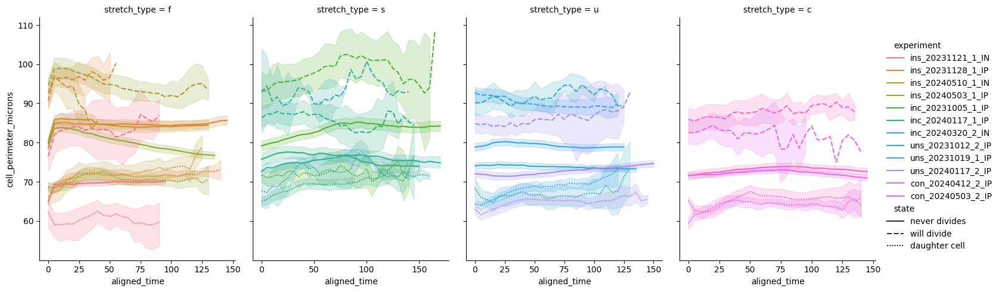

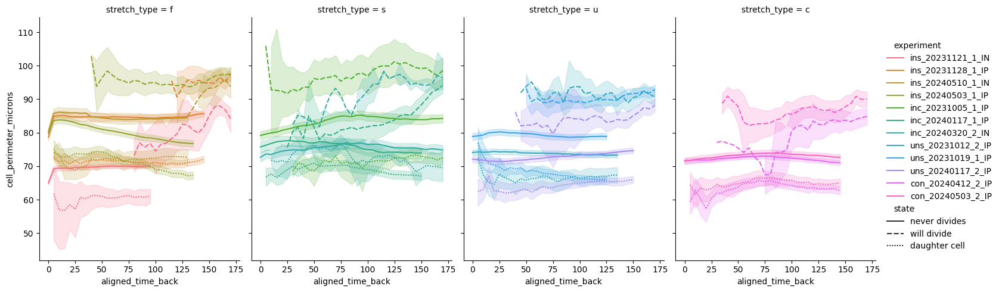

In [457]:
sns.relplot(
    data=all_cells,
    x="aligned_time", y="cell_perimeter_microns",
    hue="experiment", style='state',col="stretch_type",
    kind="line",
    height=5, aspect=.75,col_wrap=4, facet_kws=dict(sharex=False),
)

sns.relplot(
    data=all_cells,
    x="aligned_time_back", y="cell_perimeter_microns",
    hue="experiment", style='state',col="stretch_type",
    kind="line",
    height=5, aspect=.75,col_wrap=4, facet_kws=dict(sharex=False),
)

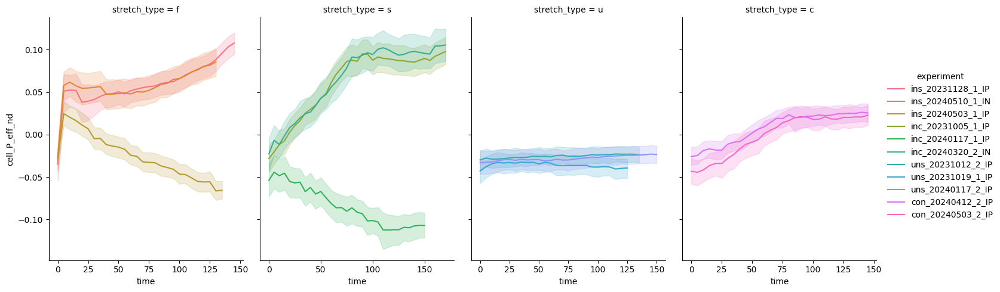

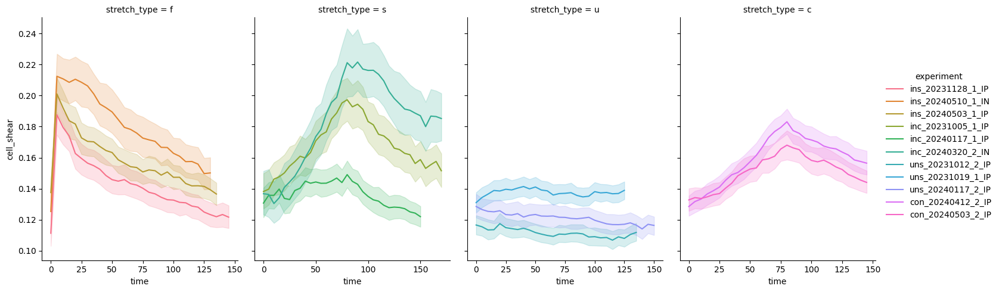

In [48]:
all_cells.columns

sns.relplot(
    data=all_cells,
    x="time", y="cell_P_eff_nd",
    hue="experiment",col="stretch_type",
    kind="line",
    height=5, aspect=.75,col_wrap=4, facet_kws=dict(sharex=False),
)


sns.relplot(
    data=all_cells,
    x="time", y="cell_shear",
    hue="experiment",col="stretch_type",
    kind="line",
    height=5, aspect=.75,col_wrap=4, facet_kws=dict(sharex=False),
)

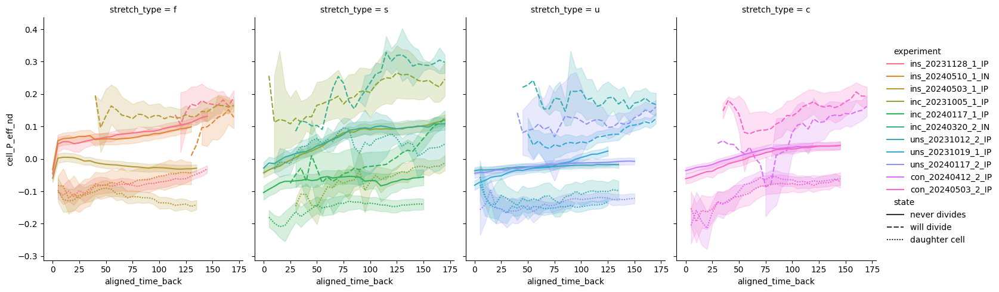

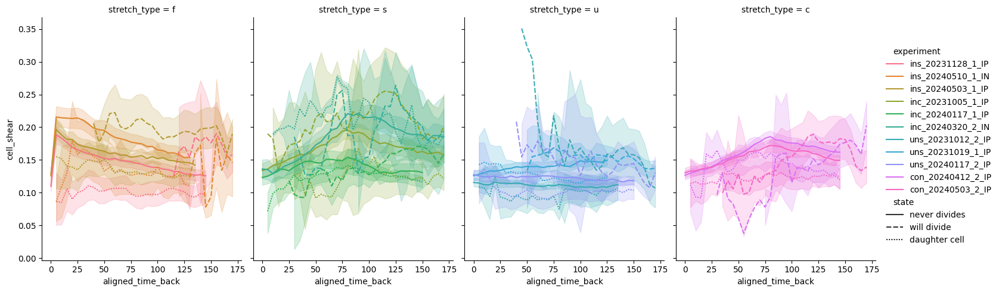

In [49]:
sns.relplot(
    data=all_cells,
    x="aligned_time_back", y="cell_P_eff_nd",
    hue="experiment",style='state',col="stretch_type",
    kind="line",
    height=5, aspect=.75,col_wrap=4, facet_kws=dict(sharex=False),
)


sns.relplot(
    data=all_cells,
    x="aligned_time_back", y="cell_shear",
    hue="experiment",style='state',col="stretch_type",
    kind="line",
    height=5, aspect=.75,col_wrap=4, facet_kws=dict(sharex=False),
)

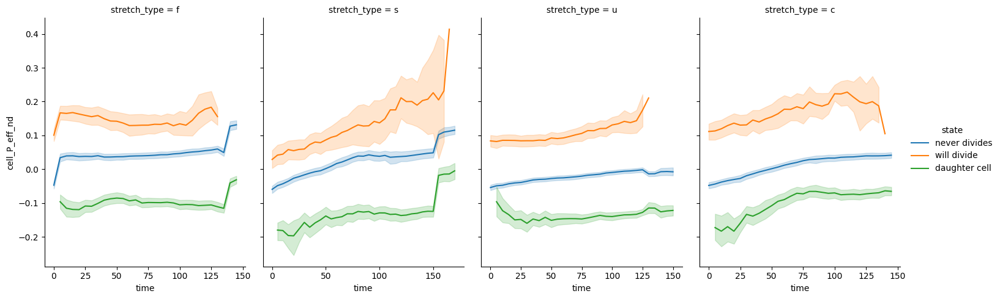

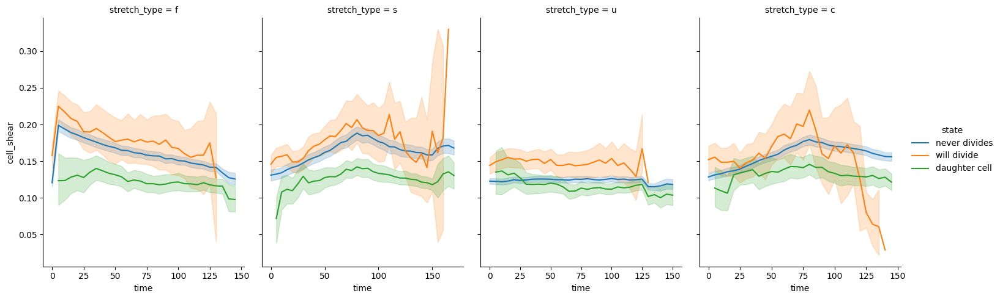

In [50]:
sns.relplot(
    data=all_cells,
    x="time", y="cell_P_eff_nd",
    hue='state',col="stretch_type",
    kind="line",
    height=5, aspect=.75,col_wrap=4, facet_kws=dict(sharex=False),
)


sns.relplot(
    data=all_cells,
    x="time", y="cell_shear",
    hue='state',col="stretch_type",
    kind="line",
    height=5, aspect=.75,col_wrap=4, facet_kws=dict(sharex=False),
)

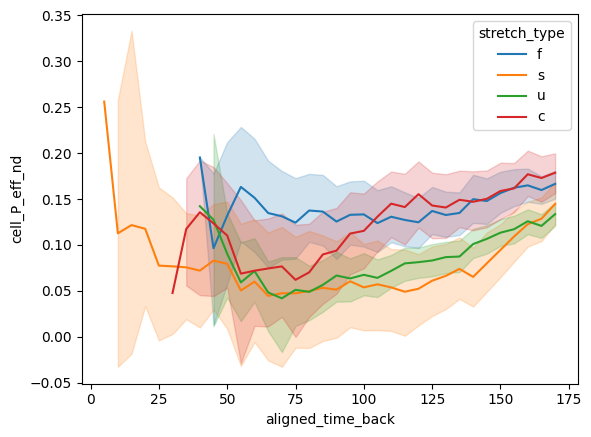

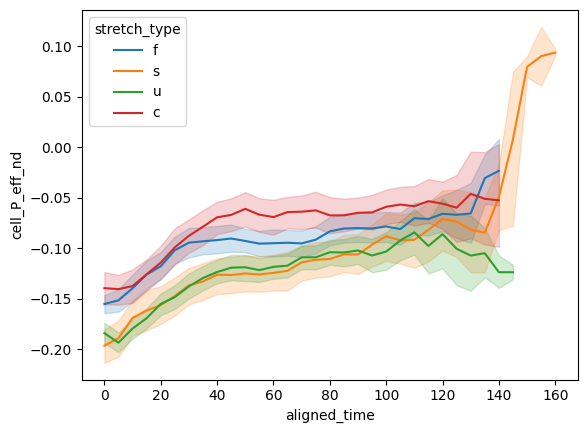

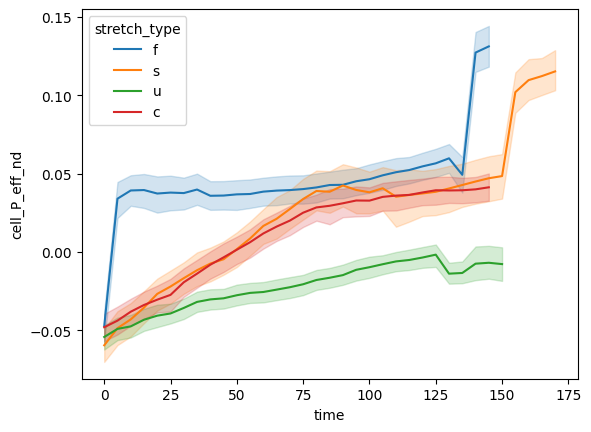

In [51]:
sns.lineplot(all_cells[all_cells.state=='will divide'], x='aligned_time_back', y='cell_P_eff_nd', hue='stretch_type')
plt.show()
sns.lineplot(all_cells[all_cells.state=='daughter cell'], x='aligned_time', y='cell_P_eff_nd', hue='stretch_type')
plt.show()

sns.lineplot(all_cells[all_cells.state=='never divides'], x='time', y='cell_P_eff_nd', hue='stretch_type')
plt.show()

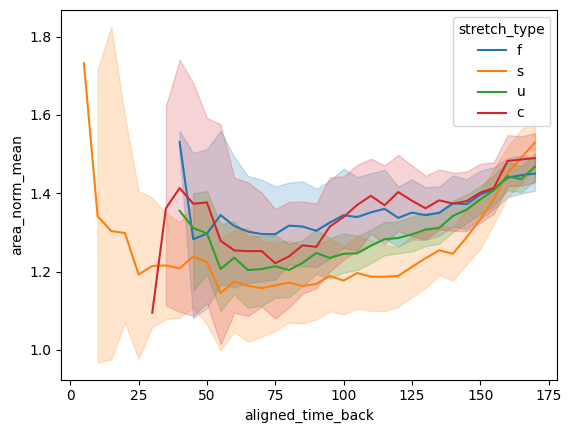

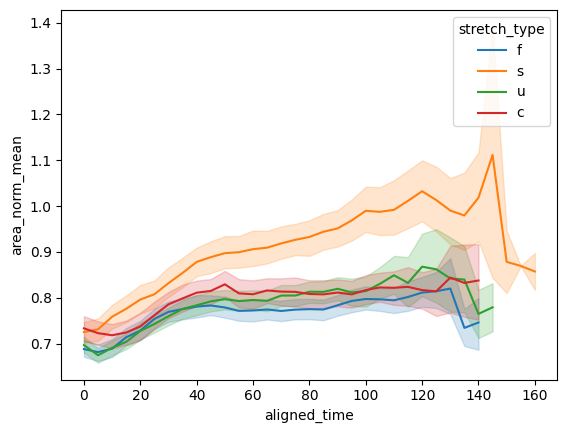

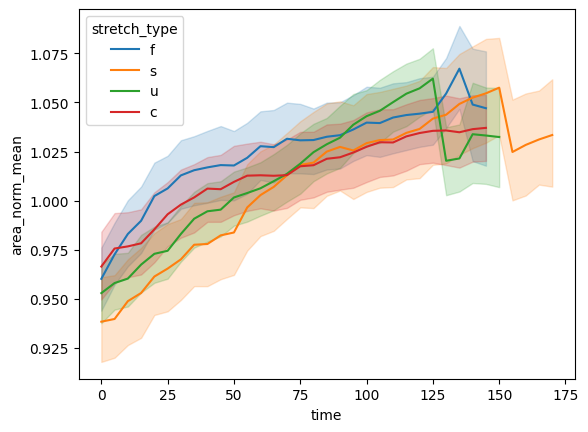

In [65]:
sns.lineplot(all_cells[all_cells.state=='will divide'], x='aligned_time_back', y='area_norm_mean', hue='stretch_type')
plt.show()
sns.lineplot(all_cells[all_cells.state=='daughter cell'], x='aligned_time', y='area_norm_mean', hue='stretch_type')
plt.show()

sns.lineplot(all_cells[all_cells.state=='never divides'], x='time', y='area_norm_mean', hue='stretch_type')
plt.show()

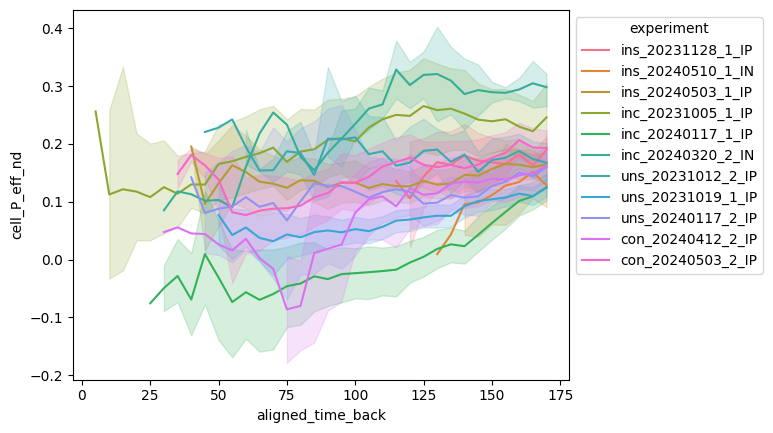

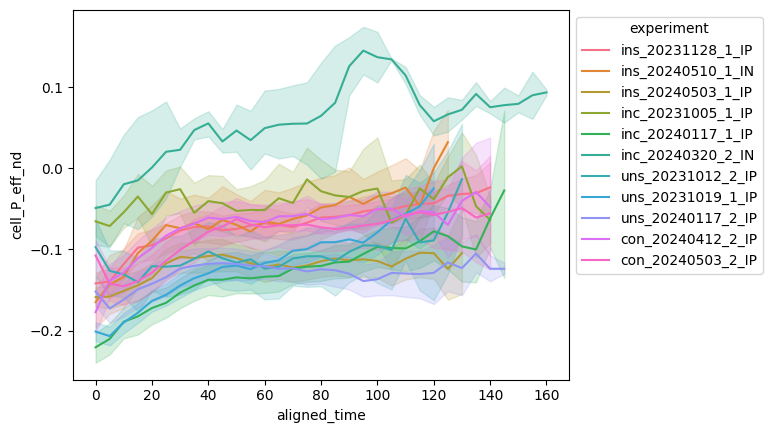

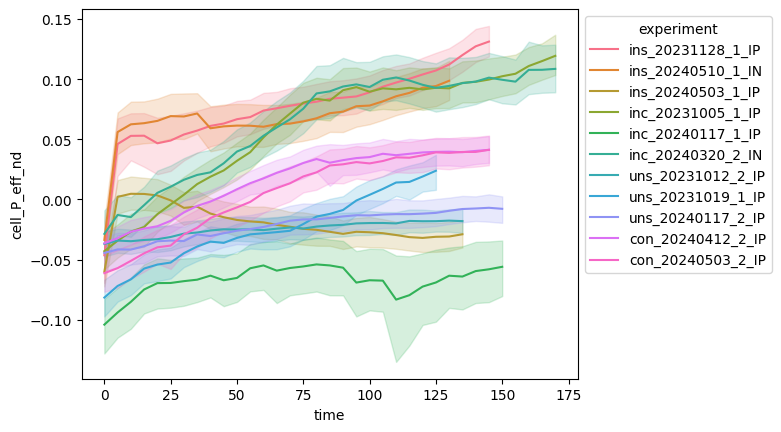

In [52]:
g=sns.lineplot(all_cells[all_cells.state=='will divide'], x='aligned_time_back', y='cell_P_eff_nd', hue='experiment')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)

plt.show()
g=sns.lineplot(all_cells[all_cells.state=='daughter cell'], x='aligned_time', y='cell_P_eff_nd', hue='experiment')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)

plt.show()

g=sns.lineplot(all_cells[all_cells.state=='never divides'], x='time', y='cell_P_eff_nd', hue='experiment')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)

plt.show()

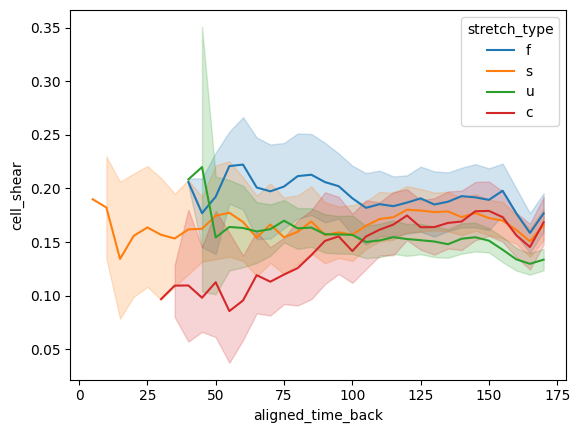

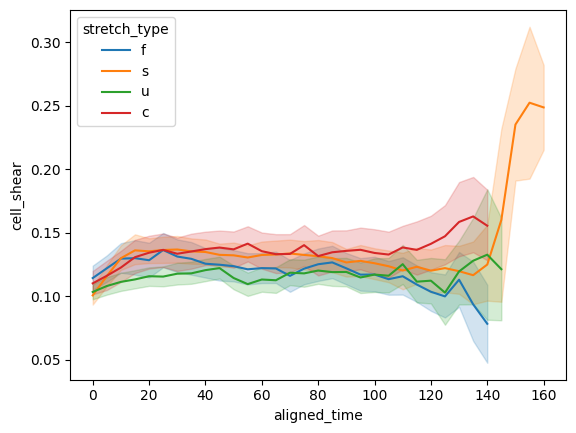

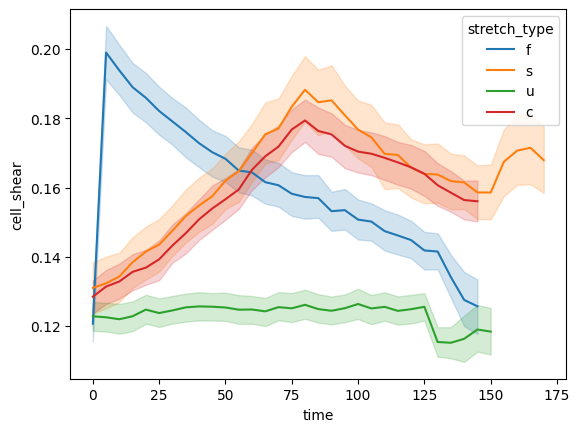

In [53]:
sns.lineplot(all_cells[all_cells.state=='will divide'], x='aligned_time_back', y='cell_shear', hue='stretch_type')
plt.show()
sns.lineplot(all_cells[all_cells.state=='daughter cell'], x='aligned_time', y='cell_shear', hue='stretch_type')
plt.show()

sns.lineplot(all_cells[all_cells.state=='never divides'], x='time', y='cell_shear', hue='stretch_type')
plt.show()

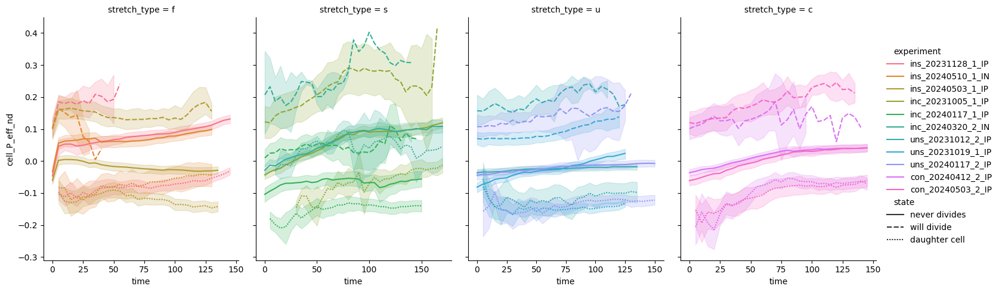

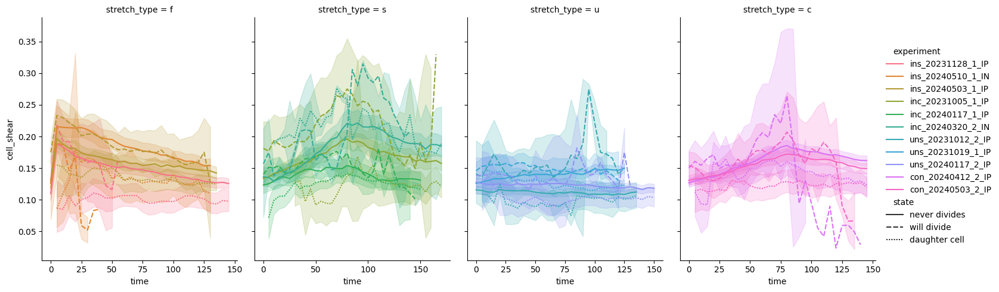

In [54]:
sns.relplot(
    data=all_cells,
    x="time", y="cell_P_eff_nd",
    hue="experiment",style='state',col="stretch_type",
    kind="line",
    height=5, aspect=.75,col_wrap=4, facet_kws=dict(sharex=False),
)


sns.relplot(
    data=all_cells,
    x="time", y="cell_shear",
    hue="experiment",style='state',col="stretch_type",
    kind="line",
    height=5, aspect=.75,col_wrap=4, facet_kws=dict(sharex=False),
)

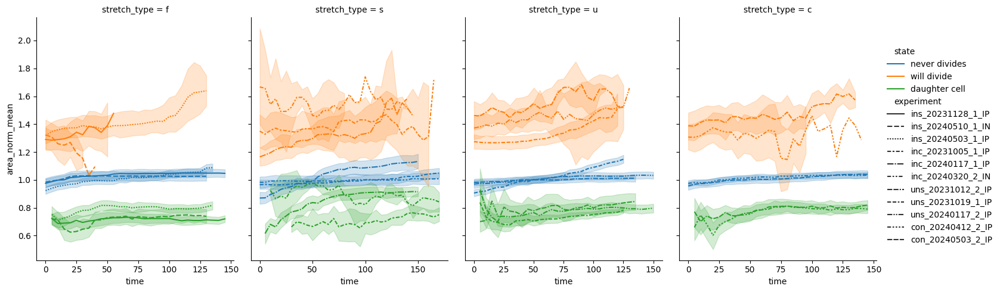

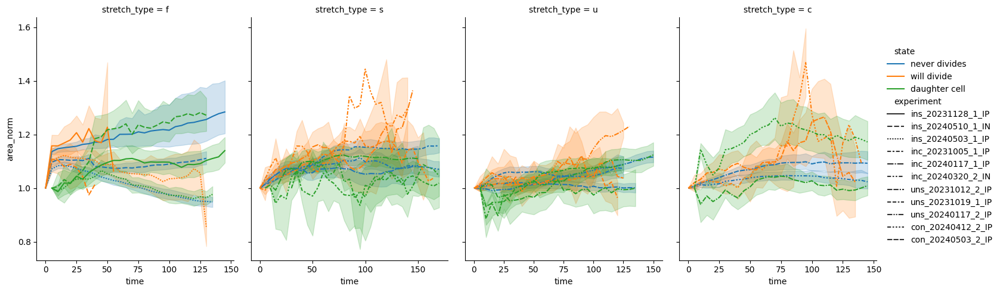

In [55]:
sns.relplot(
    data=all_cells,
    x="time", y="area_norm_mean",
    hue="state", style='experiment',col="stretch_type",
    kind="line",
    height=5, aspect=.75,col_wrap=4, facet_kws=dict(sharex=False),
)

sns.relplot(
    data=all_cells,
    x="time", y="area_norm",
    hue="state", style='experiment',col="stretch_type",
    kind="line",
    height=5, aspect=.75,col_wrap=4, facet_kws=dict(sharex=False),
)

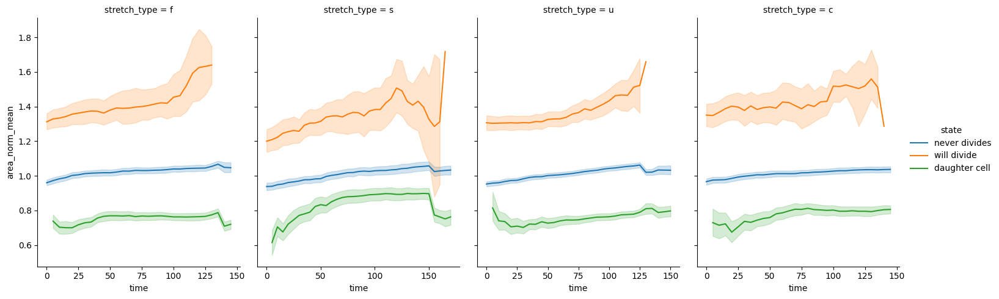

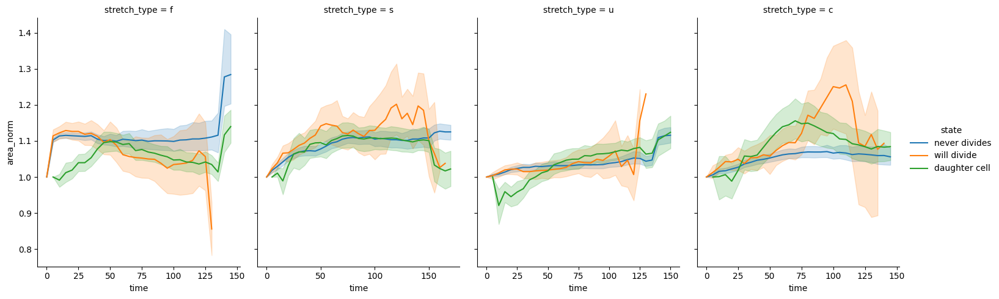

In [56]:
sns.relplot(
    data=all_cells,
    x="time", y="area_norm_mean",
    hue="state",col="stretch_type",
    kind="line",
    height=5, aspect=.75,col_wrap=4, facet_kws=dict(sharex=False),
)

sns.relplot(
    data=all_cells,
    x="time", y="area_norm",
    hue="state",col="stretch_type",
    kind="line",
    height=5, aspect=.75,col_wrap=4, facet_kws=dict(sharex=False),
)

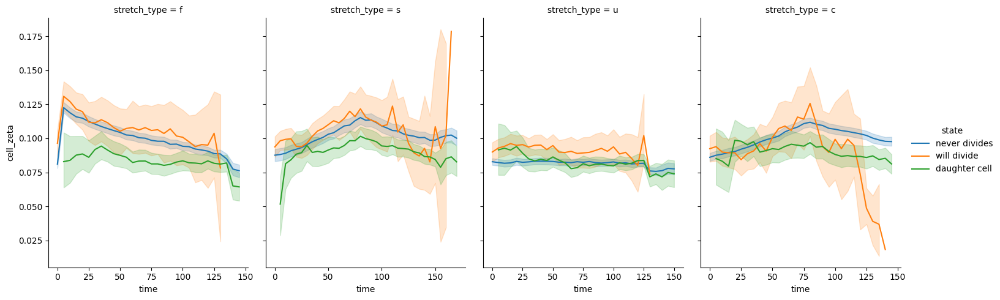

In [57]:
sns.relplot(
    data=all_cells,
    x="time", y="cell_zeta",
    hue="state",col="stretch_type",
    kind="line",
    height=5, aspect=.75,col_wrap=4, facet_kws=dict(sharex=False),
)

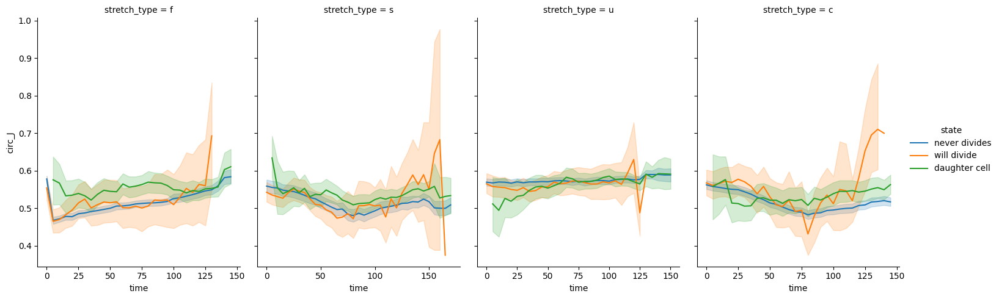

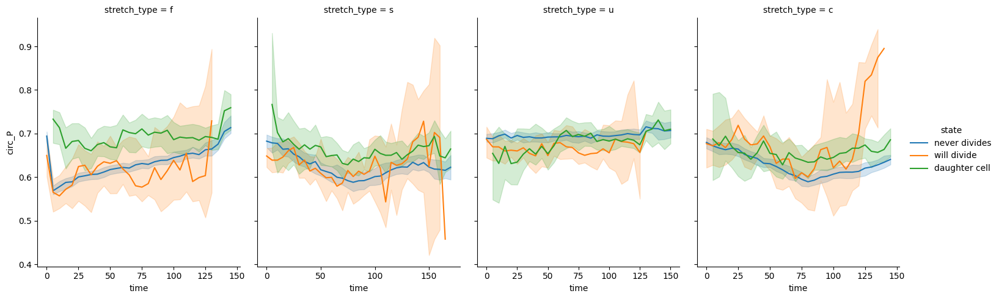

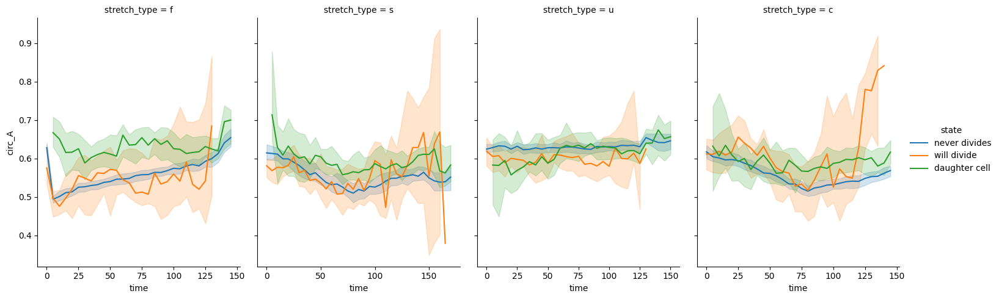

In [172]:
sns.relplot(
    data=all_cells,
    x="time", y="circ_J",
    hue="state",col="stretch_type",
    kind="line",
    height=5, aspect=.75,col_wrap=4, facet_kws=dict(sharex=False),
)
plt.show()
sns.relplot(
    data=all_cells,
    x="time", y="circ_P",
    hue="state",col="stretch_type", estimator='median',
    kind="line",
    height=5, aspect=.75,col_wrap=4, facet_kws=dict(sharex=False),
)
plt.show()
sns.relplot(
    data=all_cells,
    x="time", y="circ_A",
    hue="state",col="stretch_type", estimator='median',
    kind="line",
    height=5, aspect=.75,col_wrap=4, facet_kws=dict(sharex=False),
)

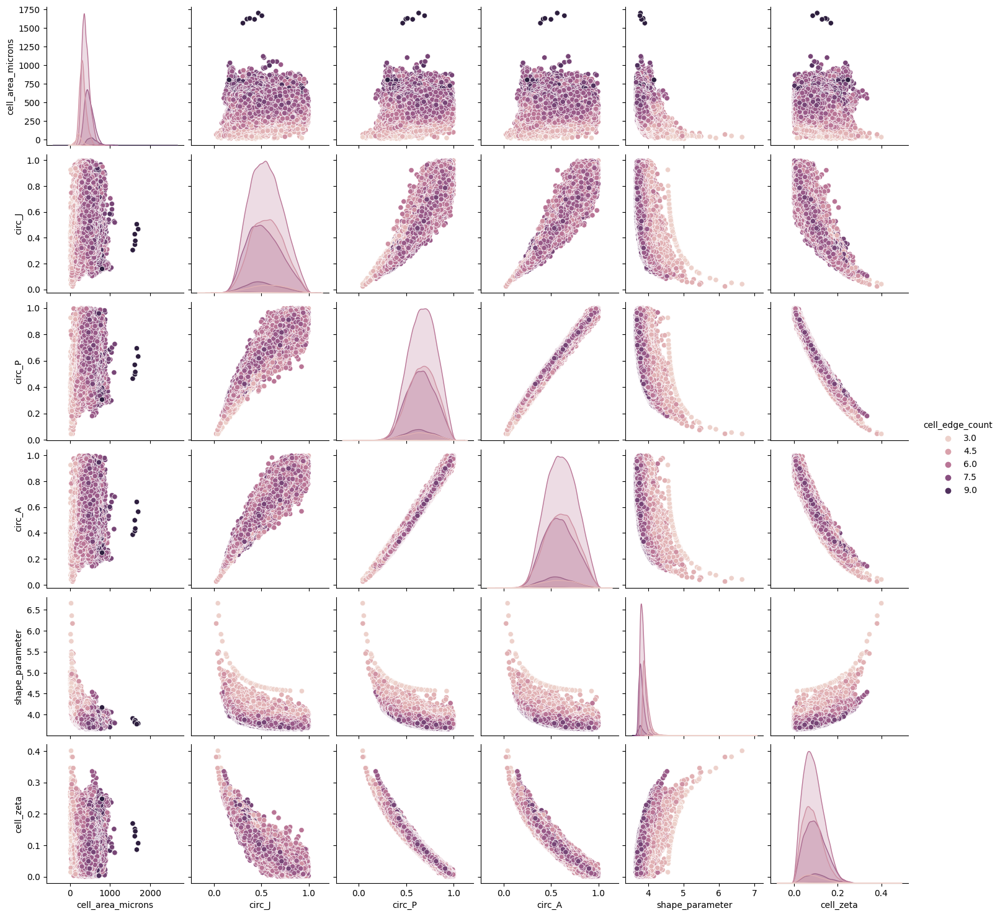

In [139]:
sns.pairplot(all_cells, vars=['cell_area_microns', 'circ_J', 'circ_P', 'circ_A', 'shape_parameter', 'cell_zeta'], hue='cell_edge_count')

In [140]:
sns.pairplot(all_cells, vars=['cell_area_microns', 'circ_J', 'circ_P', 'circ_A', 'shape_parameter', 'cell_zeta'], hue='state', plot_kws={"s":5})

In [ ]:
sns.pairplot(all_cells, vars=['cell_area_microns', 'shape_axis_J', 'shape_axis_P', 'shape_axis_A', 'shape_parameter', 'cell_zeta'], hue='state', plot_kws={"s":5})

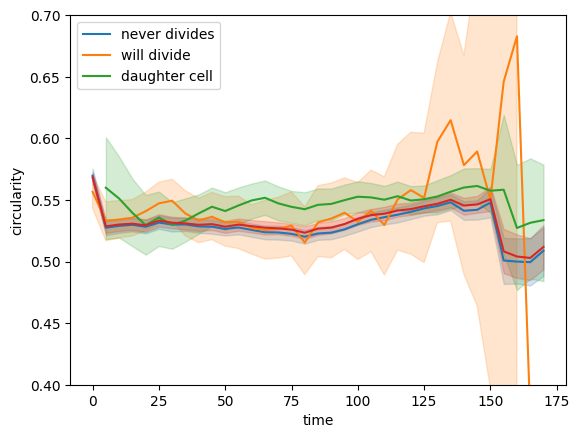

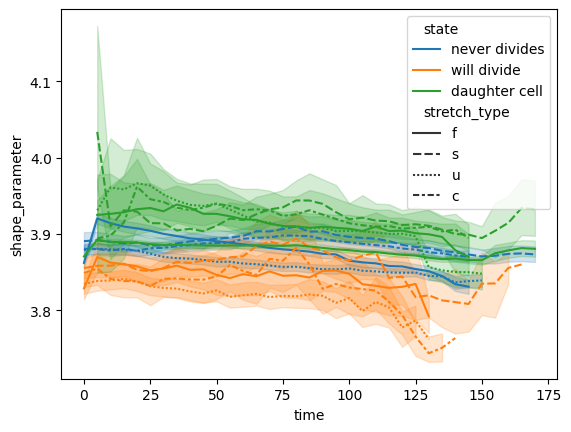

In [173]:
sns.lineplot(data=all_cells, x='time', y='circularity', hue='state')
sns.lineplot(data=all_cells, x='time', y='circularity')
plt.ylim(0.4, 0.7)
plt.show()
sns.lineplot(data=all_cells, x='time', y='shape_parameter', hue='state', style='stretch_type')
sns.lineplot(data=all_cells, x='time', y='shape_parameter')
plt.show()



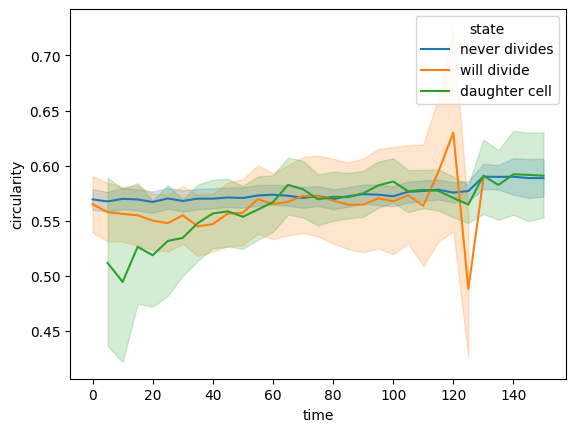

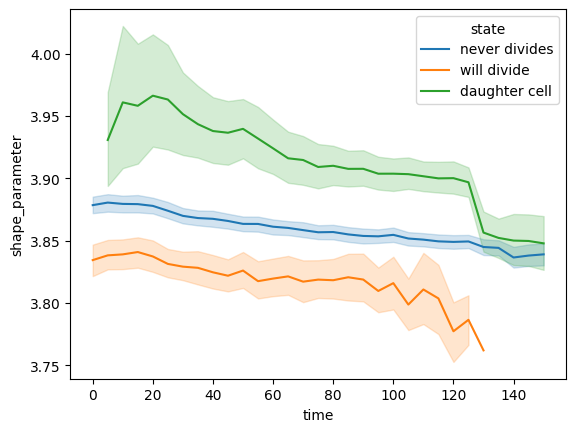

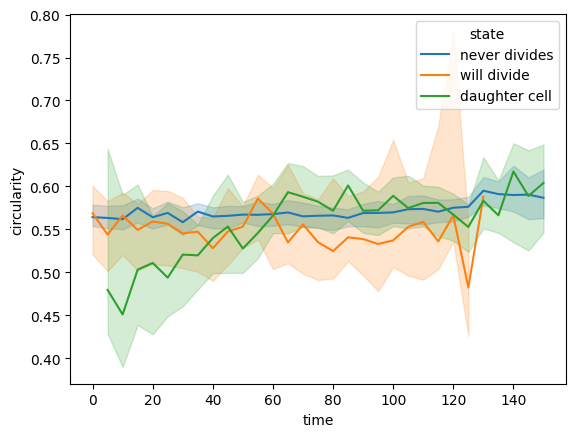

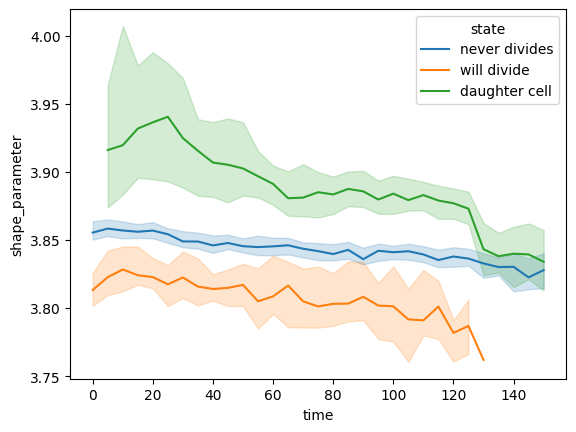

In [174]:
sns.lineplot(data=all_cells[all_cells.stretch_type=='u'], x='time', y='circularity', hue='state')
#plt.ylim(0.4, 0.7)
plt.show()
sns.lineplot(data=all_cells[all_cells.stretch_type=='u'], x='time', y='shape_parameter', hue='state')
plt.show()


#medians

sns.lineplot(data=all_cells[all_cells.stretch_type=='u'], x='time', y='circularity', hue='state', estimator='median')
#plt.ylim(0.4, 0.7)
plt.show()
sns.lineplot(data=all_cells[all_cells.stretch_type=='u'], x='time', y='shape_parameter', hue='state', estimator='median')
plt.show()


<AxesSubplot: xlabel='cell_area_microns', ylabel='circularity'>

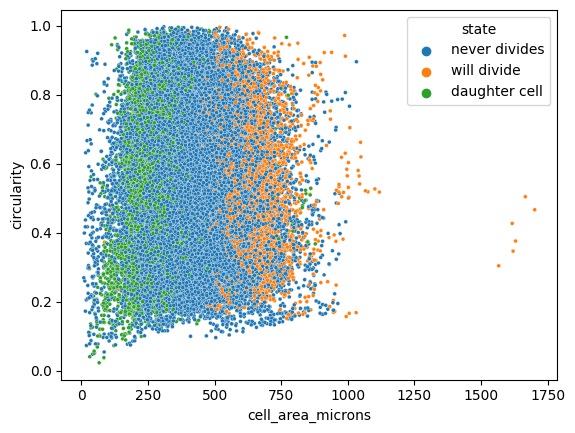

In [63]:
sns.scatterplot(all_cells, x='cell_area_microns', y='circularity', hue='state', s=8)

In [27]:
all_cells.columns

Index(['index', 'cell_id_old', 'cell_perimeter_microns', 'cell_area_microns',
       'shape_parameter', 'circularity', 'cell_edge_count',
       'major_shape_axis_alignment_rads', 'cc_x', 'cc_y', 'cell_id_new',
       'spot_id', 'time', 'tm_frame', 'cell_perimeter_nd', 'cell_area_nd',
       'cell_P_eff_nd', 'cell_shear', 'cell_zeta',
       'major_stress_axis_alignment_rads', 'parent_id', 'divisions',
       'angle_horizontal', 'circ_J', 'circ_P', 'circ_A', 'shape_axis_J',
       'shape_axis_P', 'shape_axis_A', 'nn_order', 'nn_order_2', 'order_all',
       'mean_cc_distance', 'mean_cc_distance_2', 'experiment', 'stretch_type',
       'state', 'area_norm', 'perimeter_norm', 'first_frame', 'last_frame',
       'area_norm_mean', 'area_norm_last', 'circ_norm', 'circ_norm_last',
       'aligned_time', 'aligned_time_back'],
      dtype='object')

C:\Users\v35431nc\AppData\Local\Temp\ipykernel_37512\2268685296.py:3: UserWarning: The palette list has more values (33) than needed (23), which may not be intended.
  g=sns.scatterplot(all_cells[(all_cells.time==0)&(all_cells.stretch_type=='f')&(all_cells.state=='will divide')], x='cell_area_microns', y='circularity', ax=ax[0,0],s=8, hue='last_frame', palette=sns.color_palette("rainbow",33), legend=False)
C:\Users\v35431nc\AppData\Local\Temp\ipykernel_37512\2268685296.py:7: UserWarning: 
The palette list has fewer values (33) than needed (34) and will cycle, which may produce an uninterpretable plot.
  g=sns.scatterplot(all_cells[(all_cells.time==0)&(all_cells.stretch_type=='s')&(all_cells.state=='will divide')], x='cell_area_microns', y='circularity', ax=ax[0,1],s=8, hue='last_frame', palette=sns.color_palette("rainbow",33), legend=False)
C:\Users\v35431nc\AppData\Local\Temp\ipykernel_37512\2268685296.py:12: UserWarning: The palette list has more values (33) than needed (26), which m

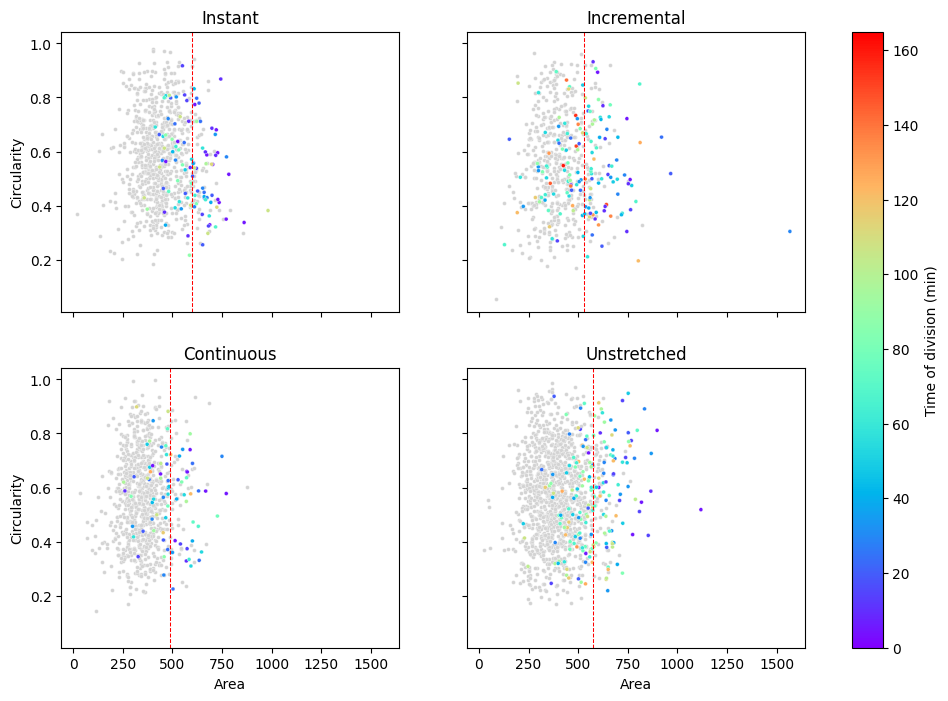

In [181]:
fig, ax=plt.subplots(2,2, sharey=True, sharex=True, figsize=(12,8))
sns.scatterplot(all_cells[(all_cells.time==0)&(all_cells.stretch_type=='f')&(all_cells.state=='never divides')], x='cell_area_microns', y='circularity', ax=ax[0,0],s=8, c='lightgrey')
g=sns.scatterplot(all_cells[(all_cells.time==0)&(all_cells.stretch_type=='f')&(all_cells.state=='will divide')], x='cell_area_microns', y='circularity', ax=ax[0,0],s=8, hue='last_frame', palette=sns.color_palette("rainbow",33), legend=False)
ax[0,0].set_title("Instant")

sns.scatterplot(all_cells[(all_cells.time==0)&(all_cells.stretch_type=='s')&(all_cells.state=='never divides')], x='cell_area_microns', y='circularity', ax=ax[0,1],s=8, c='lightgrey')
g=sns.scatterplot(all_cells[(all_cells.time==0)&(all_cells.stretch_type=='s')&(all_cells.state=='will divide')], x='cell_area_microns', y='circularity', ax=ax[0,1],s=8, hue='last_frame', palette=sns.color_palette("rainbow",33), legend=False)
ax[0,1].set_title("Incremental")


sns.scatterplot(all_cells[(all_cells.time==0)&(all_cells.stretch_type=='c')&(all_cells.state=='never divides')], x='cell_area_microns', y='circularity', ax=ax[1,0], s=8, c='lightgrey')
g=sns.scatterplot(all_cells[(all_cells.time==0)&(all_cells.stretch_type=='c')&(all_cells.state=='will divide')], x='cell_area_microns', y='circularity', ax=ax[1,0],s=8, hue='last_frame', palette=sns.color_palette("rainbow",33), legend=False)
ax[1,0].set_title("Continuous")


sns.scatterplot(all_cells[(all_cells.time==0)&(all_cells.stretch_type=='u')&(all_cells.state=='never divides')], x='cell_area_microns', y='circularity', ax=ax[1,1], s=8, c='lightgrey')
g=sns.scatterplot(all_cells[(all_cells.time==0)&(all_cells.stretch_type=='u')&(all_cells.state=='will divide')], x='cell_area_microns', y='circularity', ax=ax[1,1],s=8, hue='last_frame', palette=sns.color_palette("rainbow",33), legend=False)
ax[1,1].set_title("Unstretched")

ax[0,0].axvline(np.mean(will_div[(will_div.time==0)&(will_div.stretch_type=='f')].cell_area_microns), linestyle='--', linewidth=0.75, c='red')
ax[0,1].axvline(np.mean(will_div[(will_div.time==0)&(will_div.stretch_type=='s')].cell_area_microns), linestyle='--', linewidth=0.75, c='red')
ax[1,0].axvline(np.mean(will_div[(will_div.time==0)&(will_div.stretch_type=='c')].cell_area_microns), linestyle='--', linewidth=0.75, c='red')
ax[1,1].axvline(np.mean(will_div[(will_div.time==0)&(will_div.stretch_type=='u')].cell_area_microns), linestyle='--', linewidth=0.75, c='red')

ax[1,0].set_xlabel("Area")
ax[1,1].set_xlabel("Area")

ax[1,0].set_ylabel("Circularity")
ax[0,0].set_ylabel("Circularity")


cbar = fig.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(0, 33*5), cmap='rainbow'),
             ax=ax, orientation='vertical', label='Time of division (min)')
#cbar.ax.set_ylabel('angle', rotation=90)
#plt.savefig(save_dir+'/t_0_cells_area_circ.png', dpi=300, bbox_inches='tight')


C:\Users\v35431nc\AppData\Local\Temp\ipykernel_37512\1344891512.py:3: UserWarning: The palette list has more values (33) than needed (23), which may not be intended.
  g=sns.scatterplot(all_cells[(all_cells.time==0)&(all_cells.stretch_type=='f')&(all_cells.state=='will divide')], x='area_norm_mean', y='circularity', ax=ax[0,0],s=8, hue='last_frame', palette=sns.color_palette("rainbow",33), legend=False)
C:\Users\v35431nc\AppData\Local\Temp\ipykernel_37512\1344891512.py:7: UserWarning: 
The palette list has fewer values (33) than needed (34) and will cycle, which may produce an uninterpretable plot.
  g=sns.scatterplot(all_cells[(all_cells.time==0)&(all_cells.stretch_type=='s')&(all_cells.state=='will divide')], x='area_norm_mean', y='circularity', ax=ax[0,1],s=8, hue='last_frame', palette=sns.color_palette("rainbow",33), legend=False)
C:\Users\v35431nc\AppData\Local\Temp\ipykernel_37512\1344891512.py:12: UserWarning: The palette list has more values (33) than needed (26), which may not

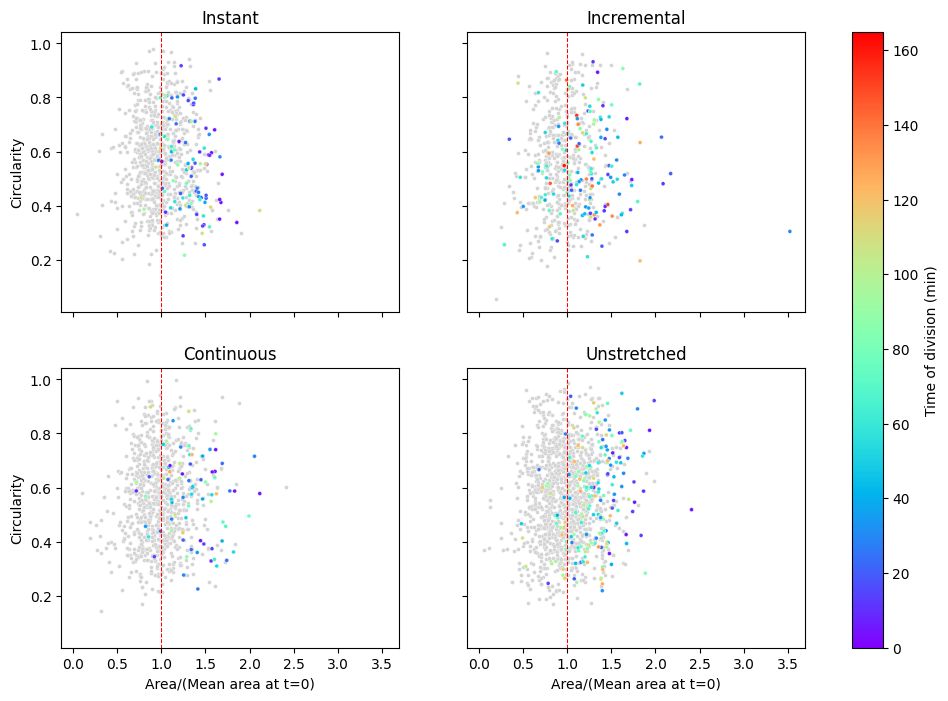

In [98]:
fig, ax=plt.subplots(2,2, sharey=True, sharex=True, figsize=(12,8))
sns.scatterplot(all_cells[(all_cells.time==0)&(all_cells.stretch_type=='f')&(all_cells.state=='never divides')], x='area_norm_mean', y='circularity', ax=ax[0,0],s=8, c='lightgrey')
g=sns.scatterplot(all_cells[(all_cells.time==0)&(all_cells.stretch_type=='f')&(all_cells.state=='will divide')], x='area_norm_mean', y='circularity', ax=ax[0,0],s=8, hue='last_frame', palette=sns.color_palette("rainbow",33), legend=False)
ax[0,0].set_title("Instant")

sns.scatterplot(all_cells[(all_cells.time==0)&(all_cells.stretch_type=='s')&(all_cells.state=='never divides')], x='area_norm_mean', y='circularity', ax=ax[0,1],s=8, c='lightgrey')
g=sns.scatterplot(all_cells[(all_cells.time==0)&(all_cells.stretch_type=='s')&(all_cells.state=='will divide')], x='area_norm_mean', y='circularity', ax=ax[0,1],s=8, hue='last_frame', palette=sns.color_palette("rainbow",33), legend=False)
ax[0,1].set_title("Incremental")


sns.scatterplot(all_cells[(all_cells.time==0)&(all_cells.stretch_type=='c')&(all_cells.state=='never divides')], x='area_norm_mean', y='circularity', ax=ax[1,0], s=8, c='lightgrey')
g=sns.scatterplot(all_cells[(all_cells.time==0)&(all_cells.stretch_type=='c')&(all_cells.state=='will divide')], x='area_norm_mean', y='circularity', ax=ax[1,0],s=8, hue='last_frame', palette=sns.color_palette("rainbow",33), legend=False)
ax[1,0].set_title("Continuous")


sns.scatterplot(all_cells[(all_cells.time==0)&(all_cells.stretch_type=='u')&(all_cells.state=='never divides')], x='area_norm_mean', y='circularity', ax=ax[1,1], s=8, c='lightgrey')
g=sns.scatterplot(all_cells[(all_cells.time==0)&(all_cells.stretch_type=='u')&(all_cells.state=='will divide')], x='area_norm_mean', y='circularity', ax=ax[1,1],s=8, hue='last_frame', palette=sns.color_palette("rainbow",33), legend=False)
ax[1,1].set_title("Unstretched")

ax[0,0].axvline(1, linestyle='--', linewidth=0.75, c='red')
ax[0,1].axvline(1, linestyle='--', linewidth=0.75, c='red')
ax[1,0].axvline(1, linestyle='--', linewidth=0.75, c='red')
ax[1,1].axvline(1, linestyle='--', linewidth=0.75, c='red')

ax[1,0].set_xlabel("Area/(Mean area at t=0)")
ax[1,1].set_xlabel("Area/(Mean area at t=0)")

ax[1,0].set_ylabel("Circularity")
ax[0,0].set_ylabel("Circularity")


cbar = fig.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(0, 33*5), cmap='rainbow'),
             ax=ax, orientation='vertical', label='Time of division (min)')
#cbar.ax.set_ylabel('angle', rotation=90)
plt.savefig(save_dir+'/t_0_cells_area_circ.png', dpi=300, bbox_inches='tight')


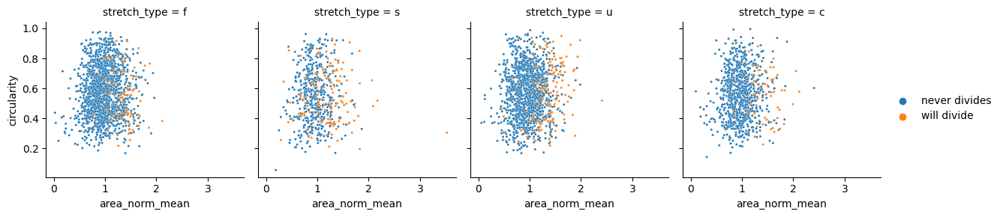

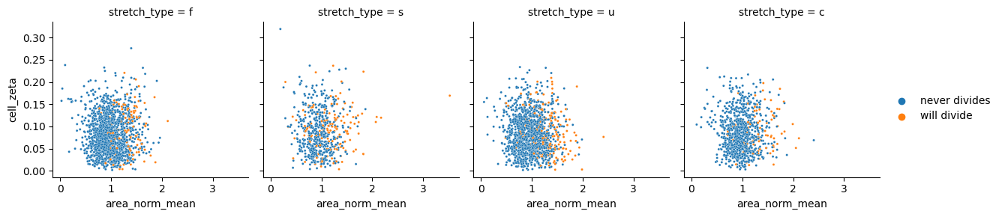

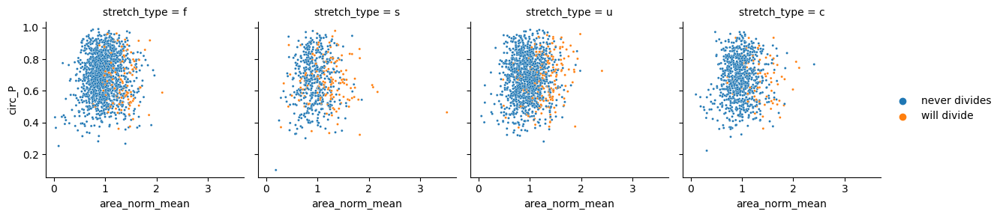

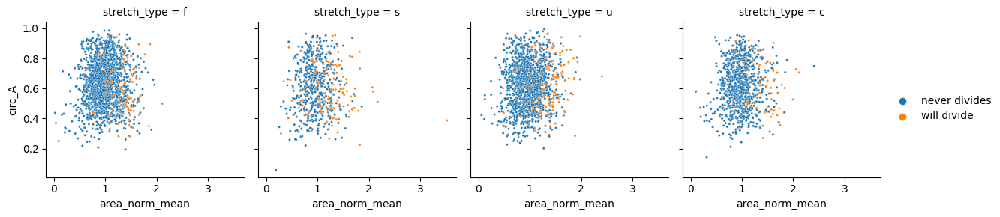

In [239]:

g = sns.FacetGrid(all_cells[all_cells.time==0], col="stretch_type")
g.map_dataframe(sns.scatterplot,x='area_norm_mean', y='circularity', hue='state', s=5)
g.add_legend()
plt.show()

g = sns.FacetGrid(all_cells[all_cells.time==0], col="stretch_type")
g.map_dataframe(sns.scatterplot,x='area_norm_mean', y='cell_zeta', hue='state', s=5)
g.add_legend()


g = sns.FacetGrid(all_cells[all_cells.time==0], col="stretch_type")
g.map_dataframe(sns.scatterplot,x='area_norm_mean', y='circ_P', hue='state', s=5)
g.add_legend()

plt.show()

g = sns.FacetGrid(all_cells[all_cells.time==0], col="stretch_type")
g.map_dataframe(sns.scatterplot,x='area_norm_mean', y='circ_A', hue='state', s=5)
g.add_legend()


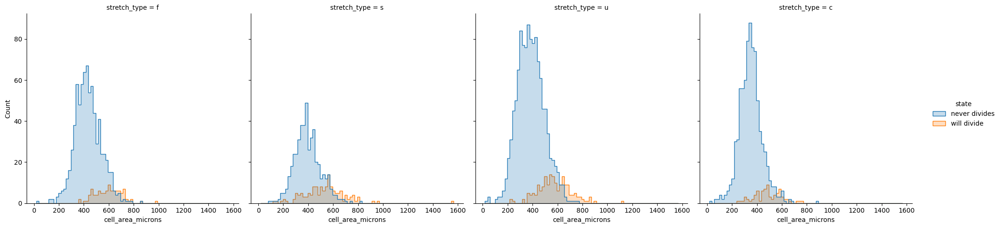

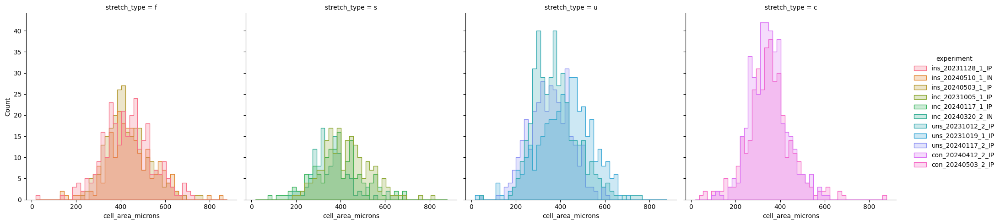

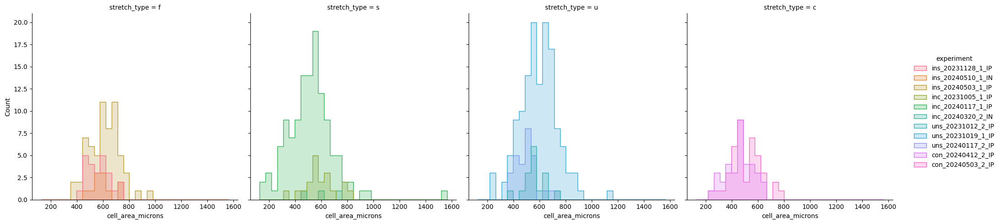

In [99]:
g = sns.displot(data=all_cells[all_cells.time==0], kind='hist', x="cell_area_microns", col="stretch_type", hue="state", legend=True, element='step')
plt.show()

g = sns.displot(data=all_cells[(all_cells.time==0)&(all_cells.state=='never divides')], kind='hist', x="cell_area_microns", col="stretch_type", hue="experiment", legend=True, element='step')
plt.show()
g = sns.displot(data=all_cells[(all_cells.time==0)&(all_cells.state=='will divide')], kind='hist', x="cell_area_microns", col="stretch_type", hue="experiment", legend=True, element='step')
plt.show()



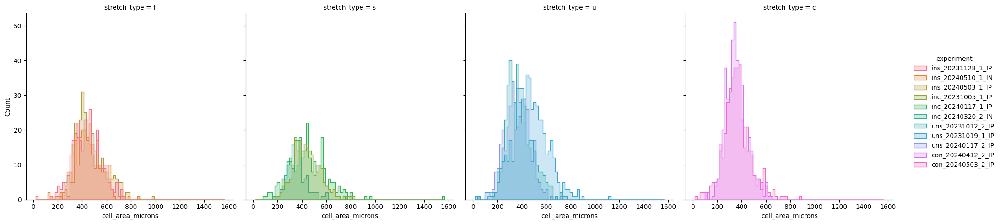

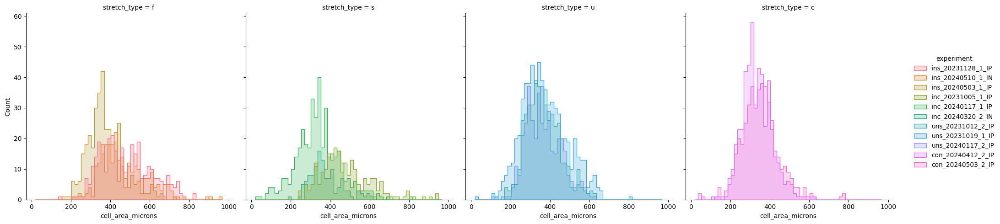

In [100]:
g = sns.displot(data=all_cells[(all_cells.time==0)], kind='hist', x="cell_area_microns", col="stretch_type", hue="experiment", legend=True, element='step')
plt.show()

g = sns.displot(data=all_cells[(all_cells.time==125)], kind='hist', x="cell_area_microns", col="stretch_type", hue="experiment", legend=True, element='step')
plt.show()

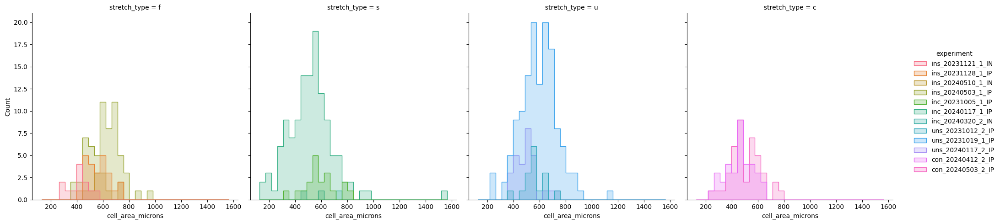

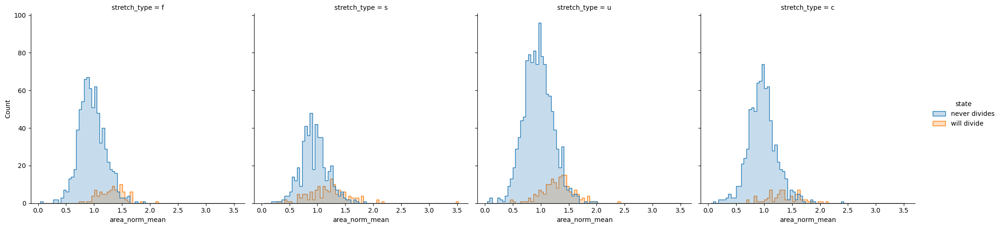

In [101]:
g=sns.displot(data=all_cells[all_cells.time==0], kind='hist', x="area_norm_mean", col="stretch_type", hue="state", legend=True, element='step')
# g = sns.FacetGrid(all_cells[all_cells.time==0], col="stretch_type")
# g.map_dataframe(sns.histplot,x='area_norm_mean', hue='state', element='step')
#g.add_legend()

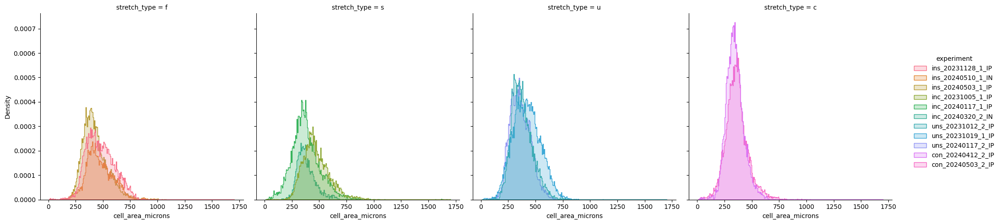

In [102]:
g = sns.displot(data=all_cells, kind='hist', x="cell_area_microns", col="stretch_type", hue="experiment", legend=True, element='step', stat='density')
plt.show()

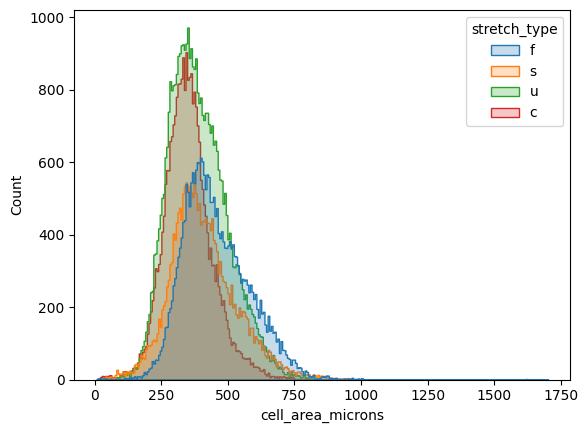

In [104]:
sns.histplot(data=all_cells, x="cell_area_microns", hue="stretch_type", legend=True, element='step')
plt.show()

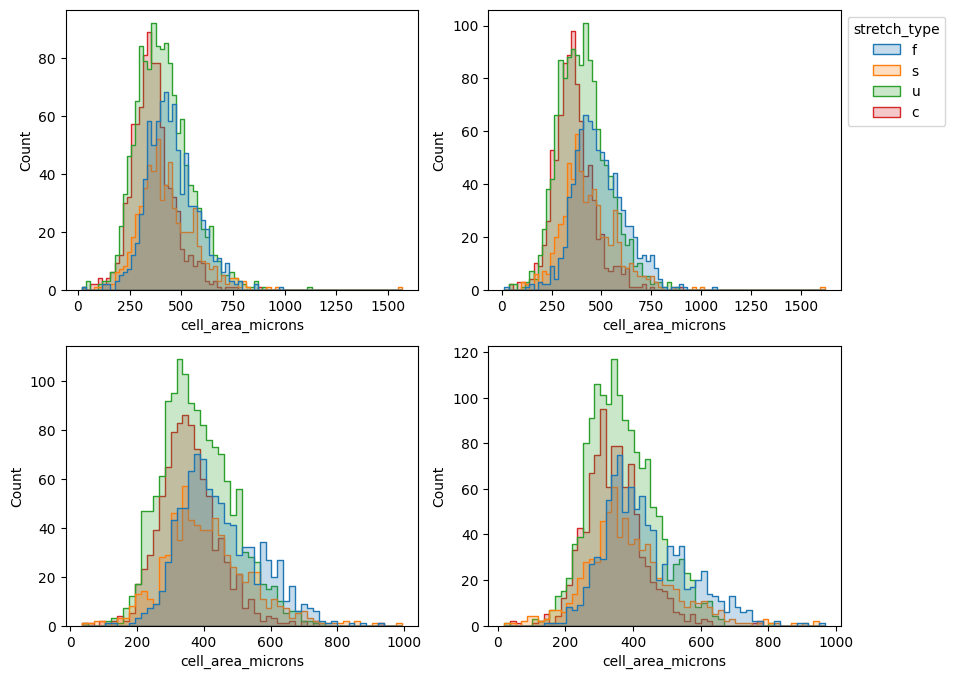

In [114]:
fig, ax=plt.subplots(2,2, figsize=(10, 8))
sns.histplot(data=all_cells[all_cells.time==0],ax=ax[0,0], x="cell_area_microns", hue="stretch_type", element='step', legend=False)
g=sns.histplot(data=all_cells[all_cells.time==5],ax=ax[0,1] ,x="cell_area_microns", hue="stretch_type",  element='step',legend=True)

sns.histplot(data=all_cells[all_cells.time==80],ax=ax[1,0] ,x="cell_area_microns", hue="stretch_type", element='step', legend=False)
sns.histplot(data=all_cells[all_cells.time==125],ax=ax[1,1] ,x="cell_area_microns", hue="stretch_type",  element='step',legend=False)
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)

plt.show()

In [131]:
all_cells[all_cells.state=='will divide'].groupby(['stretch_type',ex,'cell_id_new']).first().cell_area_microns

stretch_type  cell_id_new
c             4              476.503376
              11             466.713212
              17             386.200068
              19             552.048376
              27             749.897371
                                ...    
u             486            867.963831
              490            675.082980
              499            508.942428
              512            520.924421
              513            670.114837
Name: cell_area_microns, Length: 463, dtype: float64

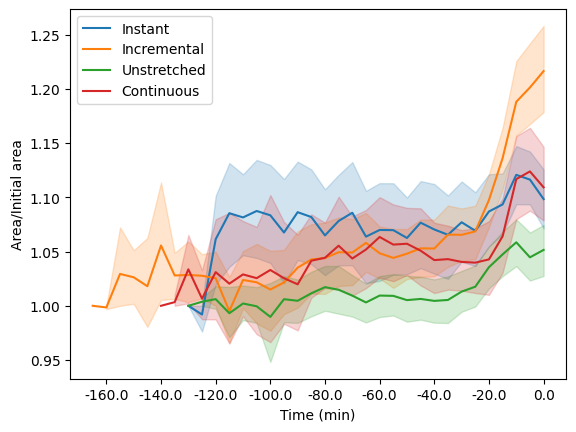

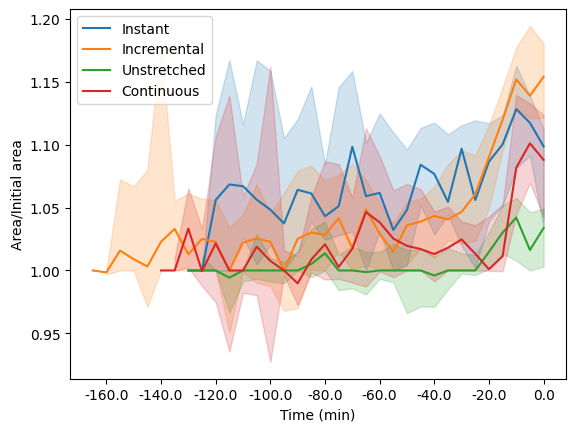

In [177]:
fig, ax=plt.subplots()
g=sns.lineplot(all_cells[all_cells.state=='will divide'], ax=ax,x='aligned_time_back', y='area_norm', hue='stretch_type')

h,l=g.get_legend_handles_labels()
g.legend(h, ["Instant", "Incremental", "Unstretched", "Continuous"])
ax.set_ylabel("Area/Initial area")
ax.set_xlabel("Time (min)")

ax.set_xticks(np.linspace(10, 170, 9), labels=np.linspace(-160, 0, 9))

plt.show()

fig, ax=plt.subplots()
g=sns.lineplot(all_cells[all_cells.state=='will divide'], ax=ax,x='aligned_time_back', y='area_norm', hue='stretch_type', estimator='median')

h,l=g.get_legend_handles_labels()
g.legend(h, ["Instant", "Incremental", "Unstretched", "Continuous"])
ax.set_ylabel("Area/Initial area")
ax.set_xlabel("Time (min)")

ax.set_xticks(np.linspace(10, 170, 9), labels=np.linspace(-160, 0, 9))

In [175]:
will_div=all_cells[all_cells.state=='will divide']
will_div['final_cell_area']=will_div.groupby(["experiment", "cell_id_new"]).cell_area_microns.transform('last')
will_div['final_cell_area_norm']=will_div.groupby(["experiment", "cell_id_new"]).area_norm.transform('last')

will_div


C:\Users\v35431nc\AppData\Local\Temp\ipykernel_37512\4097333322.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  will_div['final_cell_area']=will_div.groupby(["experiment", "cell_id_new"]).cell_area_microns.transform('last')
C:\Users\v35431nc\AppData\Local\Temp\ipykernel_37512\4097333322.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  will_div['final_cell_area_norm']=will_div.groupby(["experiment", "cell_id_new"]).area_norm.transform('last')


,index,cell_id_old,cell_perimeter_microns,cell_area_microns,shape_parameter,circularity,cell_edge_count,major_shape_axis_alignment_rads,cc_x,cc_y,...,first_frame,last_frame,area_norm_mean,area_norm_last,circ_norm,circ_norm_last,aligned_time,aligned_time_back,final_cell_area,final_cell_area_norm
10,10,10.0,92.233595,564.322612,3.882625,0.532126,5.0,2.174191,100.030530,-177.413812,...,0,9,1.284676,0.920400,1.000000,0.901005,0,125,613.127312,1.086484
14,14,14.0,87.290269,519.609324,3.829370,0.801955,5.0,1.729097,-96.205711,-150.924623,...,0,6,1.182887,0.832982,1.000000,0.856066,0,140,623.794208,1.200506
20,20,20.0,85.367278,491.700049,3.849828,0.798256,5.0,3.064705,-67.229781,-127.679008,...,0,3,1.119352,0.909459,1.000000,2.034785,0,155,540.650871,1.099554
35,35,35.0,88.535381,512.887718,3.909360,0.702319,5.0,1.783045,73.433221,-44.967865,...,0,4,1.167585,0.904639,1.000000,1.245827,0,150,566.952806,1.105413
44,44,44.0,83.934430,467.297699,3.882785,0.806262,5.0,0.097208,115.924043,-8.423596,...,0,10,1.063800,0.630521,1.000000,1.246539,0,120,741.130059,1.585991
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
114857,11145,252.0,90.814552,576.012361,3.783899,0.544762,6.0,0.096247,-210.701452,21.645189,...,0,27,1.645556,1.015979,0.754824,0.960718,125,160,566.952806,1.152704
115211,11499,153.0,85.634485,526.477051,3.732149,0.843235,6.0,0.104518,-136.371358,-96.593916,...,0,27,1.506005,0.994754,1.462489,0.952382,130,165,529.253366,0.893439
115308,11596,250.0,92.540880,603.921635,3.765679,0.595741,6.0,0.122361,-210.162671,21.796543,...,0,27,1.727538,1.065206,0.825461,1.050622,130,165,566.952806,1.152704
115663,11951,152.0,85.872311,529.253366,3.732685,0.885396,6.0,0.070626,-135.590120,-97.084511,...,0,27,1.518911,1.000000,1.535612,1.000000,135,170,529.253366,0.893439


In [163]:
will_div.final_cell_area.max()

1666.2275367234724

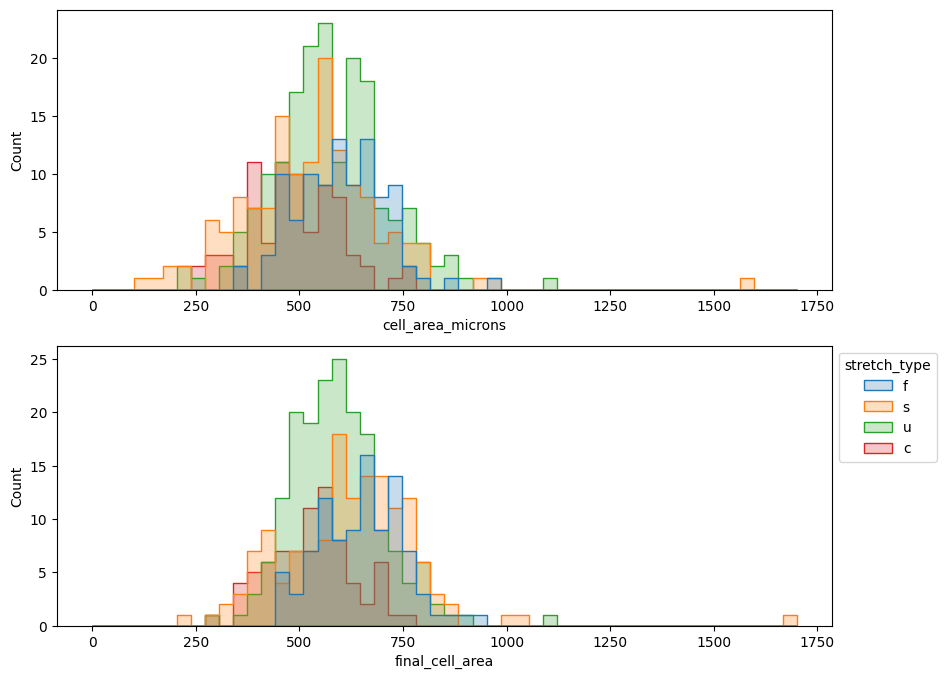

In [170]:
fig, ax=plt.subplots(2, 1, figsize=(10, 8))
sns.histplot(data=will_div[will_div.time==0],ax=ax[0], x="cell_area_microns", hue="stretch_type", element='step', legend=False, binrange=(0, 1700), bins=50)
g=sns.histplot(data=will_div[will_div.time==0],ax=ax[1] ,x="final_cell_area", hue="stretch_type",  element='step',legend=True, binrange=(0, 1700), bins=50)

sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)

plt.show()

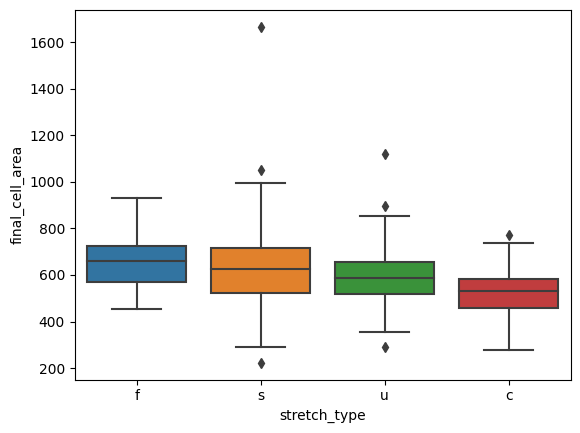

<AxesSubplot: xlabel='stretch_type', ylabel='final_cell_area_norm'>

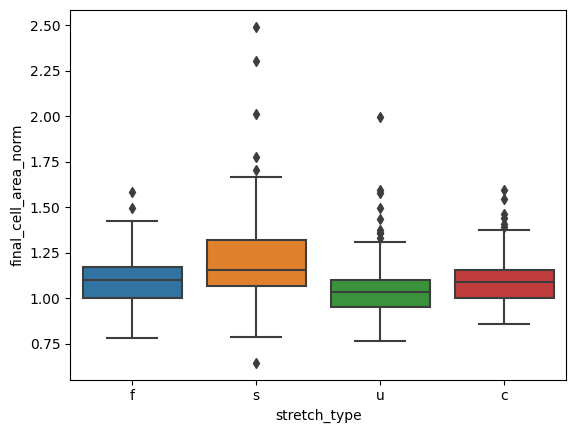

In [176]:
sns.boxplot(data=will_div[will_div.time==0], x='stretch_type', y='final_cell_area')
plt.show()

sns.boxplot(data=will_div[will_div.time==0], x='stretch_type', y='final_cell_area_norm')


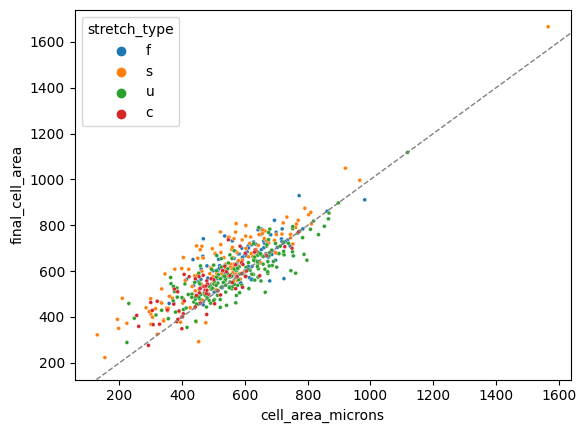

In [153]:

sns.scatterplot(will_div[will_div.time==0], x='cell_area_microns', y='final_cell_area', hue='stretch_type', s=8)
plt.axline(xy1=(200, 200), slope=1, color='grey', lw=1, linestyle='--')

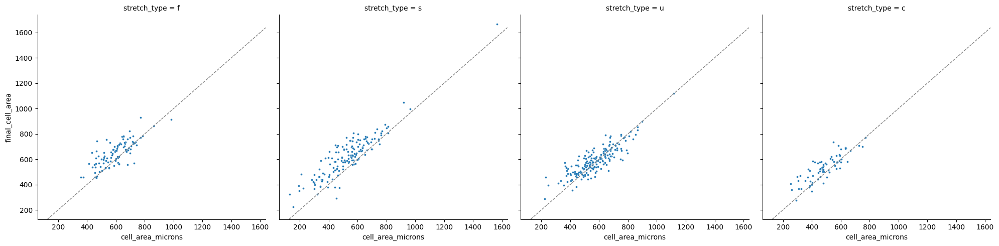

In [156]:
g=sns.relplot(will_div[will_div.time==0],kind='scatter', x='cell_area_microns', y='final_cell_area', col='stretch_type', s=8)
g.map(plt.axline,xy1=(200, 200), slope=1, color='grey', lw=1, linestyle='--')

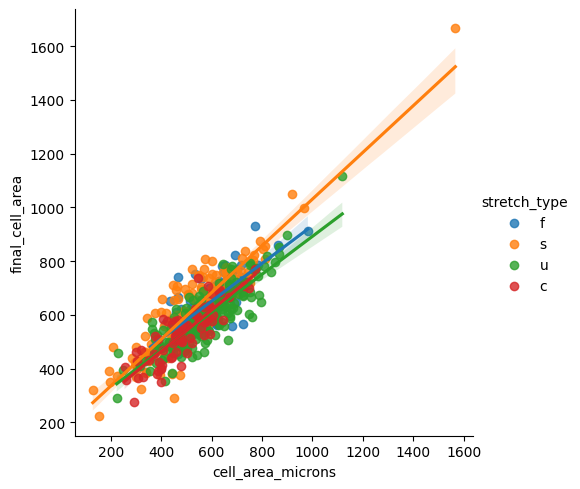

In [161]:
sns.lmplot(
 will_div[will_div.time==0], x='cell_area_microns', y='final_cell_area', hue='stretch_type'
)

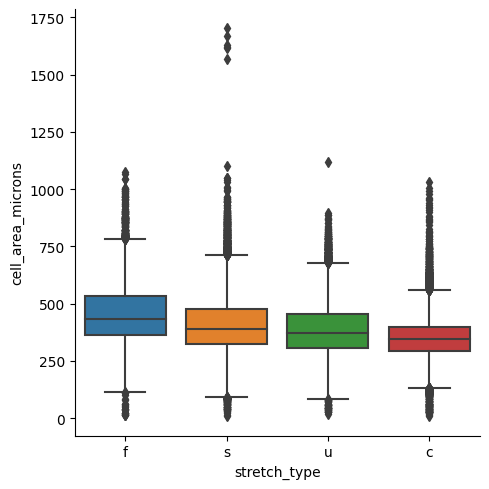

In [116]:
sns.catplot(all_cells, kind='box', x='stretch_type', y='cell_area_microns')

(array([ 10.,  80., 139.,  27.,   4.,   4.,   2.,   0.,   1.,   1.]),
 array([0.36717095, 0.69340624, 1.01964152, 1.34587681, 1.6721121 ,
        1.99834738, 2.32458267, 2.65081795, 2.97705324, 3.30328852,
        3.62952381]),
 <BarContainer object of 10 artists>)

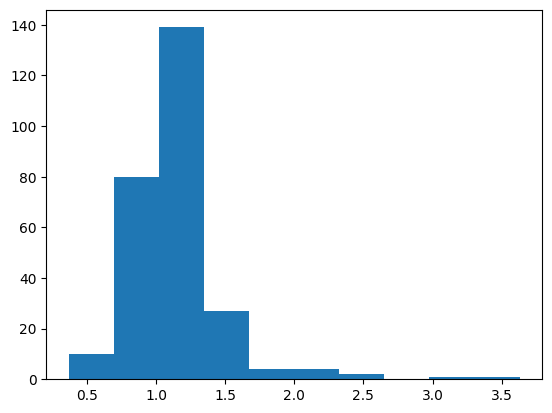

In [123]:
plt.hist(all_cells[all_cells.state=='will divide'].groupby('cell_id_new').last().cell_area_microns/all_cells[all_cells.state=='will divide'].groupby('cell_id_new').first().cell_area_microns)

In [ ]:
sns.lineplot(data=all_cells[all_cells.stretch_type=='s'], x='time', y='circularity', hue='state')

plt.show()
sns.lineplot(data=all_cells[all_cells.stretch_type=='s'], x='time', y='shape_parameter', hue='state')

plt.show()

sns.lineplot(data=all_cells[all_cells.stretch_type=='s'], x='time', y='cell_perimeter_microns', hue='state')

plt.show()

In [ ]:
sns.lineplot(data=all_cells[all_cells.stretch_type=='f'], x='time', y='circularity', hue='state')

plt.show()
sns.lineplot(data=all_cells[all_cells.stretch_type=='f'], x='time', y='shape_parameter', hue='state')

plt.show()

sns.lineplot(data=all_cells[all_cells.stretch_type=='f'], x='time', y='cell_perimeter_microns', hue='state')

plt.show()

In [ ]:
g = sns.FacetGrid(all_cells, col="time", height=2.5, col_wrap=9, hue='state',palette=sns.husl_palette(3,l=.4))
g.map(sns.histplot, "area_norm_mean",element="step", alpha=0.4, legend=True)
g.add_legend()
#plt.suptitle("daughter cell area")
sns.move_legend(g, "upper left", bbox_to_anchor=(0.4, 1.05), frameon=True, ncol=3)
#plt.savefig(save_dir+'/daughter_cell_distributions.png', dpi=300, bbox_inches='tight')


In [ ]:
g = sns.FacetGrid(all_cells[all_cells.stretch_type=='u'], col="time", height=2.5, col_wrap=9, hue='state',palette=sns.husl_palette(3,l=.4))
g.map(sns.histplot, "area_norm_mean",element="step", alpha=0.4, legend=True)
g.add_legend()
#plt.suptitle("daughter cell area")
sns.move_legend(g, "upper left", bbox_to_anchor=(0.4, 1.05), frameon=True, ncol=3)

In [ ]:
g = sns.FacetGrid(all_cells[all_cells.stretch_type=='f'], col="time", height=2.5, col_wrap=9, hue='state',palette=sns.husl_palette(3,l=.4))
g.map(sns.histplot, "area_norm_mean",element="step", alpha=0.4, legend=True)
g.add_legend()
#plt.suptitle("daughter cell area")
sns.move_legend(g, "upper left", bbox_to_anchor=(0.4, 1.05), frameon=True, ncol=3)

In [ ]:
g = sns.FacetGrid(all_cells[all_cells.stretch_type=='s'], col="time", height=2.5, col_wrap=9, hue='state',palette=sns.husl_palette(3,l=.4))
g.map(sns.histplot, "area_norm_mean",element="step", alpha=0.4, legend=True)
g.add_legend()
#plt.suptitle("daughter cell area")
sns.move_legend(g, "upper left", bbox_to_anchor=(0.4, 1.05), frameon=True, ncol=3)

In [ ]:
g = sns.FacetGrid(all_cells[all_cells.stretch_type=='u'], col="time", height=2.5, col_wrap=9, hue='state',palette=sns.husl_palette(3,l=.4))
g.map(sns.histplot, "shape_parameter",element="step", alpha=0.4, legend=True)
g.add_legend()
#plt.suptitle("daughter cell area")
sns.move_legend(g, "upper left", bbox_to_anchor=(0.4, 1.05), frameon=True, ncol=3)

In [ ]:

sns.boxplot(data=all_cells[all_cells.stretch_type=='u'], x="time", y="cell_area_microns", hue='state')

In [ ]:
g = sns.boxplot(data=all_cells[all_cells.stretch_type=='u'], x='circularity', y='state')

In [ ]:
g = sns.FacetGrid(all_cells[all_cells.stretch_type=='u'], col="time", height=2.5, col_wrap=9, hue='state',palette=sns.husl_palette(3,l=.4))
g.map(sns.histplot, "circularity",element="step", alpha=0.4, legend=True)
g.add_legend()
#plt.suptitle("daughter cell area")
sns.move_legend(g, "upper left", bbox_to_anchor=(0.4, 1.05), frameon=True, ncol=3)

In [170]:
all_cells['aligned_time']=all_cells.time
all_cells.loc[all_cells.state=='daughter cell', 'aligned_time']=all_cells[all_cells.state=='daughter cell'].time-all_cells[all_cells.state=='daughter cell'].groupby(['experiment','cell_id_new'])['time'].transform('first')

In [ ]:
all_cells[all_cells.state=='daughter cell'].aligned_time

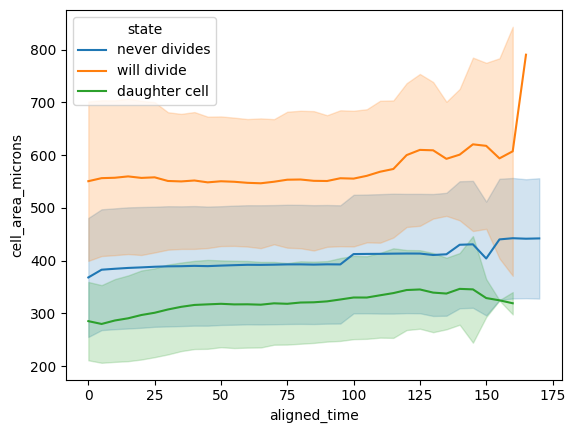

In [23]:
sns.lineplot(data=all_cells, x='aligned_time', y='cell_area_microns', hue='state', errorbar='sd')
#sns.lineplot(data=all_cells, x='aligned_time', y='cell_area_microns')
plt.show()

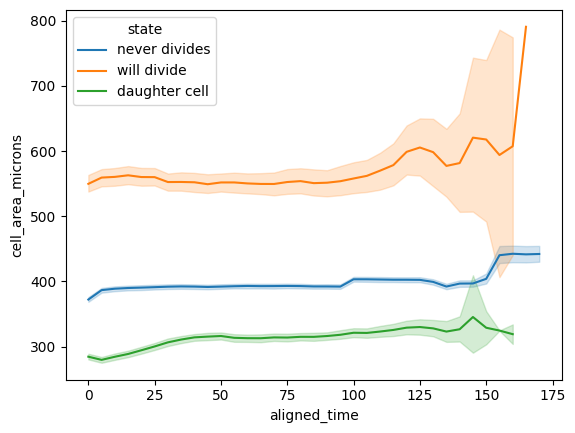

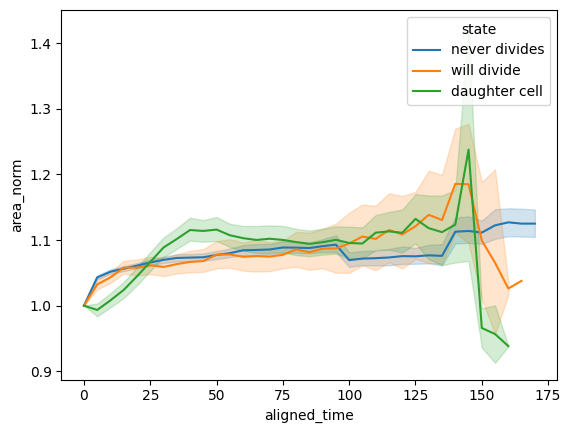

<AxesSubplot: xlabel='aligned_time', ylabel='area_norm_mean'>

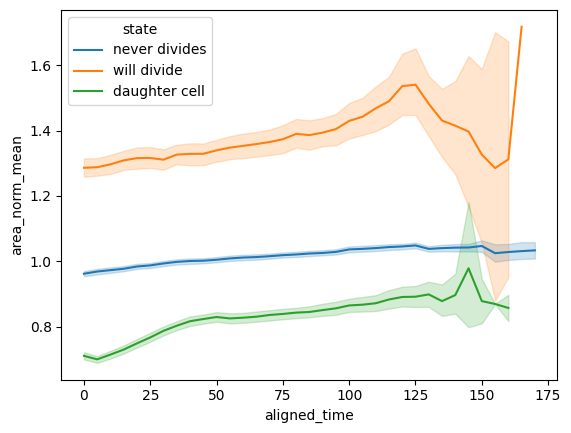

In [177]:
sns.lineplot(data=all_cells, x='aligned_time', y='cell_area_microns', hue='state')
#sns.lineplot(data=all_cells, x='aligned_time', y='cell_area_microns')
plt.show()
sns.lineplot(data=all_cells, x='aligned_time', y='area_norm', hue='state')
#sns.lineplot(data=all_cells, x='aligned_time', y='area_norm')
plt.show()
sns.lineplot(data=all_cells, x='aligned_time', y='area_norm_mean', hue='state')
#sns.lineplot(data=all_cells, x='aligned_time', y='area_norm_mean')

<AxesSubplot: xlabel='time', ylabel='area_norm'>

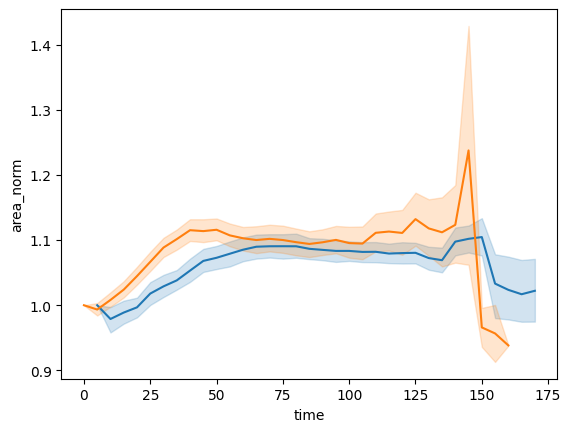

In [178]:
sns.lineplot(data=all_cells[all_cells.state=='daughter cell'], x='time', y='area_norm')
sns.lineplot(data=all_cells[all_cells.state=='daughter cell'], x='aligned_time', y='area_norm')

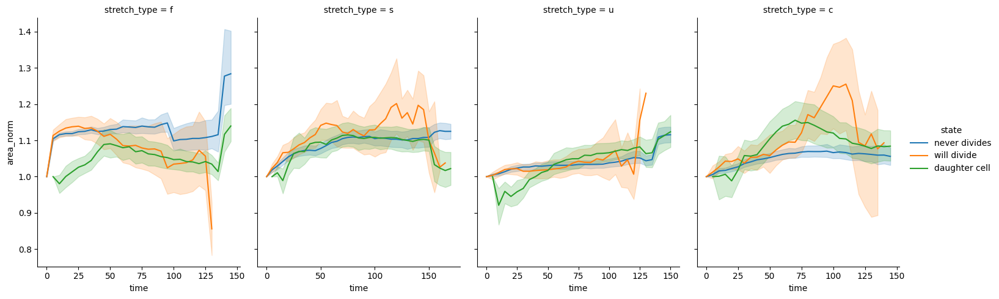

In [179]:
sns.relplot(
    data=all_cells,
    x="time", y="area_norm",
    hue="state",col="stretch_type",
    kind="line",
    height=5, aspect=.75, facet_kws=dict(sharex=False),
)

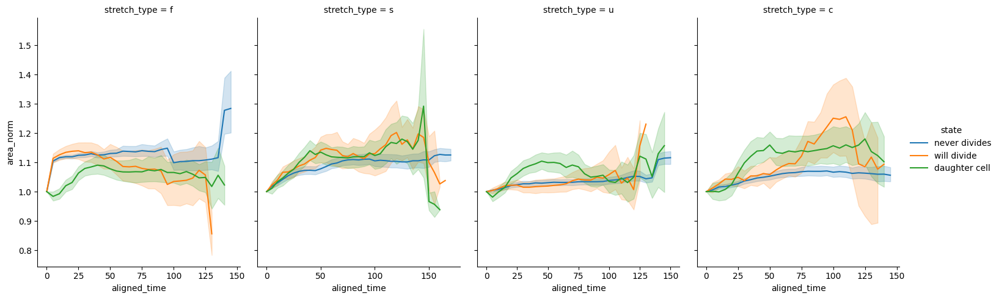

In [181]:
sns.relplot(
    data=all_cells,
    x="aligned_time", y="area_norm",
    hue="state",col="stretch_type",
    kind="line",
    height=5, aspect=.75, facet_kws=dict(sharex=False),
)

<AxesSubplot: xlabel='aligned_time', ylabel='area_norm'>

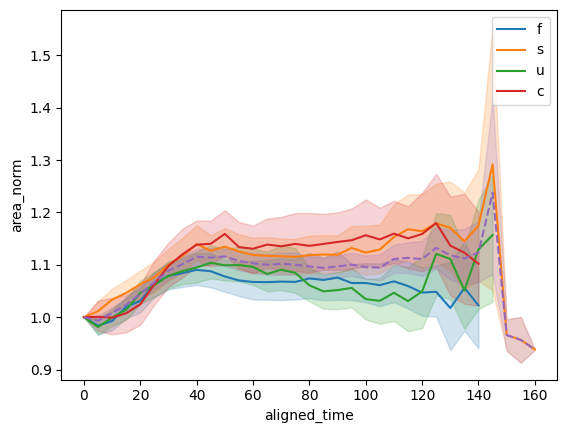

In [182]:
   sns.lineplot(data=all_cells[all_cells.state=='daughter cell'],
    x="aligned_time", y="area_norm",hue="stretch_type")

   sns.lineplot(data=all_cells[all_cells.state=='daughter cell'],
    x="aligned_time", y="area_norm", linestyle='--')

<AxesSubplot: xlabel='aligned_time', ylabel='perimeter_norm'>

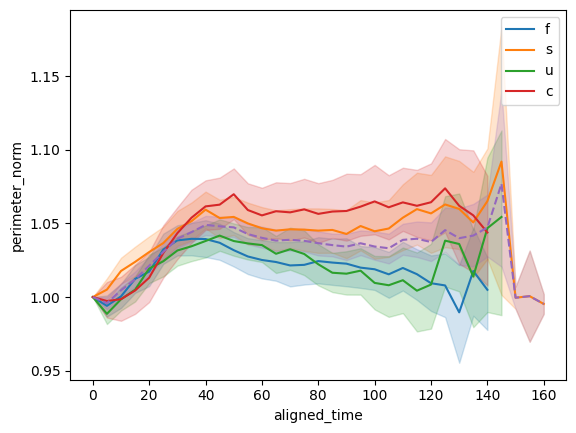

In [461]:
   sns.lineplot(data=all_cells[all_cells.state=='daughter cell'],
    x="aligned_time", y="perimeter_norm",hue="stretch_type")

   sns.lineplot(data=all_cells[all_cells.state=='daughter cell'],
    x="aligned_time", y="perimeter_norm", linestyle='--')

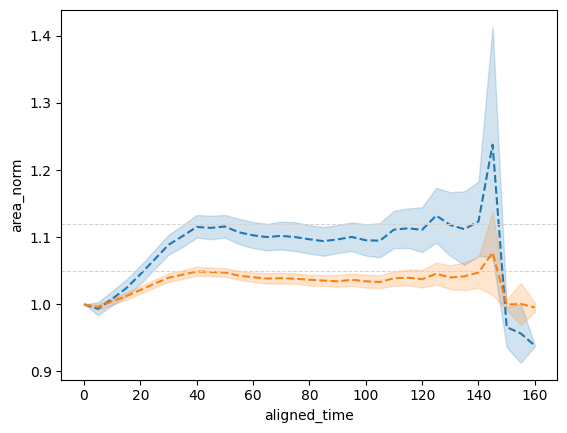

In [471]:

   sns.lineplot(data=all_cells[all_cells.state=='daughter cell'],
    x="aligned_time", y="area_norm", linestyle='--')
   sns.lineplot(data=all_cells[all_cells.state=='daughter cell'],
    x="aligned_time", y="perimeter_norm", linestyle='--')

   plt.axhline(1.12, color='lightgrey', linewidth=0.75, linestyle='--')
   plt.axhline(1.05, color='lightgrey', linewidth=0.75, linestyle='--')

<AxesSubplot: xlabel='aligned_time_back', ylabel='area_norm'>

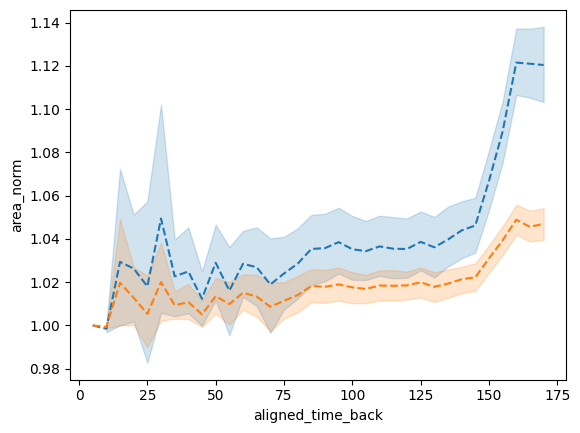

In [474]:
   sns.lineplot(data=all_cells[all_cells.state=='will divide'],
    x="aligned_time_back", y="area_norm", linestyle='--')
   sns.lineplot(data=all_cells[all_cells.state=='will divide'],
    x="aligned_time_back", y="perimeter_norm", linestyle='--')

   #plt.axhline(1.12, color='lightgrey', linewidth=0.75, linestyle='--')
   #plt.axhline(1.05, color='lightgrey', linewidth=0.75, linestyle='--')

In [479]:
(all_cells[all_cells.state=='will divide'].groupby([ 'aligned_time_back']).area_norm.mean()-1)/(all_cells[all_cells.state=='will divide'].groupby([ 'aligned_time_back']).perimeter_norm.mean()-1)

aligned_time_back
5           NaN
10     2.370862
15     1.489712
20     2.056625
25     3.372222
30     2.465916
35     2.431343
40     2.314902
45     2.406074
50     2.146487
55     1.628907
60     1.887139
65     2.013978
70     2.201037
75     2.104886
80     2.033548
85     1.940167
90     2.000115
95     2.030203
100    2.001706
105    2.035416
110    1.979146
115    1.935258
120    1.908963
125    1.936674
130    2.022375
135    2.054262
140    2.059439
145    2.073650
150    2.156591
155    2.276994
160    2.488430
165    2.653887
170    2.562374
dtype: float64

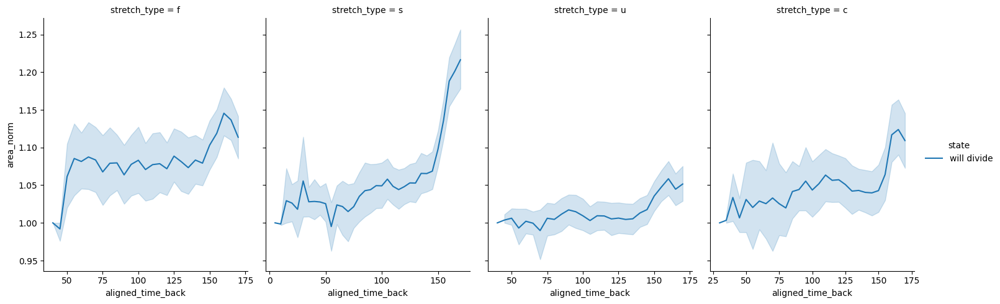

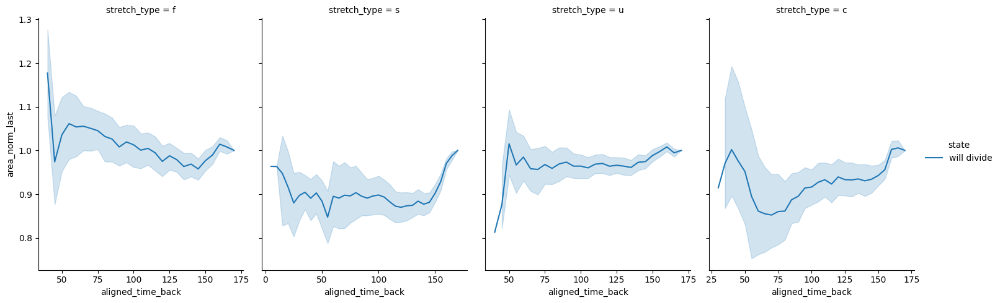

In [183]:
sns.relplot(
    data=all_cells[all_cells.state=='will divide'],
    x="aligned_time_back", y="area_norm",
    hue="state",col="stretch_type",
    kind="line",
    height=5, aspect=.75, facet_kws=dict(sharex=False),
)

sns.relplot(
    data=all_cells[all_cells.state=='will divide'],
    x="aligned_time_back", y="area_norm_last",
    hue="state",col="stretch_type",
    kind="line",
    height=5, aspect=.75, facet_kws=dict(sharex=False),
)

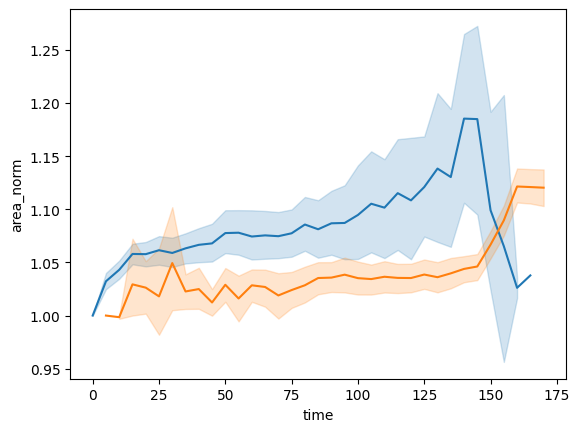

<AxesSubplot: xlabel='time', ylabel='area_norm_last'>

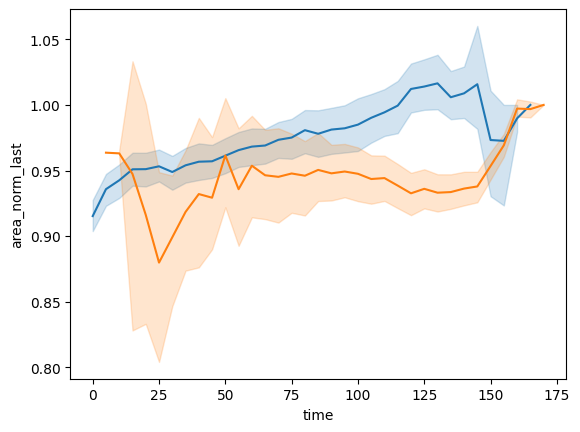

In [184]:
sns.lineplot(data=all_cells[all_cells.state=='will divide'], x='time', y='area_norm')
sns.lineplot(data=all_cells[all_cells.state=='will divide'], x='aligned_time_back', y='area_norm')
plt.show()
sns.lineplot(data=all_cells[all_cells.state=='will divide'], x='time', y='area_norm_last')
sns.lineplot(data=all_cells[all_cells.state=='will divide'], x='aligned_time_back', y='area_norm_last')

<AxesSubplot: xlabel='aligned_time_back', ylabel='circularity'>

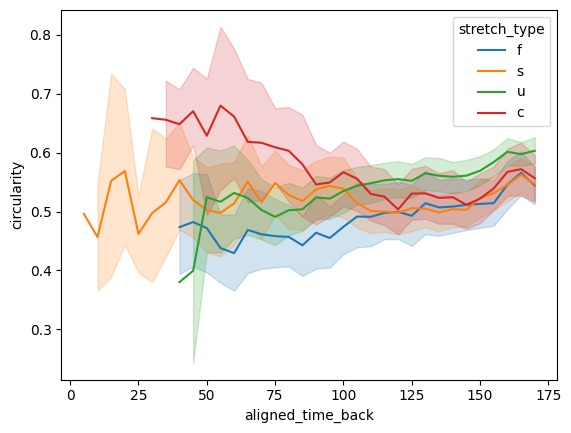

In [185]:
sns.lineplot(data=all_cells[all_cells.state=='will divide'], x='aligned_time_back', y='circularity', hue='stretch_type')

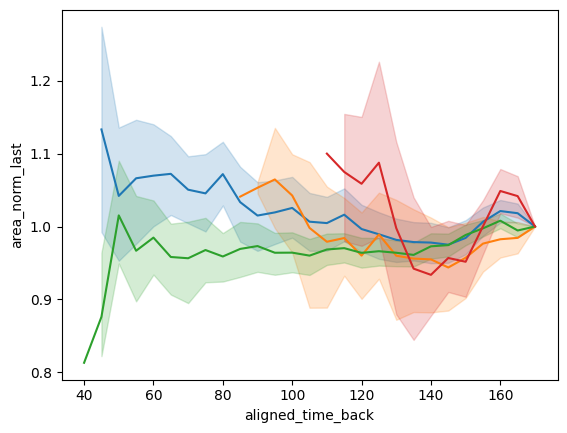

<AxesSubplot: xlabel='aligned_time_back', ylabel='area_norm'>

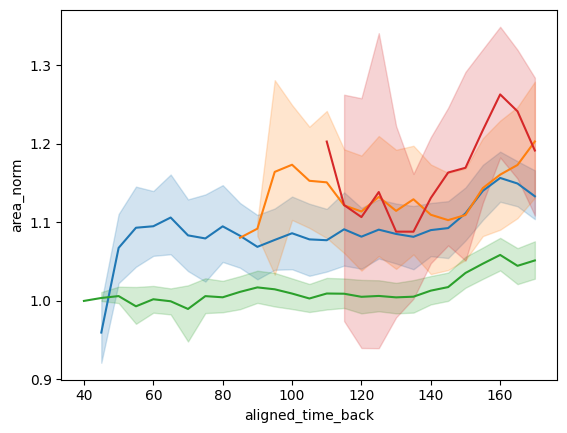

In [186]:
sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.time>0)&(all_cells.stretch_type=='f')], x='aligned_time_back', y='area_norm_last')

sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.time>=80)&(all_cells.stretch_type=='s')], x='aligned_time_back', y='area_norm_last')

sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.stretch_type=='u')], x='aligned_time_back', y='area_norm_last')

sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.time>=80)&(all_cells.stretch_type=='c')], x='aligned_time_back', y='area_norm_last')


plt.show()

sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.time>0)&(all_cells.stretch_type=='f')], x='aligned_time_back', y='area_norm')

sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.time>=80)&(all_cells.stretch_type=='s')], x='aligned_time_back', y='area_norm')

sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.stretch_type=='u')], x='aligned_time_back', y='area_norm')

sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.time>=80)&(all_cells.stretch_type=='c')], x='aligned_time_back', y='area_norm')


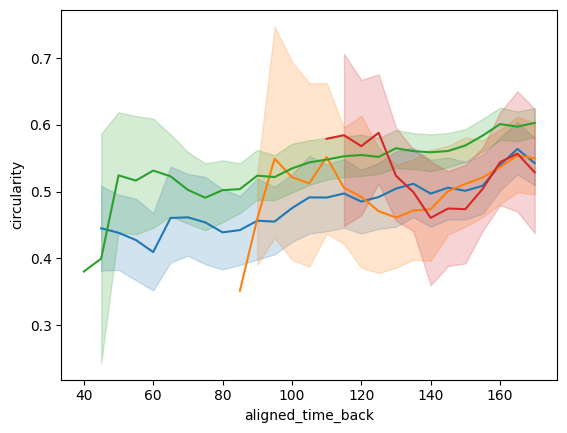

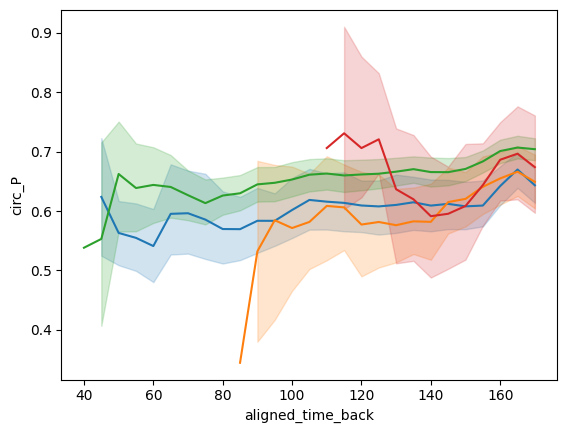

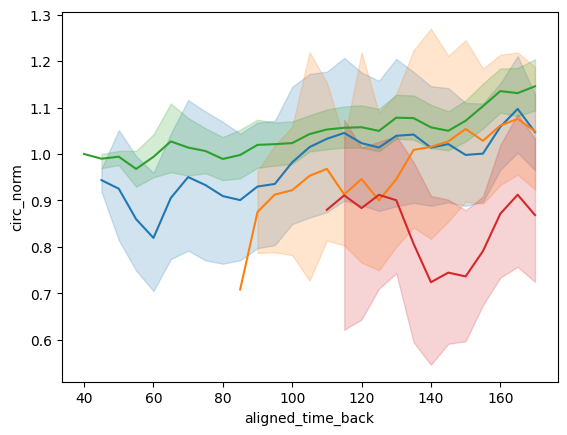

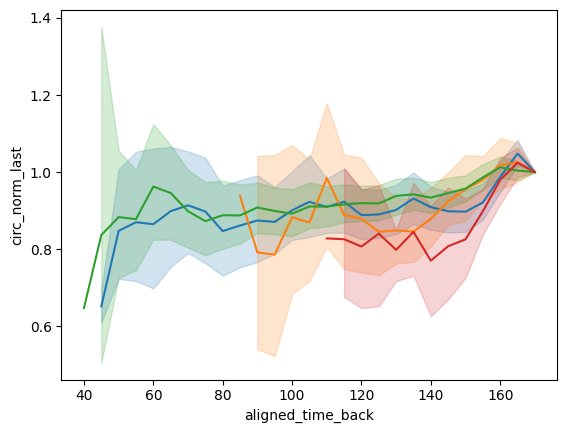

In [187]:
sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.time>0)&(all_cells.stretch_type=='f')], x='aligned_time_back', y='circularity')

sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.time>=80)&(all_cells.stretch_type=='s')], x='aligned_time_back', y='circularity')

sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.stretch_type=='u')], x='aligned_time_back', y='circularity')

sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.time>=80)&(all_cells.stretch_type=='c')], x='aligned_time_back', y='circularity')


plt.show()


sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.time>0)&(all_cells.stretch_type=='f')], x='aligned_time_back', y='circ_P')

sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.time>=80)&(all_cells.stretch_type=='s')], x='aligned_time_back', y='circ_P')

sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.stretch_type=='u')], x='aligned_time_back', y='circ_P')

sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.time>=80)&(all_cells.stretch_type=='c')], x='aligned_time_back', y='circ_P')


plt.show()

sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.time>0)&(all_cells.stretch_type=='f')], x='aligned_time_back', y='circ_norm')

sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.time>=80)&(all_cells.stretch_type=='s')], x='aligned_time_back', y='circ_norm')

sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.stretch_type=='u')], x='aligned_time_back', y='circ_norm')

sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.time>=80)&(all_cells.stretch_type=='c')], x='aligned_time_back', y='circ_norm')


plt.show()


sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.time>0)&(all_cells.stretch_type=='f')], x='aligned_time_back', y='circ_norm_last')

sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.time>=80)&(all_cells.stretch_type=='s')], x='aligned_time_back', y='circ_norm_last')

sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.stretch_type=='u')], x='aligned_time_back', y='circ_norm_last')

sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.time>=80)&(all_cells.stretch_type=='c')], x='aligned_time_back', y='circ_norm_last')


plt.show()

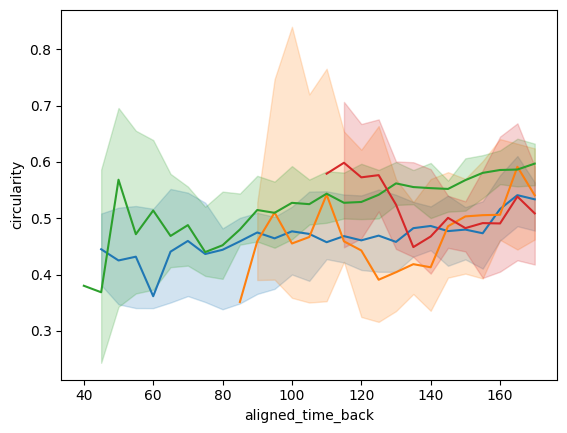

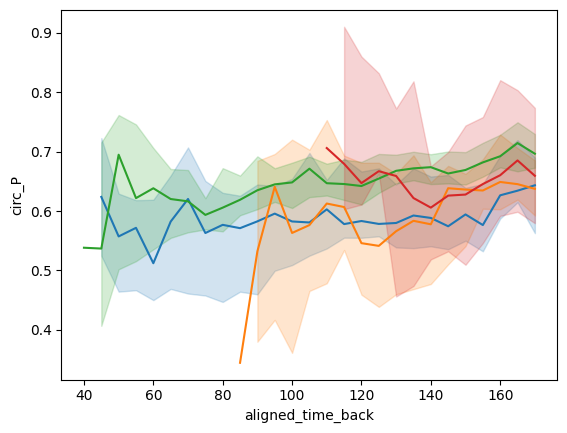

In [188]:
sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.time>0)&(all_cells.stretch_type=='f')], x='aligned_time_back', y='circularity', estimator='median')

sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.time>=80)&(all_cells.stretch_type=='s')], x='aligned_time_back', y='circularity', estimator='median')

sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.stretch_type=='u')], x='aligned_time_back', y='circularity', estimator='median')

sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.time>=80)&(all_cells.stretch_type=='c')], x='aligned_time_back', y='circularity', estimator='median')


plt.show()


sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.time>0)&(all_cells.stretch_type=='f')], x='aligned_time_back', y='circ_P', estimator='median')

sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.time>=80)&(all_cells.stretch_type=='s')], x='aligned_time_back', y='circ_P', estimator='median')

sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.stretch_type=='u')], x='aligned_time_back', y='circ_P', estimator='median')

sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.time>=80)&(all_cells.stretch_type=='c')], x='aligned_time_back', y='circ_P', estimator='median')


plt.show()

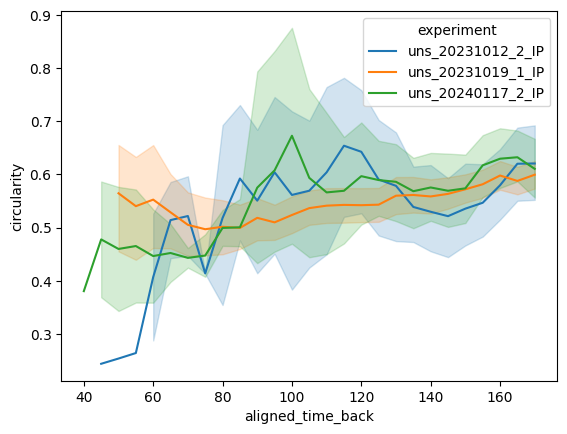

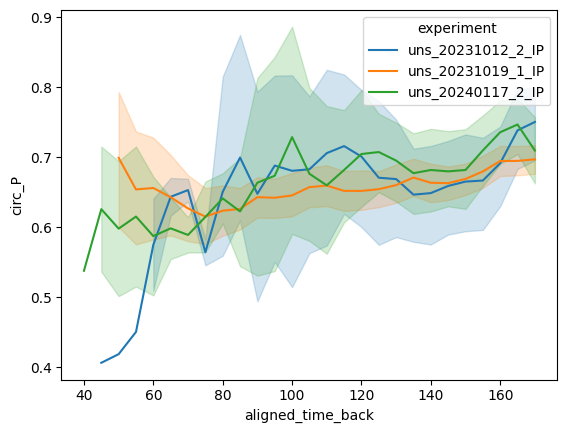

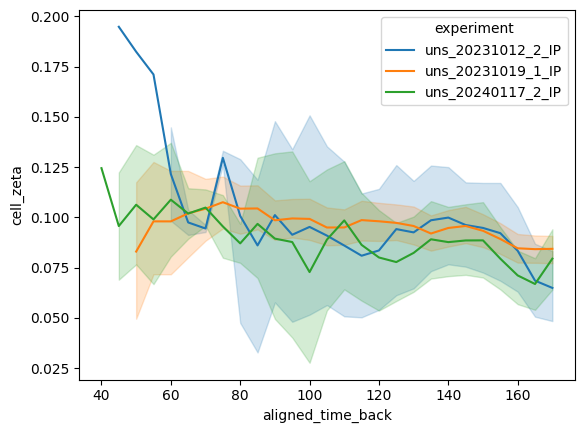

In [189]:
sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.stretch_type=='u')], x='aligned_time_back', y='circularity', hue='experiment')
plt.show()
sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.stretch_type=='u')], x='aligned_time_back', y='circ_P', hue='experiment')
plt.show()
sns.lineplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.stretch_type=='u')], x='aligned_time_back', y='cell_zeta', hue='experiment')
plt.show()

<AxesSubplot: xlabel='cell_zeta', ylabel='Probability'>

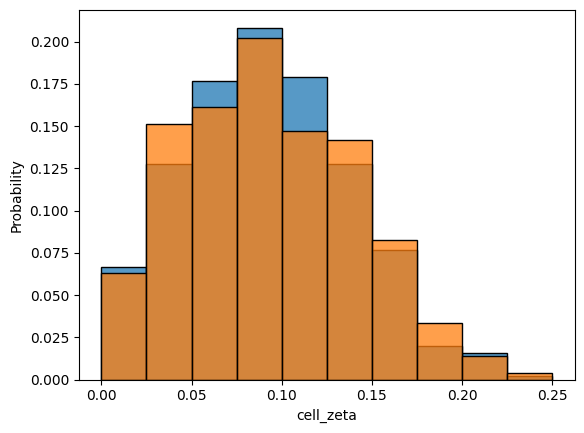

In [190]:
sns.histplot(all_cells[all_cells.state=='will divide'].groupby(['experiment', 'cell_id_new']).first(), x='cell_zeta', stat='probability', binrange=(0, 0.25), bins=10)
sns.histplot(all_cells[all_cells.state=='will divide'].groupby(['experiment', 'cell_id_new']).last(), x='cell_zeta', stat='probability',binrange=(0, 0.25), bins=10)

<AxesSubplot: xlabel='cell_edge_count', ylabel='Probability'>

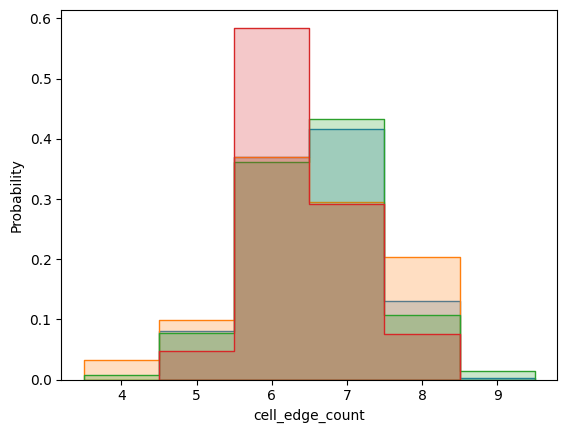

In [191]:
sns.histplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.time>0)&(all_cells.stretch_type=='f')], x='cell_edge_count', discrete=True, element='step',alpha=0.25, stat="probability")
sns.histplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.time>=80)&(all_cells.stretch_type=='s')], x='cell_edge_count', discrete=True, element='step',alpha=0.25, stat="probability")
sns.histplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.stretch_type=='u')], x='cell_edge_count', discrete=True, element='step',alpha=0.25, stat="probability")

sns.histplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.time>=80)&(all_cells.stretch_type=='c')], x='cell_edge_count', discrete=True, element='step', alpha=0.25,stat="probability")

<AxesSubplot: xlabel='circularity', ylabel='Probability'>

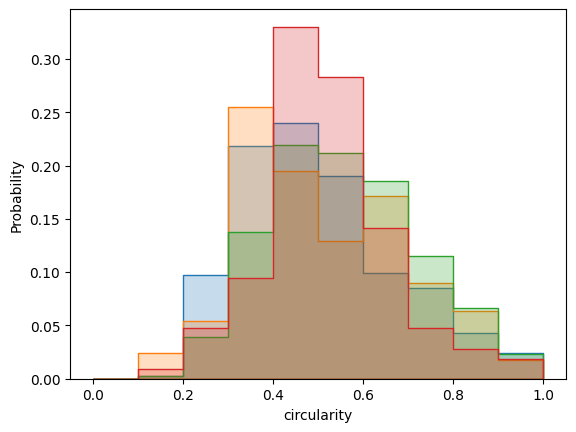

In [192]:
sns.histplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.time>0)&(all_cells.stretch_type=='f')], x='circularity', binrange=(0,1), bins=10, element='step',alpha=0.25, stat="probability")
sns.histplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.time>=80)&(all_cells.stretch_type=='s')], x='circularity', binrange=(0,1), bins=10, element='step',alpha=0.25, stat="probability")
sns.histplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.stretch_type=='u')], x='circularity',binrange=(0,1), bins=10, element='step',alpha=0.25, stat="probability")

sns.histplot(data=all_cells[(all_cells.state=='will divide')&(all_cells.time>=80)&(all_cells.stretch_type=='c')], x='circularity',binrange=(0,1), bins=10, element='step', alpha=0.25,stat="probability")

In [ ]:
sns.lineplot(data=parent_cells, x='time', y='area_norm_last')
sns.lineplot(data=parent_cells, x='aligned_time_back', y='area_norm_last')

In [ ]:
sns.lineplot(data=parent_cells, x='time', y='cell_area_microns')
sns.lineplot(data=parent_cells, x='aligned_time_back', y='cell_area_microns')

In [446]:
all_cells[(all_cells.aligned_time_back==170)&(all_cells.state=='will divide')]

,index,cell_id_old,cell_perimeter_microns,cell_area_microns,shape_parameter,circularity,cell_edge_count,major_shape_axis_alignment_rads,cc_x,cc_y,...,state,area_norm,first_frame,last_frame,area_norm_mean,area_norm_last,circ_norm,circ_norm_last,aligned_time,aligned_time_back
447,447,447.0,67.524711,301.741635,3.887274,0.438799,6.0,2.758442,-71.779151,201.123772,...,will divide,1.000000,0,0,1.025719,1.0,1.000000,1.0,0,170
561,561,561.0,87.001572,550.733279,3.707289,0.765691,7.0,1.399780,189.186989,59.770867,...,will divide,1.000000,0,0,1.872123,1.0,1.000000,1.0,0,170
575,575,575.0,76.801690,421.123192,3.742538,0.913814,7.0,0.863356,-149.457605,96.376919,...,will divide,1.000000,0,0,1.431536,1.0,1.000000,1.0,0,170
2458,2458,499.0,84.907256,515.371790,3.740111,0.910808,7.0,2.303487,-126.185670,-95.732355,...,will divide,1.113321,0,3,1.580575,1.0,1.233600,1.0,15,170
3504,3504,236.0,85.866669,527.061539,3.740192,0.973993,6.0,2.028438,26.332643,-132.439352,...,will divide,1.008105,0,5,1.610985,1.0,1.295353,1.0,25,170
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
126848,9974,432.0,86.780845,521.947274,3.798486,0.932545,8.0,1.186571,-109.642481,-97.604361,...,will divide,1.392593,0,22,1.467400,1.0,1.469688,1.0,110,170
127101,10227,237.0,83.853241,468.612796,3.873582,0.403015,6.0,0.468875,0.954214,3.831011,...,will divide,1.463047,0,23,1.331561,1.0,0.448565,1.0,115,170
127584,10710,269.0,91.874534,575.720117,3.829036,0.518717,6.0,0.115947,37.578254,49.696884,...,will divide,1.268921,0,24,1.641982,1.0,1.198352,1.0,120,170
128825,11951,152.0,85.872311,529.253366,3.732685,0.885396,6.0,0.070626,-135.590120,-97.084511,...,will divide,0.893439,0,27,1.518911,1.0,1.535612,1.0,135,170


In [449]:
parent_area=all_cells[all_cells.state=='will divide'].groupby(['experiment', 'cell_id_new']).cell_area_microns.last().to_frame()
parent_area_m_5=all_cells[(all_cells.aligned_time_back==165)&(all_cells.state=='will divide')][['experiment', 'cell_id_new', 'cell_area_microns']]
# parent_area_m_5

parent_area_i=all_cells[all_cells.state=='will divide'].groupby(['experiment', 'cell_id_new']).cell_area_microns.first().to_frame()

In [450]:
parent_area_m_5

,experiment,cell_id_new,cell_area_microns
1561,ins_20231121_1_IN,435,539.335775
2848,ins_20231121_1_IN,71,553.363473
3253,ins_20231121_1_IN,383,538.897409
3591,ins_20231121_1_IN,246,525.308076
4424,ins_20231121_1_IN,498,527.499904
...,...,...,...
126399,con_20240503_2_IP,176,521.216664
126645,con_20240503_2_IP,17,505.873869
127132,con_20240503_2_IP,350,595.738811
128373,con_20240503_2_IP,158,526.477051


In [431]:
daughter_area_0=(all_cells[all_cells.state=='daughter cell'].groupby(['experiment','cell_id_new']).first()).groupby(['experiment', 'parent_id']).cell_area_microns.sum().to_frame()

daughter_area_5=(all_cells[(all_cells.state=='daughter cell')&(all_cells.aligned_time==5)]).groupby(['experiment', 'parent_id']).cell_area_microns.sum().to_frame()
daughter_area_5
(all_cells[(all_cells.state=='daughter cell')&(all_cells.aligned_time==10)]).groupby(['experiment', 'parent_id']).cell_area_microns.sum().to_frame()

daughter_area_10=(all_cells[(all_cells.state=='daughter cell')&(all_cells.aligned_time==10)]).groupby(['experiment', 'parent_id']).cell_area_microns.sum().to_frame()


(array([2.6400e+02, 2.4340e+03, 9.0360e+03, 1.3445e+04, 8.6590e+03,
        3.8700e+03, 1.6060e+03, 7.5200e+02, 2.9600e+02, 1.4700e+02,
        7.4000e+01, 3.9000e+01, 2.0000e+01, 2.1000e+01, 8.0000e+00,
        5.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e+00]),
 array([0.11032185, 0.33318502, 0.55604819, 0.77891136, 1.00177454,
        1.22463771, 1.44750088, 1.67036405, 1.89322723, 2.1160904 ,
        2.33895357, 2.56181675, 2.78467992, 3.00754309, 3.23040626,
        3.45326944, 3.67613261, 3.89899578, 4.12185896, 4.34472213,
        4.5675853 ]),
 <BarContainer object of 20 artists>)

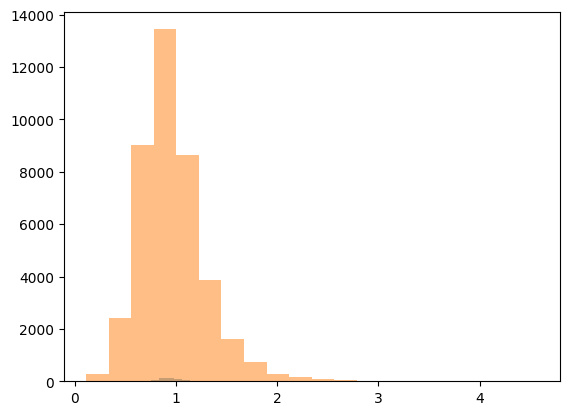

In [432]:
plt.hist(np.array(daughter_area_0.cell_area_microns/parent_area.cell_area_microns), bins=20, alpha=0.5)
plt.hist(np.array((all_cells[(all_cells.state=='daughter cell')&(all_cells.aligned_time==5)]).groupby(['experiment', 'parent_id']).cell_area_microns.sum()/all_cells[all_cells.state=='will divide'].groupby(['experiment', 'cell_id_new']).cell_area_microns.last()), bins=20, alpha=0.5)

In [433]:
areas_p_5=pd.merge(parent_area,daughter_area_5,  left_on=['experiment', 'cell_id_new'], right_on=['experiment', 'parent_id'], suffixes=["_p", "_d_5"])
areas_p_0=pd.merge(parent_area,daughter_area_0,  left_on=['experiment', 'cell_id_new'], right_on=['experiment', 'parent_id'], suffixes=["_p", "_d_0"])
areas_p_10=pd.merge(parent_area,daughter_area_10,  left_on=['experiment', 'cell_id_new'], right_on=['experiment', 'parent_id'], suffixes=["_p", "_d_10"])


In [452]:
areas_test=pd.merge(parent_area_m_5, daughter_area_5 ,left_on=['experiment', 'cell_id_new'], right_on=['experiment', 'parent_id'], suffixes=["_p", "_d_5"])

In [434]:
areas_p_5_i=pd.merge(parent_area_i,daughter_area_5,  left_on=['experiment', 'cell_id_new'], right_on=['experiment', 'parent_id'], suffixes=["_p", "_d_5"])
areas_p_0_i=pd.merge(parent_area_i,daughter_area_0,  left_on=['experiment', 'cell_id_new'], right_on=['experiment', 'parent_id'], suffixes=["_p", "_d_0"])

In [453]:
areas_p_5['area_norm']=areas_p_5.cell_area_microns_d_5/areas_p_5.cell_area_microns_p
areas_p_0['area_norm']=areas_p_0.cell_area_microns_d_0/areas_p_0.cell_area_microns_p
areas_p_10['area_norm']=areas_p_10.cell_area_microns_d_10/areas_p_10.cell_area_microns_p

areas_p_5_i['area_norm']=areas_p_5_i.cell_area_microns_d_5/areas_p_5_i.cell_area_microns_p
areas_p_0_i['area_norm']=areas_p_0_i.cell_area_microns_d_0/areas_p_0_i.cell_area_microns_p

areas_test['area_norm']=areas_test.cell_area_microns_d_5/areas_test.cell_area_microns_p

Text(0.5, 0, 'sum of daughters area/ parent_area')

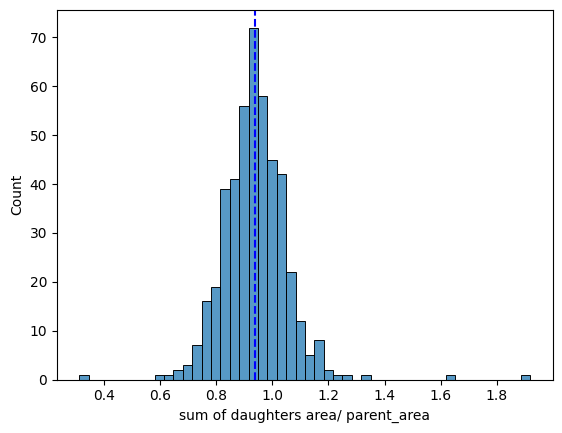

In [455]:
sns.histplot(data=areas_test, x='area_norm')

#plt.axvline(np.mean(areas_p_0.area_norm))
plt.axvline(np.mean(areas_test.area_norm), c='blue', linestyle='--')
plt.xlabel('sum of daughters area/ parent_area')

Text(0.5, 0, 'sum of daughters area/ parent_area')

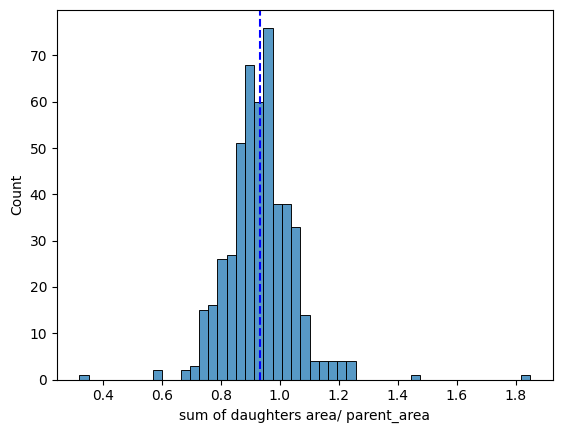

In [436]:
#sns.histplot(data=areas_p_0, x='area_norm', stat='probability')
sns.histplot(data=areas_p_5, x='area_norm')

#plt.axvline(np.mean(areas_p_0.area_norm))
plt.axvline(np.mean(areas_p_5.area_norm), c='blue', linestyle='--')
plt.xlabel('sum of daughters area/ parent_area')


Text(0.5, 0, 'sum of daughters area/ parent_area')

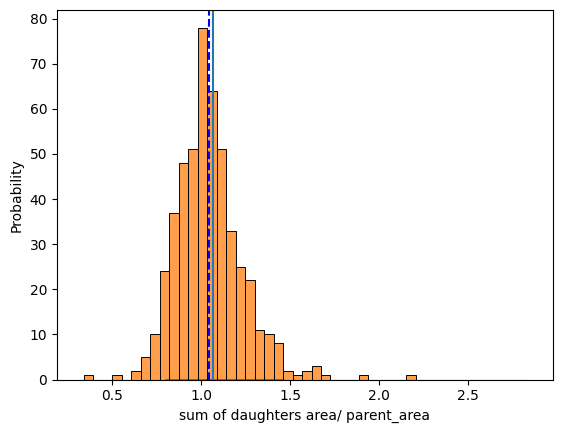

In [437]:
sns.histplot(data=areas_p_0_i, x='area_norm', stat='probability')
sns.histplot(data=areas_p_5_i, x='area_norm')

plt.axvline(np.mean(areas_p_0_i.area_norm))
plt.axvline(np.mean(areas_p_5_i.area_norm), c='blue', linestyle='--')
plt.xlabel('sum of daughters area/ parent_area')


ValueError: Can only compare identically-labeled Series objects

In [59]:
cells_mi=all_cells.set_index(['experiment', 'cell_id_new'])

In [120]:
all_cells[(all_cells.state=='will divide')&(all_cells.stretch_type=='u')&(all_cells.experiment=='uns_20231012_2_IP')]

test=all_cells[(all_cells.state=='will divide')&(all_cells.stretch_type=='f')].groupby(['experiment','cell_id_new']).apply(lambda x: pd.Series(linregress(x['time'], x['angle_horizontal']))).rename(columns={
                        0: 'slope',
                        1: 'intercept',
                        2: 'rvalue',
                        3: 'pvalue',
                        4: 'stderr'
                      })

C:\Users\v35431nc\AppData\Roaming\Python\Python310\site-packages\scipy\stats\_stats_mstats_common.py:182: RuntimeWarning: invalid value encountered in double_scalars
  slope = ssxym / ssxm
C:\Users\v35431nc\AppData\Roaming\Python\Python310\site-packages\scipy\stats\_stats_mstats_common.py:196: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
C:\Users\v35431nc\AppData\Roaming\Python\Python310\site-packages\scipy\stats\_stats_mstats_common.py:199: RuntimeWarning: invalid value encountered in double_scalars
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)


In [121]:
test

slope  intercept    rvalue    pvalue  \
experiment        cell_id_new                                            
ins_20231121_1_IN 3                 NaN        NaN  0.000000       NaN   
                  71          -0.009409   0.681428 -0.161864  0.759325   
                  118               NaN        NaN  0.000000       NaN   
                  132          0.002350   0.323175  0.342629  0.302323   
                  143         -0.004717   0.752983 -0.450124  0.092257   
                  214         -0.000371   0.649522 -0.060944  0.804256   
                  246         -0.007329   0.551088 -0.294803  0.520987   
                  383          0.003292   0.181224  0.514787  0.296030   
                  435         -0.022974   0.726352 -0.279038  0.720962   
                  474               NaN        NaN  0.000000       NaN   
                  498         -0.009338   0.584178 -0.318856  0.441431   
                  586          0.002171   0.295144  0.481868  0.036694   
ins_20231128_1_IP 9           -0.061908   0.338208 -1.000000  0.000000   
                  24           0.003530   0.517588  0.264243  0.460667   
                  95           0.003621   0.029299  0.377884  0.622116   
                  99           0.003186   1.124060  0.104435  0.895565   
                  110         -0.041597   1.001007 -0.816333  0.183667   
                  128               NaN        NaN  0.000000       NaN   
                  130         -0.139846   1.170680 -0.869721  0.328598   
                  131          0.019918   0.109023  0.559256  0.073662   
                  150               NaN        NaN  0.000000       NaN   
                  170         -0.043195   0.846971 -0.643875  0.241021   
                  174          0.006652   1.029202  0.265551  0.429983   
                  213         -0.011548   0.411072 -0.801875  0.009334   
                  234          0.003122   0.048695  0.546172  0.453828   
                  239          0.000723   0.367837  0.120152  0.709930   
                  249          0.002426   0.383180  0.069775  0.895508   
                  251               NaN        NaN  0.000000       NaN   
                  252         -0.117102   0.599411 -1.000000  0.000000   
                  260               NaN        NaN  0.000000       NaN   
                  268         -0.001114   0.419570 -0.106113  0.756165   
                  270         -0.028540   0.663528 -0.593239  0.160309   
                  273         -0.008656   0.299779 -0.837970  0.009384   
                  289         -0.079355   0.996622 -1.000000  0.000000   
                  292         -0.004527   0.743879 -0.206885  0.793115   
                  305         -0.014853   0.265957 -0.805101  0.100214   
ins_20240510_1_IN 31          -0.070527   1.107503 -0.809975  0.190025   
                  40                NaN        NaN  0.000000       NaN   
                  48          -0.028690   0.871208 -0.737181  0.262819   
                  49          -0.017122   0.436932 -0.907670  0.092330   
                  96          -0.064156   0.772014 -0.695503  0.510363   
                  105         -0.041289   0.480642 -0.857831  0.343623   
                  152          0.006768   0.276777  1.000000  0.000000   
                  168          0.012398   0.623092  0.680205  0.043778   
                  174               NaN        NaN  0.000000       NaN   
                  209         -0.015860   0.851378 -0.486359  0.268415   
                  216         -0.002768   0.081635 -0.473173  0.420842   

                                 stderr  
experiment        cell_id_new            
ins_20231121_1_IN 3                 NaN  
                  71           0.028682  
                  118               NaN  
                  132          0.002148  
                  143          0.002595  
                  214          0.001474  
                  246          0.010623  
                  383        

In [111]:
test_dat=all_cells[(all_cells.state=='will divide')&(all_cells.stretch_type=='u')&(all_cells.experiment=='uns_20231012_2_IP')][['cell_id_new', 'time', 'circularity', 'cell_area_microns']].sort_values(['cell_id_new', 'time'])

In [107]:
test

,slope,intercept,rvalue,pvalue,stderr
cell_id_new,,,,,
78,-0.005652,507.518784,-0.005399,0.985387,0.302232
103,0.153284,607.790688,0.208943,0.338673,0.156554
120,3.522928,384.787557,0.823735,0.011945,0.989929
121,1.173999,540.063308,0.734451,0.000342,0.263108
126,0.657548,503.170615,0.249125,0.839714,2.556214
146,1.254143,614.985148,0.698942,0.122311,0.641638
179,-0.220186,673.541538,-0.219861,0.396489,0.252253
209,-1.675183,565.235874,-0.743156,0.055603,0.674528
218,6.102049,519.414495,0.835353,0.038431,2.007762


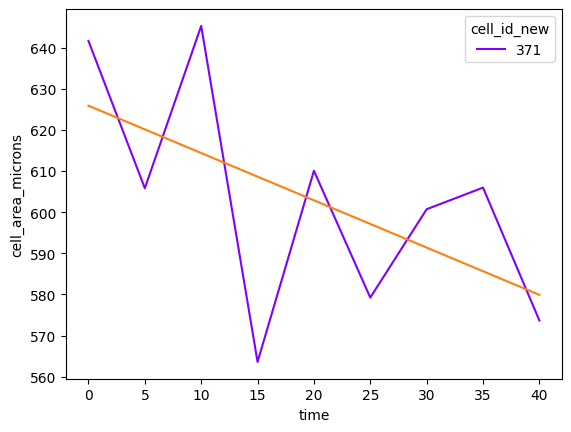

In [112]:
fig, ax = plt.subplots()
i=371
sns.lineplot(test_dat[test_dat.cell_id_new==i], x='time', y='cell_area_microns', hue='cell_id_new', palette='rainbow')
ax.plot(test_dat[test_dat.cell_id_new==i].time, test.loc[i].slope*test_dat[test_dat.cell_id_new==i].time + test.loc[i].intercept)

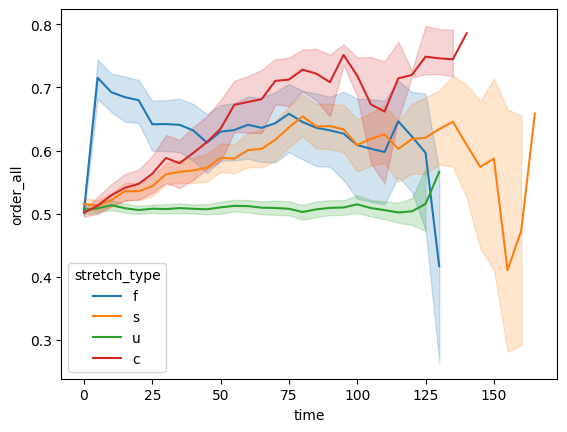

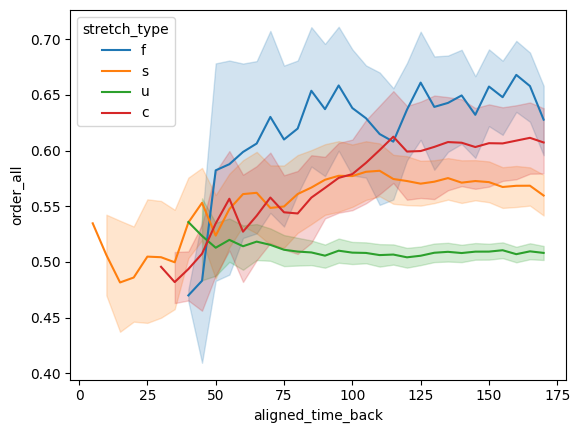

In [193]:
sns.lineplot(all_cells[all_cells.state=='will divide'], x='time', y='order_all',hue='stretch_type' )
plt.show()
sns.lineplot(all_cells[all_cells.state=='will divide'], x='aligned_time_back', y='order_all',hue='stretch_type' )
plt.show()

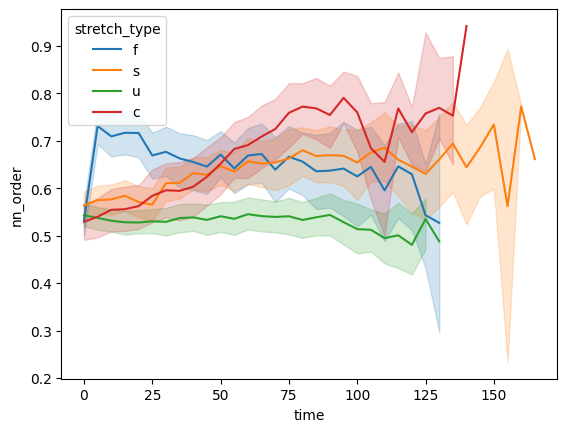

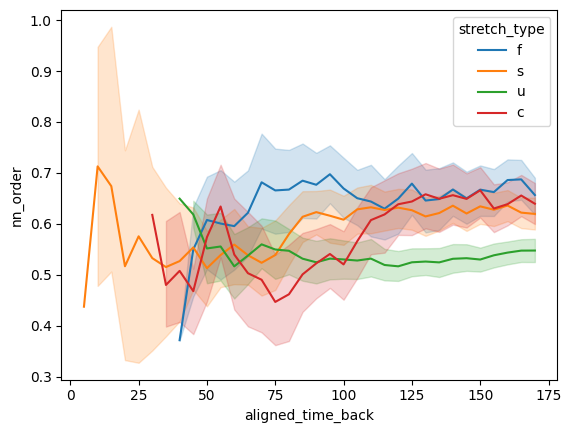

In [194]:
sns.lineplot(all_cells[all_cells.state=='will divide'], x='time', y='nn_order',hue='stretch_type' )
plt.show()
sns.lineplot(all_cells[all_cells.state=='will divide'], x='aligned_time_back', y='nn_order',hue='stretch_type' )
plt.show()

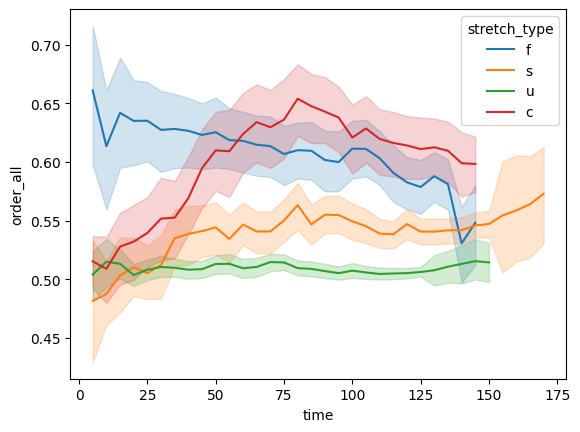

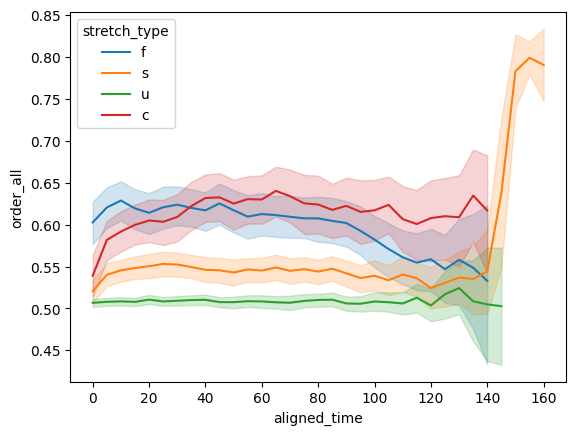

In [195]:
sns.lineplot(all_cells[all_cells.state=='daughter cell'], x='time', y='order_all',hue='stretch_type' )
plt.show()
sns.lineplot(all_cells[all_cells.state=='daughter cell'], x='aligned_time', y='order_all',hue='stretch_type' )
plt.show()

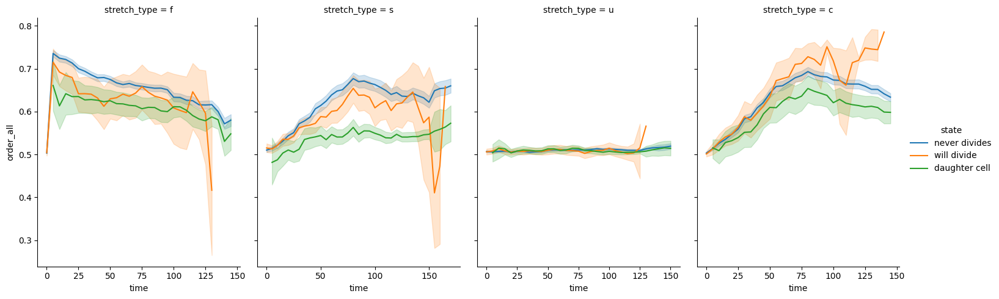

In [196]:
sns.relplot(
    data=all_cells,
    x="time", y="order_all",
    hue="state",col="stretch_type",
    kind="line",
    height=5, aspect=.75, facet_kws=dict(sharex=False),
)

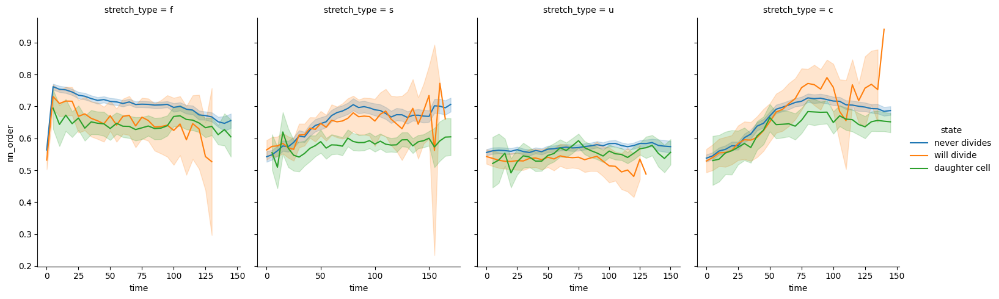

In [197]:
sns.relplot(
    data=all_cells,
    x="time", y="nn_order",
    hue="state",col="stretch_type",
    kind="line",
    height=5, aspect=.75, facet_kws=dict(sharex=False),
)

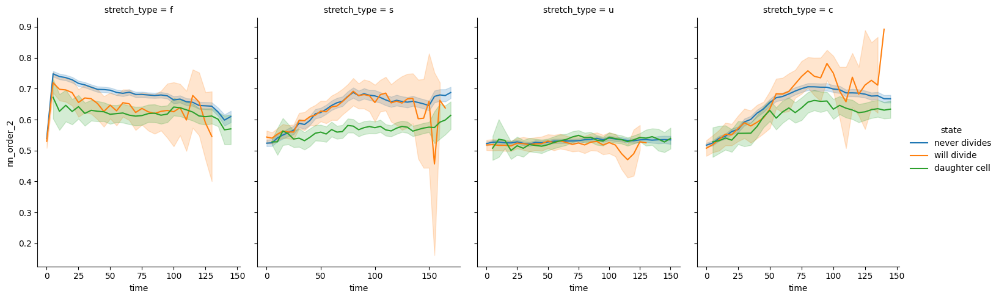

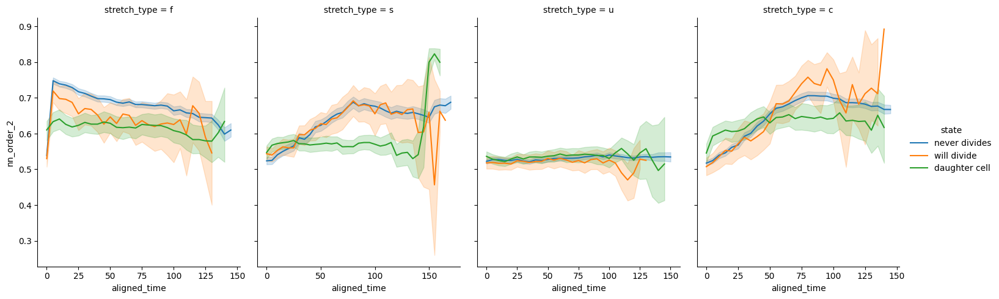

In [198]:
sns.relplot(
    data=all_cells,
    x="time", y="nn_order_2",
    hue="state",col="stretch_type",
    kind="line",
    height=5, aspect=.75, facet_kws=dict(sharex=False),
)

sns.relplot(
    data=all_cells,
    x="aligned_time", y="nn_order_2",
    hue="state",col="stretch_type",
    kind="line",
    height=5, aspect=.75, facet_kws=dict(sharex=False),
)

In [273]:
exp_data=exp_data.reset_index()
exp_data['div_rate']=exp_data.groupby('experiment').cell_count.transform('diff')

<AxesSubplot: xlabel='time', ylabel='div_rate'>

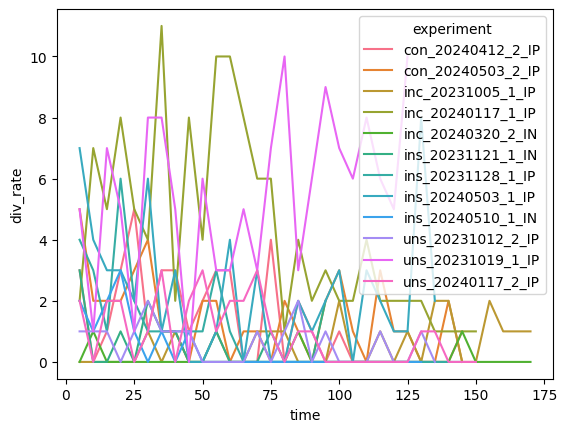

In [275]:
sns.lineplot(exp_data, x='time', y='div_rate', hue='experiment')

experiment
con_20240412_2_IP    AxesSubplot(0.125,0.11;0.775x0.77)
con_20240503_2_IP    AxesSubplot(0.125,0.11;0.775x0.77)
inc_20231005_1_IP    AxesSubplot(0.125,0.11;0.775x0.77)
inc_20240117_1_IP    AxesSubplot(0.125,0.11;0.775x0.77)
inc_20240320_2_IN    AxesSubplot(0.125,0.11;0.775x0.77)
ins_20231121_1_IN    AxesSubplot(0.125,0.11;0.775x0.77)
ins_20231128_1_IP    AxesSubplot(0.125,0.11;0.775x0.77)
ins_20240503_1_IP    AxesSubplot(0.125,0.11;0.775x0.77)
ins_20240510_1_IN    AxesSubplot(0.125,0.11;0.775x0.77)
uns_20231012_2_IP    AxesSubplot(0.125,0.11;0.775x0.77)
uns_20231019_1_IP    AxesSubplot(0.125,0.11;0.775x0.77)
uns_20240117_2_IP    AxesSubplot(0.125,0.11;0.775x0.77)
dtype: object

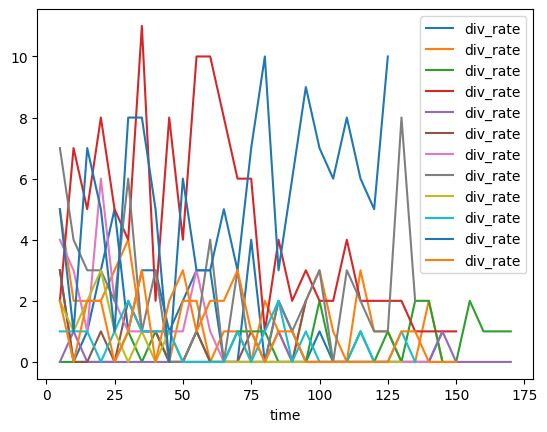

In [274]:
fig, ax=plt.subplots()
exp_data.groupby("experiment").plot(x='time', y='div_rate',kind="line", ax=ax)

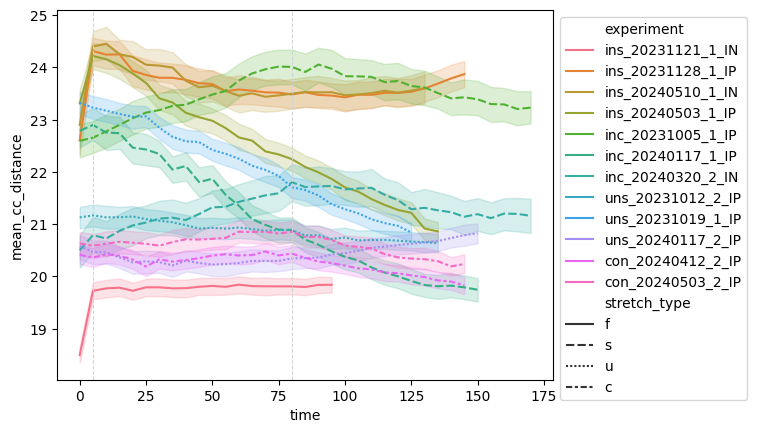

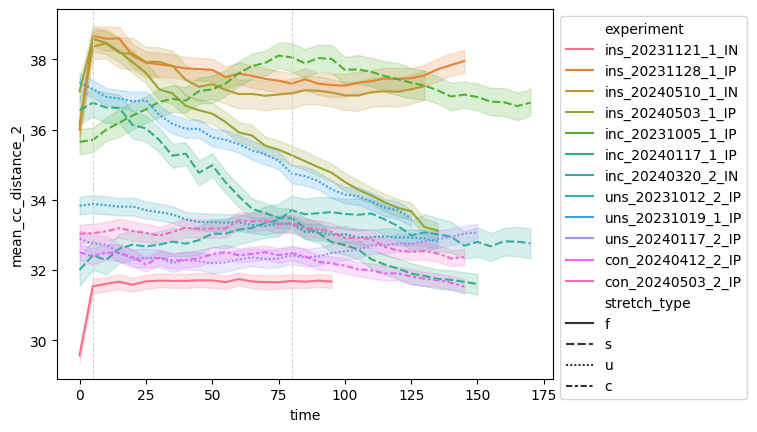

In [314]:
g=sns.lineplot(all_cells, x='time', y='mean_cc_distance', hue='experiment', style='stretch_type')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)
plt.axvline(5, linestyle='--', linewidth=0.75, color='lightgrey')
plt.axvline(80, linestyle='--', linewidth=0.75, color='lightgrey')
plt.show()

g=sns.lineplot(all_cells, x='time', y='mean_cc_distance_2', hue='experiment', style='stretch_type')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)

plt.axvline(5, linestyle='--', linewidth=0.75, color='lightgrey')
plt.axvline(80, linestyle='--', linewidth=0.75, color='lightgrey')
plt.show()

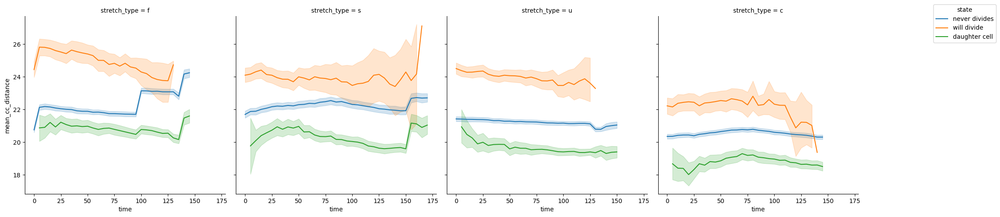

In [318]:
g=sns.relplot(all_cells, x='time', y='mean_cc_distance', hue='state', col='stretch_type', kind='line')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)


In [321]:
exp_data[]

,index,experiment,time,total_area,cell_count,cell_density,mean_area_per_cell,div_rate
0,0,con_20240412_2_IP,0,162341.821624,456,0.002809,356.012767,NaN
1,1,con_20240412_2_IP,5,162360.525222,459,0.002827,353.726634,3.0
2,2,con_20240412_2_IP,10,163430.283338,459,0.002809,356.057262,0.0
3,3,con_20240412_2_IP,15,163003.023028,460,0.002822,354.354398,1.0
4,4,con_20240412_2_IP,20,163119.189904,463,0.002838,352.309265,3.0
...,...,...,...,...,...,...,...,...
346,346,uns_20240117_2_IP,130,148309.593563,405,0.002731,366.196527,1.0
347,347,uns_20240117_2_IP,135,149110.487462,406,0.002723,367.267210,1.0
348,348,uns_20240117_2_IP,140,149854.539959,406,0.002709,369.099852,0.0
349,349,uns_20240117_2_IP,145,150457.292619,406,0.002698,370.584465,0.0


In [328]:
exp_data['x_scale']=0
exp_data['y_scale']=0

In [333]:
exp_data

,index,experiment,time,total_area,cell_count,cell_density,mean_area_per_cell,div_rate,x_scale,y_scale
0,0,con_20240412_2_IP,0,162341.821624,456,0.002809,356.012767,NaN,0.0,0
1,1,con_20240412_2_IP,5,162360.525222,459,0.002827,353.726634,3.0,0.0,0
2,2,con_20240412_2_IP,10,163430.283338,459,0.002809,356.057262,0.0,0.0,0
3,3,con_20240412_2_IP,15,163003.023028,460,0.002822,354.354398,1.0,0.0,0
4,4,con_20240412_2_IP,20,163119.189904,463,0.002838,352.309265,3.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...
346,346,uns_20240117_2_IP,130,148309.593563,405,0.002731,366.196527,1.0,0.0,0
347,347,uns_20240117_2_IP,135,149110.487462,406,0.002723,367.267210,1.0,0.0,0
348,348,uns_20240117_2_IP,140,149854.539959,406,0.002709,369.099852,0.0,0.0,0
349,349,uns_20240117_2_IP,145,150457.292619,406,0.002698,370.584465,0.0,0.0,0


In [332]:
exp_data.loc[exp_data.experiment=='ins_20231128_1_IP', 'x_scale']=np.cumprod(Fx)
exp_data.loc[exp_data.experiment=='ins_20231128_1_IP', 'y_scale']=np.cumprod(Fy)



In [341]:
exp_data.loc[exp_data.experiment=='20240510_1_IN']

,index,experiment,time,total_area,cell_count,cell_density,mean_area_per_cell,div_rate,x_scale,y_scale


In [339]:
len(Fx)

27

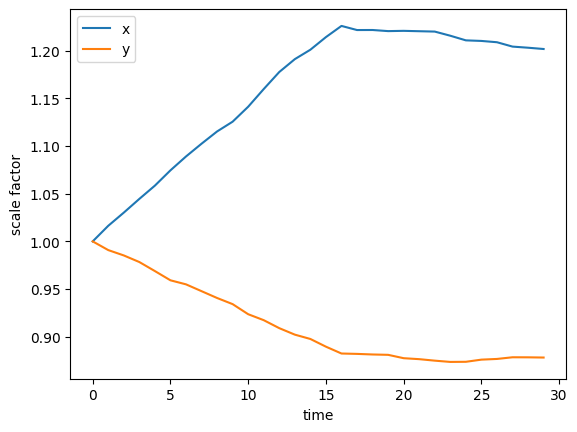

In [350]:
dat_df=con_20240503_2_IP
Fx=[1]
Fy=[1]

for i in range(dat_df.tm_frame.max()):

    cc_i=dat_df[dat_df.tm_frame==i][['cell_id_new','cc_x', 'cc_y', 'tm_frame']]
    cc_f=dat_df[dat_df.tm_frame==i+1][['cell_id_new','cc_x', 'cc_y', 'tm_frame']]
    cc_diff=pd.merge(cc_i, cc_f, on='cell_id_new', suffixes=("_i", "_f"), how='inner')
    cc_diff
    aft=np.array(cv2.estimateAffine2D(cc_diff[['cc_x_i', 'cc_y_i']].values, cc_diff[['cc_x_f', 'cc_y_f']].values, method=cv2.RANSAC)[0][:,:2])
    Fx.append(polar(aft)[1][0,0])
    Fy.append(polar(aft)[1][1,1])

exp_data.loc[exp_data.experiment=='con_20240503_2_IP', 'x_scale']=np.cumprod(Fx)
exp_data.loc[exp_data.experiment=='con_20240503_2_IP', 'y_scale']=np.cumprod(Fy)

plt.plot(np.cumprod(Fx), label='x')
plt.plot(np.cumprod(Fy), label='y')
plt.xlabel('time')
plt.ylabel('scale factor')
plt.legend()
plt.savefig(save_folder+'/Continuous_plots/20240503_2_IP_GFPCAAX-CheHis_uc_8p6/scale_factor_time.png', dpi=300, bbox_inches='tight')


In [356]:
exp_data=exp_data.merge(all_cells[['experiment', 'stretch_type']].drop_duplicates(), on='experiment')

In [375]:
exp_data['total_area_norm']=exp_data.total_area/exp_data.groupby('experiment').total_area.transform('first')

In [403]:
exp_data['cell_count_norm']=exp_data.cell_count/exp_data.groupby('experiment').cell_count.transform('first')

In [425]:
exp_data['cell_count_norm_diff']=exp_data.groupby('experiment').cell_count_norm.transform('diff')
exp_data['total_area_norm_diff']=exp_data.groupby('experiment').total_area_norm.transform('diff')

exp_data['cell_count_diff']=exp_data.groupby('experiment').cell_count.transform('diff')
exp_data['total_area_diff']=exp_data.groupby('experiment').total_area.transform('diff')

In [376]:
exp_data.to_csv(save_folder+"/experiment_level_data.csv",index=False)

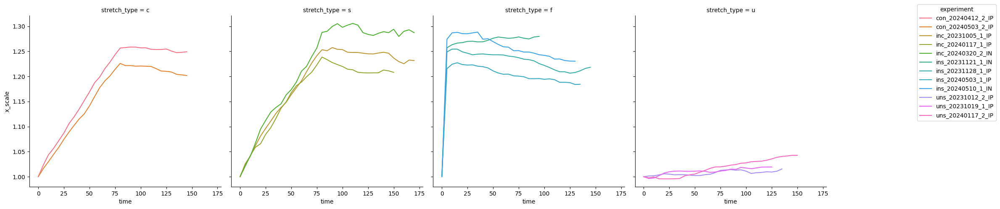

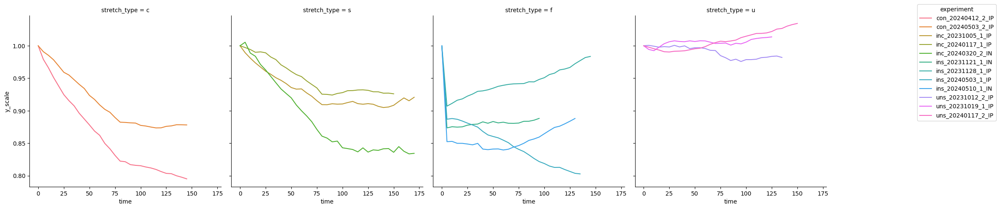

In [360]:
g=sns.relplot(exp_data, x='time', y='x_scale', hue='experiment', col='stretch_type', kind='line')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)
plt.savefig(save_dir+'/x-scale_exp.png', dpi=300, bbox_inches='tight')
plt.show()
g=sns.relplot(exp_data, x='time', y='y_scale', hue='experiment', col='stretch_type', kind='line')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)
plt.savefig(save_dir+'/y-scale_exp.png', dpi=300, bbox_inches='tight')
plt.show()

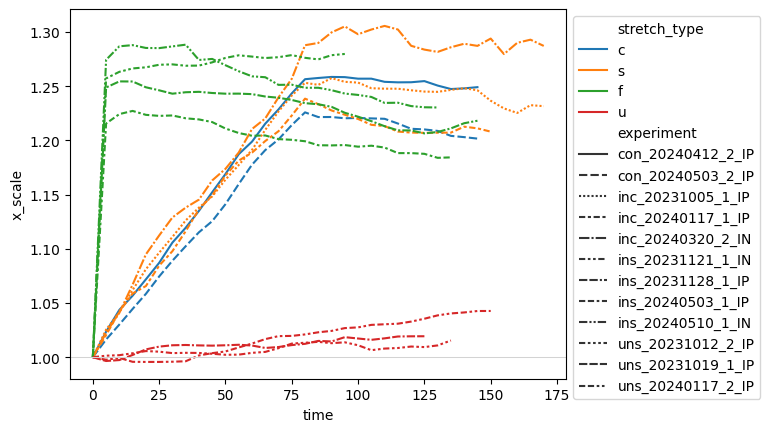

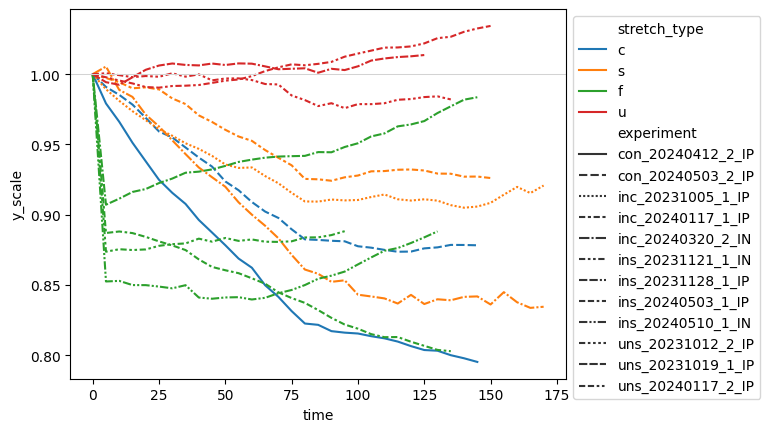

In [384]:
g=sns.lineplot(exp_data, x='time', y='x_scale', hue='stretch_type', style='experiment')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)
plt.axhline(1, linewidth=0.75, color='lightgrey')

plt.show()
g=sns.lineplot(exp_data, x='time', y='y_scale', hue='stretch_type', style='experiment')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)
plt.axhline(1, linewidth=0.75, color='lightgrey')


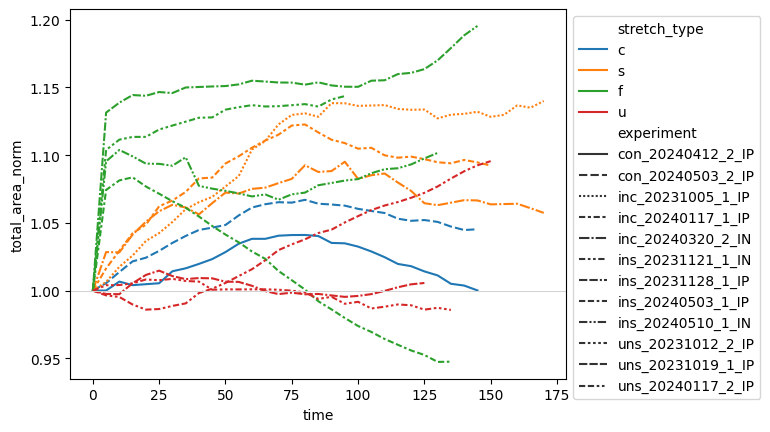

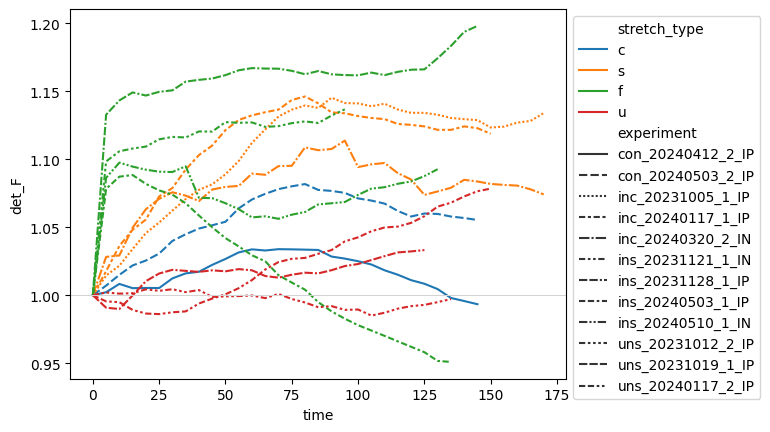

In [386]:
g=sns.lineplot(exp_data, x='time', y='total_area_norm', hue='stretch_type', style='experiment')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)
plt.axhline(1, linewidth=0.75, color='lightgrey')
plt.show()

g=sns.lineplot(exp_data, x='time', y='det_F', hue='stretch_type', style='experiment')

plt.axhline(1, linewidth=0.75, color='lightgrey')
plt.show()

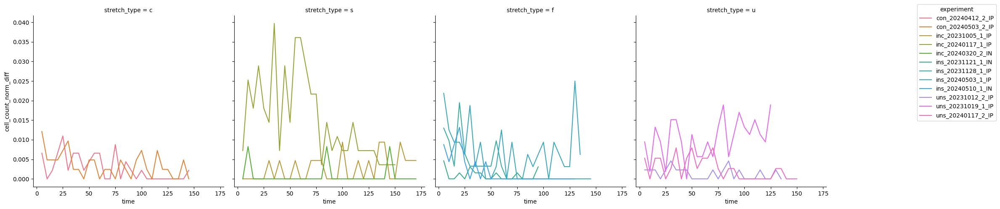

In [413]:
g=sns.relplot(exp_data,x='time', y='cell_count_norm_diff', col='stretch_type', hue='experiment', kind='line')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)

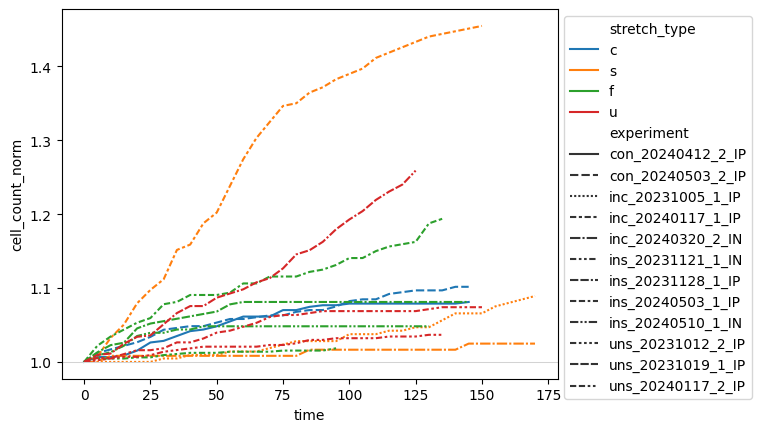

In [588]:
g=sns.lineplot(exp_data, x='time', y='cell_count_norm', hue='stretch_type', style='experiment')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)
plt.axhline(1, linewidth=0.75, color='lightgrey')

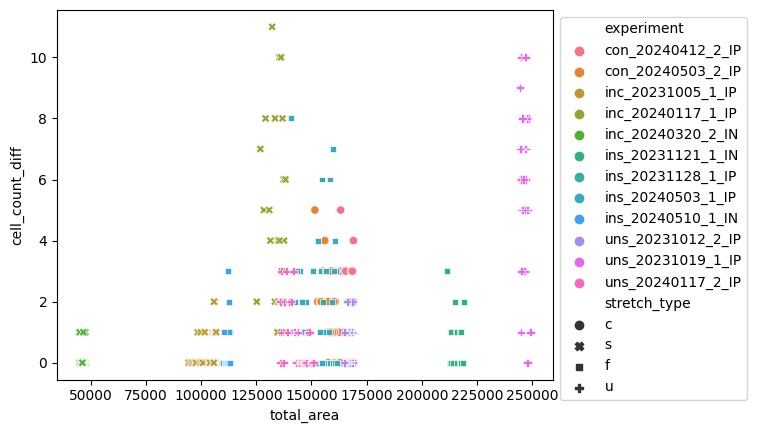

In [428]:
g=sns.scatterplot(exp_data, y='cell_count_diff', x='total_area', style='stretch_type', hue='experiment')
sns.move_legend(g, "upper left", bbox_to_anchor=(1,1), frameon=True)


In [569]:
d_centres=all_cells[all_cells.state=='daughter cell'].groupby(['experiment','parent_id', 'cell_id_new']).first()[['cc_x', 'cc_y', 'stretch_type', 'first_frame']].reset_index()
d_centres

,experiment,parent_id,cell_id_new,cc_x,cc_y,stretch_type,first_frame
0,con_20240412_2_IP,4.0,461,-0.600742,-99.060248,c,5
1,con_20240412_2_IP,4.0,462,17.869612,-102.303822,c,5
2,con_20240412_2_IP,17.0,463,-160.551569,197.202056,c,10
3,con_20240412_2_IP,17.0,464,-176.102706,208.338327,c,10
4,con_20240412_2_IP,19.0,465,-34.128439,-106.806833,c,7
...,...,...,...,...,...,...,...
1012,uns_20240117_2_IP,346.0,429,-28.969824,-181.474133,u,9
1013,uns_20240117_2_IP,350.0,430,10.583762,-189.871386,u,9
1014,uns_20240117_2_IP,350.0,431,2.384727,-174.824805,u,9
1015,uns_20240117_2_IP,376.0,432,-91.831988,208.757494,u,12


In [570]:
d_centres['dx']=d_centres.groupby(['experiment', 'parent_id']).cc_x.transform('diff')
d_centres['dy']=d_centres.groupby(['experiment', 'parent_id']).cc_y.transform('diff')

In [571]:
d_dists=d_centres.groupby(['stretch_type','experiment', 'parent_id', 'first_frame']).sum()[['dx','dy']].reset_index()
d_dists

,stretch_type,experiment,parent_id,first_frame,dx,dy
0,c,con_20240412_2_IP,4.0,5,18.470353,-3.243574
1,c,con_20240412_2_IP,17.0,10,-15.551136,11.136271
2,c,con_20240412_2_IP,19.0,7,-16.344010,-0.846933
3,c,con_20240412_2_IP,29.0,7,10.938053,9.460425
4,c,con_20240412_2_IP,49.0,4,-13.677071,-4.252686
...,...,...,...,...,...,...
504,u,uns_20240117_2_IP,312.0,4,-3.063376,-12.433701
505,u,uns_20240117_2_IP,320.0,10,14.889550,9.035671
506,u,uns_20240117_2_IP,346.0,9,-12.163403,-10.883993
507,u,uns_20240117_2_IP,350.0,9,-8.199035,15.046580


In [572]:
d_dists['dr']=np.sqrt(d_dists.dx**2+d_dists.dy**2)

In [573]:
d_dists['div_angle']=np.arctan2(d_dists.dy/d_dists.dr, d_dists.dx/d_dists.dr)

d_dists['div_angle']=np.where(d_dists.div_angle<0, d_dists.div_angle+np.pi, d_dists.div_angle)

d_dists['div_angle_horizontal']=abs(np.where(d_dists.div_angle<np.pi/2,d_dists.div_angle, d_dists.div_angle-np.pi))

(array([65., 81., 67., 66., 57., 37., 32., 32., 41., 30.]),
 array([0.00337837, 0.15889149, 0.31440461, 0.46991774, 0.62543086,
        0.78094399, 0.93645711, 1.09197024, 1.24748336, 1.40299649,
        1.55850961]),
 <BarContainer object of 10 artists>)

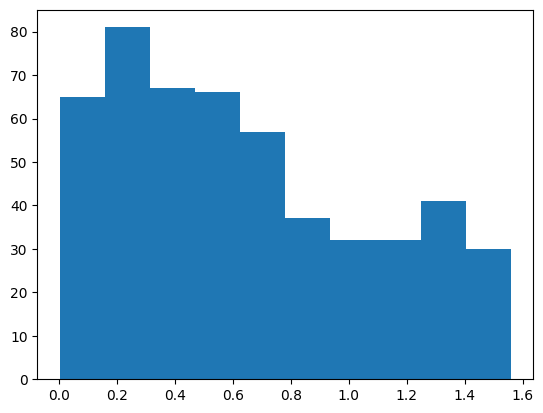

In [574]:
plt.hist(d_dists.div_angle_horizontal)

<AxesSubplot: xlabel='div_angle', ylabel='Probability'>

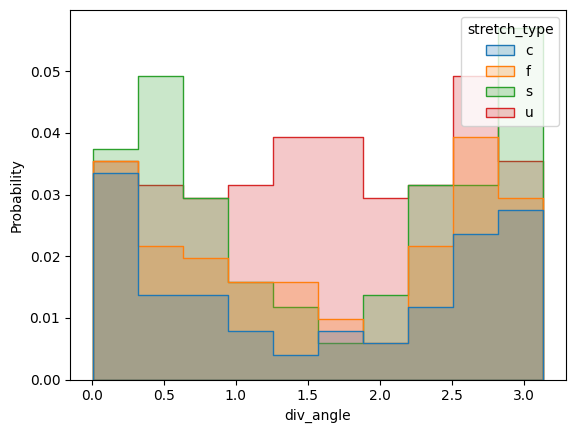

In [575]:
sns.histplot(d_dists,hue='stretch_type',  x='div_angle', stat='probability', element='step')

In [556]:
d_dists.columns

Index(['stretch_type', 'experiment', 'parent_id', 'dx', 'dy', 'dr',
       'div_angle', 'div_angle_shift', 'div_angle_horizontal'],
      dtype='object')

In [558]:
d_dists=d_dists[['stretch_type', 'experiment', 'parent_id', 'dx', 'dy', 'dr',
       'div_angle', 'div_angle_horizontal']]

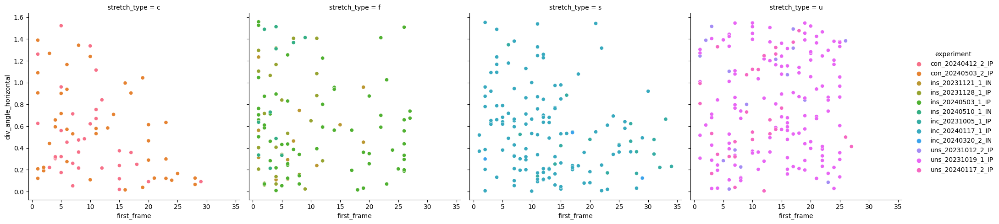

In [607]:
sns.relplot(d_dists, x='first_frame', y='div_angle_horizontal', col='stretch_type', hue='experiment')

<AxesSubplot: xlabel='first_frame', ylabel='div_angle_horizontal'>

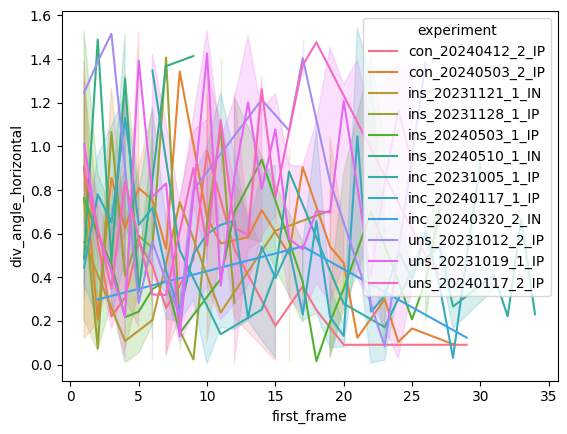

In [640]:
sns.lineplot(d_dists, x='first_frame', y='div_angle_horizontal', hue='experiment', estimator='median')

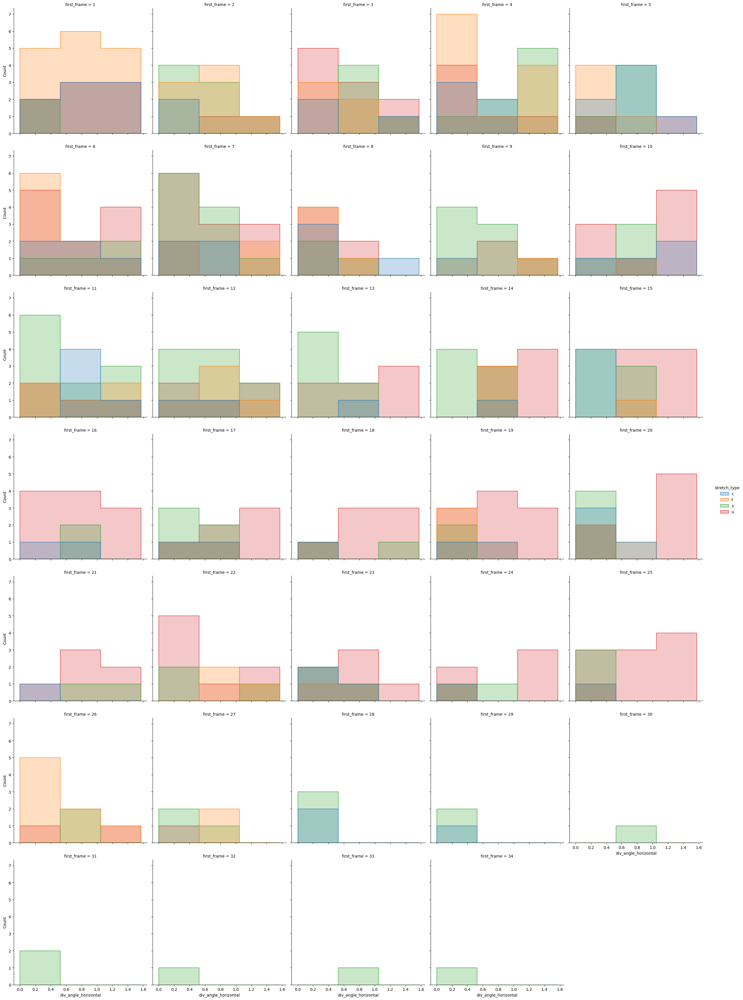

In [612]:
sns.displot(d_dists, col='first_frame', hue='stretch_type', x='div_angle_horizontal', kind='hist', legend=True, element='step', col_wrap=5, binrange=(0, np.pi/2), bins=3)

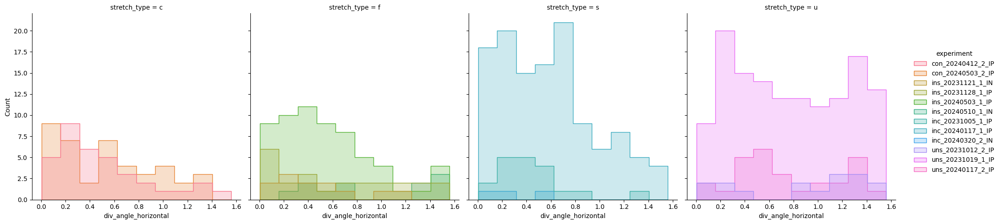

In [589]:
sns.displot(d_dists, col='stretch_type', hue='experiment', x='div_angle_horizontal', kind='hist', legend=True, element='step')

<AxesSubplot: xlabel='div_angle_horizontal', ylabel='Probability'>

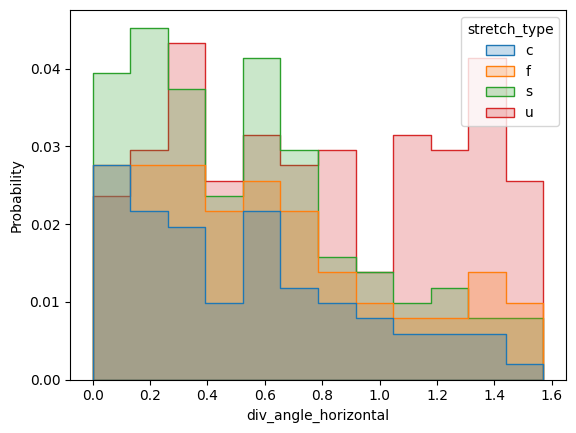

In [567]:
sns.histplot(d_dists, hue='stretch_type', x='div_angle_horizontal', binrange=(0,np.pi/2), bins=12, stat='probability', element='step')

<AxesSubplot: xlabel='angle_horizontal', ylabel='Probability'>

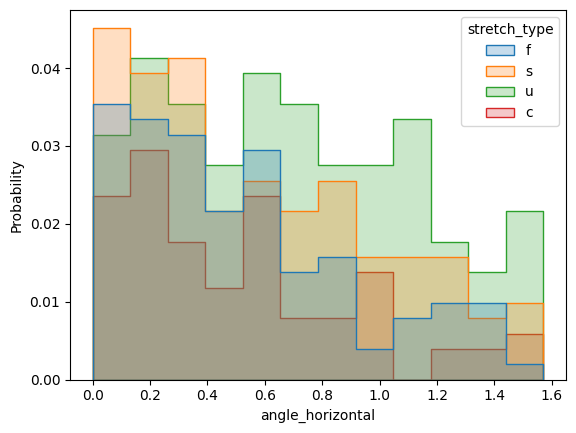

In [568]:
sns.histplot(all_cells[(all_cells.state=='will divide')&(all_cells.aligned_time_back==170)], hue='stretch_type',x='angle_horizontal',  binrange=(0,np.pi/2), bins=12, stat='probability', element='step')

In [576]:
d_dists.to_csv(save_folder+"/division_angles.csv",index=False)

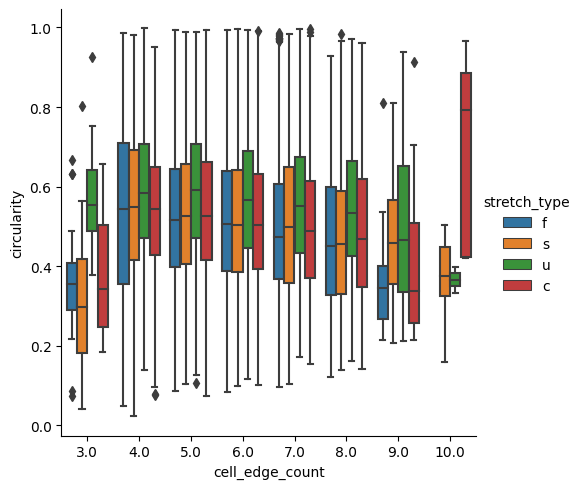

In [592]:
sns.catplot(all_cells,kind='box', x='cell_edge_count', y='circularity', hue='stretch_type')

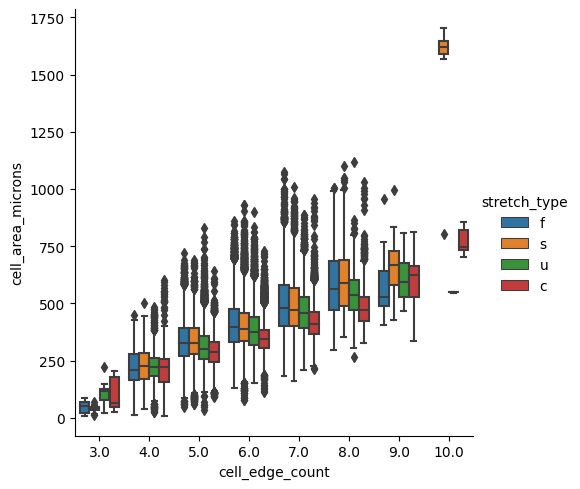

In [593]:
sns.catplot(all_cells,kind='box', x='cell_edge_count', y='cell_area_microns', hue='stretch_type')

In [606]:
all_cells.columns

Index(['index', 'cell_id_old', 'cell_perimeter_microns', 'cell_area_microns',
       'shape_parameter', 'circularity', 'cell_edge_count',
       'major_shape_axis_alignment_rads', 'cc_x', 'cc_y', 'cell_id_new',
       'spot_id', 'time', 'tm_frame', 'cell_perimeter_nd', 'cell_area_nd',
       'cell_P_eff_nd', 'cell_shear', 'cell_zeta',
       'major_stress_axis_alignment_rads', 'parent_id', 'divisions',
       'angle_horizontal', 'circ_J', 'circ_P', 'circ_A', 'shape_axis_J',
       'shape_axis_P', 'shape_axis_A', 'nn_order', 'nn_order_2', 'order_all',
       'mean_cc_distance', 'mean_cc_distance_2', 'experiment', 'stretch_type',
       'state', 'area_norm', 'first_frame', 'last_frame', 'perimeter_norm',
       'area_norm_mean', 'area_norm_last', 'circ_norm', 'circ_norm_last',
       'aligned_time', 'aligned_time_back', 'area_norm_fs'],
      dtype='object')

In [ ]:
sns.catplot(all_cells,kind='box', x='cell_edge_count', y='cell_area_microns', hue='stretch_type')

<AxesSubplot: xlabel='time', ylabel='cell_area_microns'>

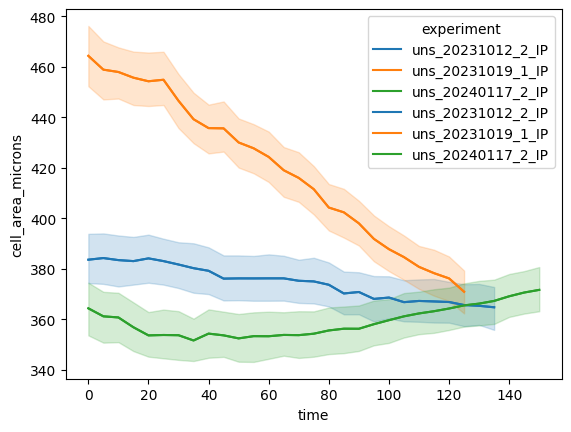

In [600]:
sns.lineplot(all_cells[all_cells.stretch_type=='u'], x='time', y='cell_area_microns', hue='experiment')


<AxesSubplot: xlabel='time', ylabel='mean_area_per_cell'>

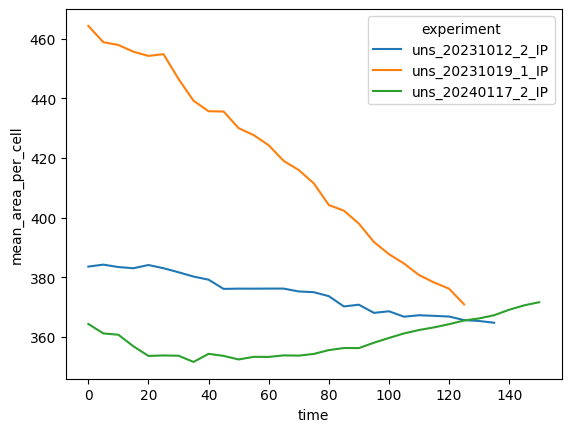

In [601]:
sns.lineplot(exp_data[exp_data.stretch_type=='u'], x='time', y='mean_area_per_cell', hue='experiment')

In [605]:
np.sqrt((exp_data.total_area/exp_data.cell_count)/(3*np.sqrt(3)/2))

0      11.705955
1      11.668309
2      11.706686
3      11.678659
4      11.644909
         ...    
346    11.872199
347    11.889542
348    11.919169
349    11.943116
350    11.960039
Length: 351, dtype: float64

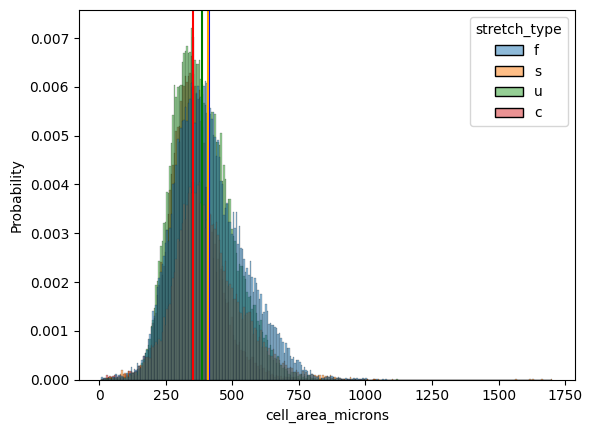

In [626]:
sns.histplot(all_cells, hue='stretch_type', x='cell_area_microns', stat='probability')
plt.axvline(all_cells[all_cells.stretch_type=='f'].cell_area_microns.mean(), c='blue')
plt.axvline(all_cells[all_cells.stretch_type=='s'].cell_area_microns.mean(), c='orange')
plt.axvline(all_cells[all_cells.stretch_type=='u'].cell_area_microns.mean(), c='green')
plt.axvline(all_cells[all_cells.stretch_type=='c'].cell_area_microns.mean(), c='red')

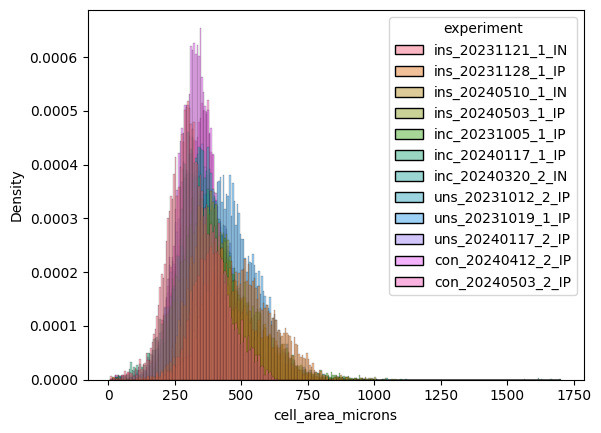

In [631]:
sns.histplot(all_cells, hue='experiment', x='cell_area_microns', stat='density')
print()

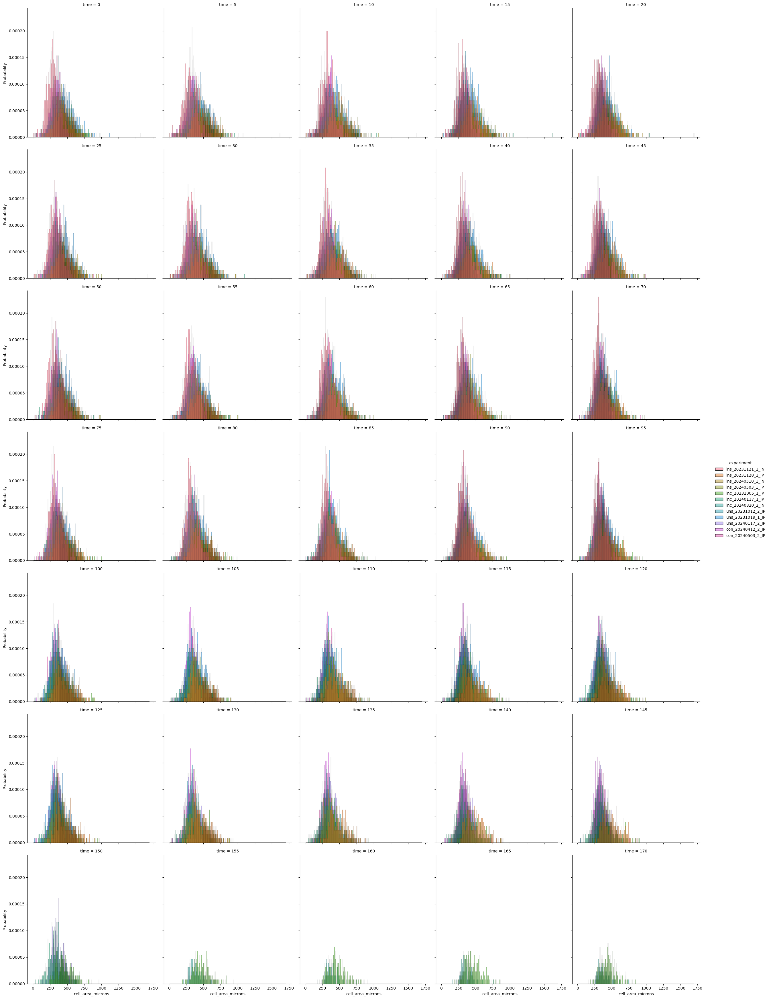

In [632]:
sns.displot(all_cells,col='time', hue='experiment', x='cell_area_microns', stat='probability', col_wrap=5)


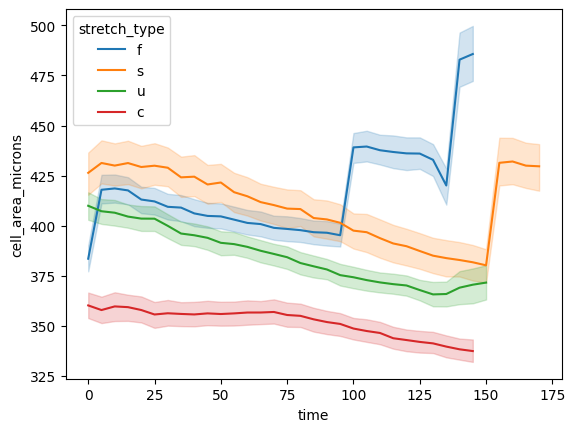

<AxesSubplot: xlabel='time', ylabel='cell_area_microns'>

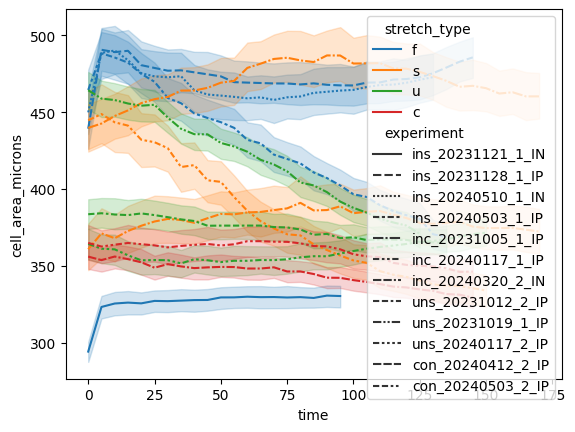

In [636]:
sns.lineplot(all_cells, hue='stretch_type', x='time', y='cell_area_microns')
plt.show()
sns.lineplot(all_cells, hue='stretch_type',style='experiment', x='time', y='cell_area_microns')

<AxesSubplot: xlabel='cell_area_microns', ylabel='Density'>

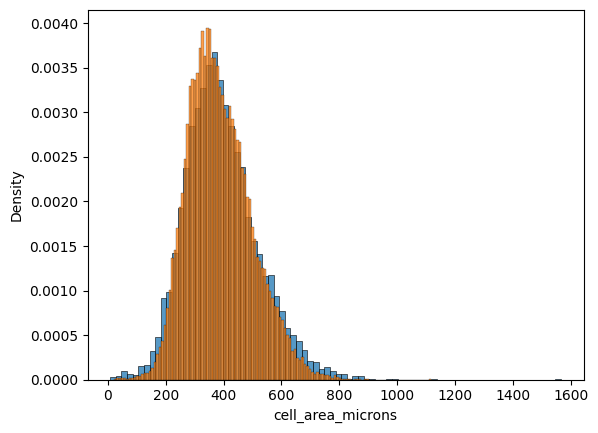

In [644]:
sns.histplot(all_cells[all_cells.time==0], x='cell_area_microns',stat='density')
sns.histplot(all_cells[all_cells.stretch_type=='u'], x='cell_area_microns', stat='density')

<AxesSubplot: xlabel='cell_area_microns', ylabel='Density'>

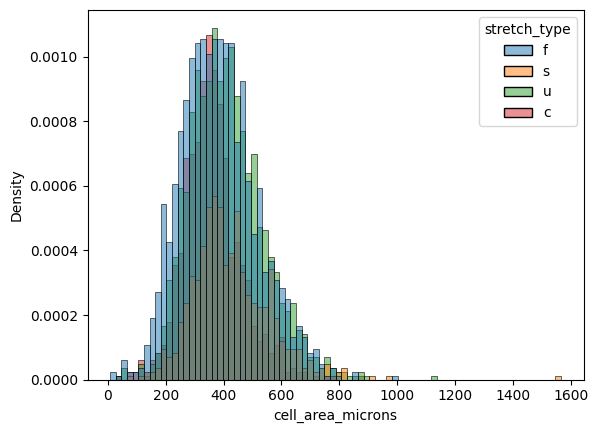

In [646]:
sns.histplot(all_cells[all_cells.time==0], x='cell_area_microns',hue='stretch_type',stat='density')

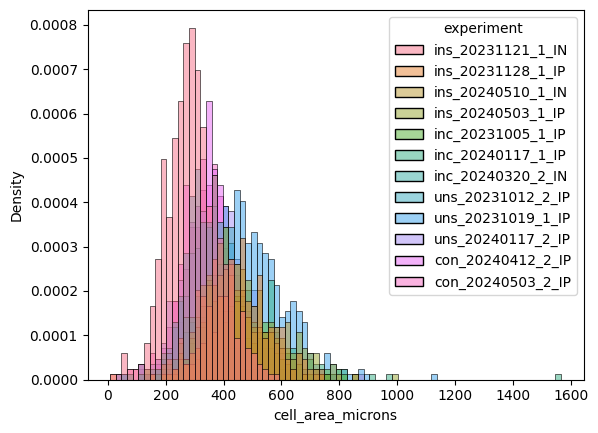

<AxesSubplot: xlabel='experiment', ylabel='cell_area_microns'>

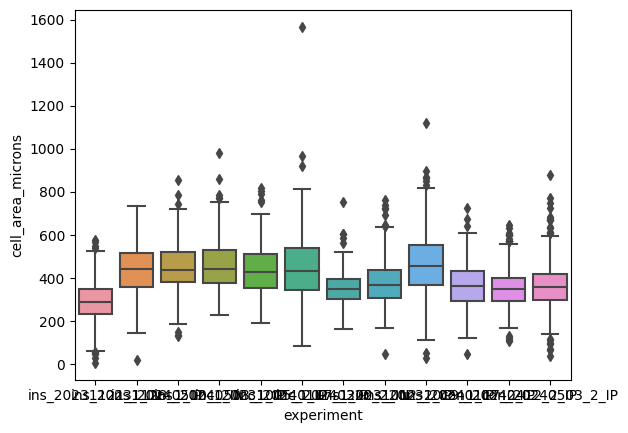

In [688]:
sns.histplot(all_cells[all_cells.time==0], x='cell_area_microns',hue='experiment',stat='density')
plt.show()

sns.boxplot(all_cells[all_cells.time==0], x='experiment', y='cell_area_microns')

In [658]:
area_exp=all_cells[all_cells.time==0][['stretch_type','experiment', 'cell_id_new', 'cell_area_microns']].pivot(columns='experiment', values='cell_area_microns')

In [674]:
ins_a=all_cells[(all_cells.time==0)&(all_cells.experiment=='ins_20231121_1_IN')].cell_area_microns
ins_b=all_cells[(all_cells.time==0)&(all_cells.experiment=='ins_20231128_1_IP')].cell_area_microns
ins_c=all_cells[(all_cells.time==0)&(all_cells.experiment=='ins_20240510_1_IN')].cell_area_microns
ins_d=all_cells[(all_cells.time==0)&(all_cells.experiment=='ins_20240503_1_IP')].cell_area_microns
inc_a=all_cells[(all_cells.time==0)&(all_cells.experiment=='inc_20231005_1_IP')].cell_area_microns
inc_b=all_cells[(all_cells.time==0)&(all_cells.experiment=='inc_20240117_1_IP')].cell_area_microns
inc_c=all_cells[(all_cells.time==0)&(all_cells.experiment=='inc_20240320_2_IN')].cell_area_microns
uns_a=all_cells[(all_cells.time==0)&(all_cells.experiment=='uns_20231012_2_IP')].cell_area_microns
uns_b=all_cells[(all_cells.time==0)&(all_cells.experiment=='uns_20231019_1_IP')].cell_area_microns
uns_c=all_cells[(all_cells.time==0)&(all_cells.experiment=='uns_20240117_2_IP')].cell_area_microns
con_a=all_cells[(all_cells.time==0)&(all_cells.experiment=='con_20240412_2_IP')].cell_area_microns
con_b=all_cells[(all_cells.time==0)&(all_cells.experiment=='con_20240503_2_IP')].cell_area_microns

In [680]:
f_oneway(ins_a, ins_b, ins_c, ins_d, inc_a, inc_b, inc_c, uns_a, uns_b, uns_c, con_a, con_b,axis=0)

F_onewayResult(statistic=102.78217357526913, pvalue=1.423087451304088e-208)